<a href="https://colab.research.google.com/github/weswest/MSDS453/blob/main/MSDS453_A2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Wes Notes to begin:

## For clustering:

The goal is to create clusters, it’s not to be “smart” about the clusters.  So therefore, the intuition of clustering is what the cluster outputs tell us.

What becomes interesting is which documents get shoved into which clusters.  Can I figure out how to take the output of clusters and create, like, a stacked-bar chart that shows the percentage in clusters a, b, and c for each movie?  Repeat the analysis for pos / neg, and category?

Experiments:
* TFIDF vs Doc2Vec.  This seems less critical, but may be fun
* Number of clusters.  Trial and error, but maybe something like 2 / 4 / 8 / 16
* Word cleaning approaches.  Let’s just aim for two: baseline and improved.

Todos:
* Figure out how to build the graph once we have all of the outputs to produce those bar graphs


## For Sentiment Analysis

Here we get into modeling.  So what's interesting is whether the model does well or not.  Code provided by TA has a lot of useful resources for producing models and model performance specs.

So then what about doing model performance on categories of data?  Is the model better at predicting sentiment for genres or titles of movies?

Experiments:
* Models: SVM, Logistic, Naive Bayes, Random Forest.  For each of these there can be some permutes for best-performing model.  Ensemble?
* TFIDF / Doc2Vec
* Word cleaning approaches.

## For Multi-Class Analysis

Pretty much the same as sentiment, right?  The only difference is the outcome variable is 0-3 vs 0v1

## For Topic Modeling

Here we use the LSA and LDA code provided to identify the terms that drive model performance.

# Cleanup Issues to Track

* Discovered the following weird characters:
  * òspecialó
  * òyouõr

# 0. Imports and Setup

## 0.1 Instructor-Provided Imports

In [137]:

import pandas as pd
import os
import numpy as np
import re
import string
import seaborn as sns
import matplotlib.pyplot as plt
import nltk
import random
from dataclasses import dataclass

from nltk.corpus import stopwords
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.stem import PorterStemmer

import gensim
from gensim import corpora, similarities
from gensim.models import Word2Vec, LdaMulticore, TfidfModel, CoherenceModel
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from gensim.models import LsiModel,LdaModel

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import confusion_matrix
from sklearn.manifold import TSNE, MDS
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import train_test_split, KFold
from sklearn.naive_bayes import MultinomialNB

import scipy.cluster.hierarchy

from IPython.display import display, HTML

from typing import List, Callable, Dict

In [2]:
#import pkg_resources
#pkg_resources.require("gensim<=3.8.3");

print("Genism Version: ", gensim.__version__)

Genism Version:  4.3.1


In [3]:
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

## 0.2 Wes-Provided Imports

In [4]:
import random

random_seed = 453
random.seed(random_seed)
np.random.seed(random_seed)
#tf.random.set_seed(random_seed)

from matplotlib.ticker import MaxNLocator

from collections import Counter

import csv
import pickle
folder = 'train'

In [5]:
plt.rcParams['figure.dpi'] = 200
plt.rcParams['savefig.dpi'] = 200

## 0.3 Mount GDrive

In [6]:
from google.colab import drive
drive.mount('/content/drive')
try:
  os.chdir("drive/My Drive/MSDS/453/A2")
except:
  pass

Mounted at /content/drive


In [7]:
nltk.download('stopwords',quiet=True)
nltk.download('wordnet',quiet=True)
nltk.download('punkt',quiet=True)
nltk.download('omw-1.4',quiet=True)

True

## 0.4 TA-Provided Functions

### 0.4.1 TA-Provided Data Functions

In [8]:
def add_movie_descriptor(data: pd.DataFrame, corpus_df: pd.DataFrame):
    """
    Adds "Movie Description" to the supplied dataframe, in the form {Genre}_{P|N}_{Movie Title}_{DocID}
    """
    review = np.where(corpus_df['Review Type (pos or neg)'] == 'Positive', 'P', 'N')
    data['Descriptor'] = corpus_df['Genre of Movie'] + '_' + corpus_df['Movie Title'] + '_' + review + '_' + corpus_df['Doc_ID'].astype(str)

def get_corpus_df(path):
    data = pd.read_csv(path, encoding="utf-8")
    add_movie_descriptor(data, data)
    sorted_data = data.sort_values(['Descriptor'])
    indexed_data = sorted_data.set_index(['Doc_ID'])
    indexed_data['Doc_ID'] = indexed_data.index
    return indexed_data

@dataclass
class Document:
    doc_id: str
    text: str

def normalize_document(document: Document) -> Document:
    text = document.text
    text = remove_punctuation(text)
    text = lower_case(text)
    text = remove_tags(text)
    text = remove_special_chars_and_digits(text)
    
    return Document(document.doc_id, text)

def normalize_documents(documents: List[Document]) -> List[Document]:
    """
    Normalizes text for all given documents.
    Removes punctuation, converts to lower case, removes tags and special characters.
    """
    return [normalize_document(x) for x in documents]

@dataclass
class TokenizedDocument:
    doc_id: str
    tokens: List[str]

def tokenize_document(document: Document) -> TokenizedDocument:
    tokens = nltk.word_tokenize(document.text)
    return TokenizedDocument(document.doc_id, tokens)

def tokenize_documents(documents: List[Document]) -> List[TokenizedDocument]:
    return [tokenize_document(x) for x in documents]

def lemmatize(documents: List[TokenizedDocument]) -> List[TokenizedDocument]:
    result = []
    lemmatizer = WordNetLemmatizer()
    for document in documents:
        output_tokens = [lemmatizer.lemmatize(w) for w in document.tokens]
        result.append(TokenizedDocument(document.doc_id, output_tokens))
        
    return result

def stem(documents: List[TokenizedDocument]) -> List[TokenizedDocument]:
    result = []
    stemmer = PorterStemmer()
    for document in documents:
        output_tokens = [stemmer.stem(w) for w in document.tokens]
        result.append(TokenizedDocument(document.doc_id, output_tokens))

    return result

def remove_stop_words(documents: List[TokenizedDocument]) -> List[TokenizedDocument]:
    result = []
    
    stop_words = set(nltk.corpus.stopwords.words('english')) 
    for document in documents:
        filtered_tokens = [w for w in document.tokens if not w in stop_words]
        result.append(TokenizedDocument(document.doc_id, filtered_tokens))
        
    return result
    
def add_flags(data: pd.DataFrame, casino_royale_doc_ids: List[int], action_doc_ids: List[int]):
    data['is_casino_royale'] = data.index.isin(casino_royale_doc_ids)
    data['is_action'] = data.index.isin(action_doc_ids)
    
def get_all_tokens(documents: List[TokenizedDocument]) -> List[str]:
    tokens = {y for x in documents for y in x.tokens}
    return sorted(list(tokens))

def adjust_string(input_string):
    if "ê" in input_string:
        input_string = input_string.replace("ê", " ")
        print(input_string)
    if "õ" in input_string:
        input_string = input_string.replace("õ", "'")
    if "ó" in input_string:
        input_string = input_string.replace("ó", " ")
    if "ò" in input_string:
        input_string = input_string.replace("ò", " ")
    if "é" in input_string:
        input_string = input_string.replace("é", "e")
    if "ñ" in input_string:
        input_string = input_string.replace("ñ", " ")
    if "ä" in input_string:
        input_string = input_string.replace("ä", "a")
    if "ï" in input_string:
        input_string = input_string.replace("ï", "i")
    if "ü" in input_string:
        input_string = input_string.replace("ü", "u")
    if "ö" in input_string:
        input_string = input_string.replace("ö", "o")
    if "è" in input_string:
        input_string = input_string.replace("è", "e")
    if "ç" in input_string:
        input_string = input_string.replace("ç", "c")
    if "ń" in input_string:
        input_string = input_string.replace("ń", "n")
    return input_string

def clean_doc(doc, custom_stop_words = [], clean_method = 0): 

  # clear out erroneous characters
  doc = adjust_string(doc)
  #split document into individual words
  tokens=doc.split()

  if clean_method < 1:
    print('ERROR.  No method selected')

  if clean_method >= 1:
    re_punc = re.compile('[%s]' % re.escape(string.punctuation))
    # remove punctuation from each word
    tokens = [re_punc.sub('', w) for w in tokens]
    # remove remaining tokens that are not alphabetic
    tokens = [word for word in tokens if word.isalpha()]
    # filter out short tokens
    tokens = [word for word in tokens if len(word) > 4]
    #lowercase all words
    tokens = [word.lower() for word in tokens]
    # filter out stop words
    stop_words = set(stopwords.words('english'))
    tokens = [w for w in tokens if not w in stop_words]         

  if clean_method >= 3:
    print(custom_stop_words)
    # Strip out Custom Stop Words
    tokens = [w for w in tokens if not w in custom_stop_words]

  if clean_method >= 2:
    # word lemmatizing
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]

    # word stemming    
    ps=PorterStemmer()
    tokens=[ps.stem(word) for word in tokens]

  return tokens

def final_processed_text_disabled(doc):
    #this is a function to join the processed text back
    ' '.join(doc)
    return doc

def tfidf(corpus, titles, ngram_range = (1,1)):
    #this is a function to created the tfidf matrix
    Tfidf=TfidfVectorizer(ngram_range=(1,1))

    #fit the vectorizer using final processed documents.  The vectorizer requires the 
    #stiched back together document.

    TFIDF_matrix=Tfidf.fit_transform(corpus)     

    #creating datafram from TFIDF Matrix

    # https://stackoverflow.com/questions/70215049/attributeerror-tfidfvectorizer-object-has-no-attribute-get-feature-names-out
    #words = Tfidf.get_feature_names() # For sklearn <= 0.24.x
    #matrix=pd.DataFrame(TFIDF_matrix.toarray(), columns=Tfidf.get_feature_names(), index=titles)

    words = Tfidf.get_feature_names_out() # For sklearn >= 1.0.x
    matrix=pd.DataFrame(TFIDF_matrix.toarray(), columns=Tfidf.get_feature_names_out(), index=titles)
    return matrix #,words

def One_Hot(variable):
    #this is a function to one hot encode the classes
    LE=LabelEncoder()
    LE.fit(variable)
    Label1=LE.transform(variable)
    OHE=OneHotEncoder()
    labels=OHE.fit_transform(Label1.reshape(-1,1)).toarray()
    return labels

### 0.4.2 LSA, LDA, Word2Vec Matrix Functions

In [9]:
def create_gensim_lsa_model(doc_clean,number_of_topics,words):

    # Creating the term dictionary of our courpus, where every unique term is assigned an index. dictionary = corpora.Dictionary(doc_clean)
    dictionary = corpora.Dictionary(doc_clean)
    # Converting list of documents (corpus) into Document Term Matrix using dictionary prepared above.
    doc_term_matrix = [dictionary.doc2bow(doc) for doc in doc_clean]
    # generate LSA model
    # train model
    lsamodel = LsiModel(doc_term_matrix
                        ,num_topics=number_of_topics
                        ,id2word = dictionary
                        ,power_iters=100)
    print(lsamodel.print_topics(num_topics=number_of_topics, num_words=words))
    index = similarities.MatrixSimilarity(lsamodel[doc_term_matrix])

    return lsamodel,dictionary,index

def lsa(tfidf_matrix, terms, n_components = 10):
    #this is a function to execute lsa.  inputs to the function include the tfidf matrix and
    #the desired number of components.
    
    LSA = TruncatedSVD(n_components=10)
    LSA.fit(tfidf_matrix)

    for i, comp in enumerate(LSA.components_):
        terms_comp = zip(terms, comp)
        sorted_terms = sorted(terms_comp, key= lambda x:x[1], reverse=True)[:7]
        print("Topic "+str(i)+": ")
        for t in sorted_terms:
            print(t[0])
            
def create_gensim_lda_model(doc_clean,number_of_topics,words):

    # Creating the term dictionary of our courpus, where every unique term is assigned an index. dictionary = corpora.Dictionary(doc_clean)
    dictionary = corpora.Dictionary(doc_clean)
    # Converting list of documents (corpus) into Document Term Matrix using dictionary prepared above.
    doc_term_matrix = [dictionary.doc2bow(doc) for doc in doc_clean]
    # generate LDA model
    ldamodel = LdaModel(doc_term_matrix
                        ,num_topics=number_of_topics
                        ,id2word = dictionary
                        ,alpha='auto'
                        ,eta='auto'
                        ,iterations=100
                        ,random_state=23
                        ,passes=20)
    # train model
    print(ldamodel.print_topics(num_topics=number_of_topics, num_words=words))
    index = similarities.MatrixSimilarity(ldamodel[doc_term_matrix])
    return ldamodel,dictionary,index,doc_term_matrix

def lda(tfidf_matrix, terms, topics = 3, num_words = 10):
    #this is a function to perform lda on the tfidf matrix.  function varibales include:
    #tfidf matrix, desired number of topic, and number of words per topic.

    topics = 3
    num_words = 10
    lda = LatentDirichletAllocation(n_components=topics).fit(tfidf_matrix)

    topic_dict = {}
    for topic_num, topic in enumerate(lda.components_):
        topic_dict[topic_num] = " ".join([terms[i]for i in topic.argsort()[:-num_words - 1:-1]])

    print(topic_dict)
    
def word2vec(processed_text, size = 100):
    #This is a function to generate the word2vec matrix. Input parameters include the 
    #tokenized text and matrix size
    
    #word to vec
    model_w2v = Word2Vec(processed_text, size=100, window=5, min_count=1, workers=4)

    #join all processed DSI words into single list
    processed_text_w2v=[]
    for i in processed_text:
        for k in i:
            processed_text_w2v.append(k)

    #obtian all the unique words from DSI
    w2v_words=list(set(processed_text_w2v))

    #can also use the get_feature_names() from TFIDF to get the list of words
    #w2v_words=Tfidf.get_feature_names()

    #empty dictionary to store words with vectors
    w2v_vectors={}

    #for loop to obtain weights for each word
    for i in w2v_words:
        temp_vec=model_w2v.wv[i]
        w2v_vectors[i]=temp_vec

    #create a final dataframe to view word vectors
    w2v_df=pd.DataFrame(w2v_vectors).transpose()
    print(w2v_df)
    return w2v_df

### 0.4.3 Modeling Functions

In [10]:
def k_means(processed_text, titles, tfidf_matrix, k=3):
    
    #this is a function to generate the k-means output using the tfidf matrix.  Inputs 
    #to the function include: titles of text, processed text, and desired k value. 
    #Returns dataframe indicating cluster number per document

    km = KMeans(n_clusters=k, random_state =89)
    km.fit(tfidf_matrix)
    clusters = km.labels_.tolist()

    Dictionary={'Doc Name':titles, 'Cluster':clusters,  'Text': processed_text}
    frame=pd.DataFrame(Dictionary, columns=['Cluster', 'Doc Name','Text'])
    #dictionary to store clusters and respective titles
    cluster_title={}

    #note doc2vec clusters will not have individual words due to the vector representation
    #is based on the entire document not indvidual words. As a result, there won't be individual
    #word outputs from each cluster.   
    for i in range(k):
        temp=frame[frame['Cluster']==i]
        temp_title_list=[]
        for title in temp['Doc Name']:
            temp_title_list.append(title)
        cluster_title[i]=temp_title_list

    return cluster_title,clusters,frame,km

def classifiers(x, y, model_type, cv = 3):
    
    #this function is to fit 3 different model scenarios.  Support vector machines, logistic regressions, naive bayes.
    #svm = Support vector machin
    #logistic = Logistic regression
    #naive_bayes = Naive Bayes Multinomial
    
    #can define cv value for cross validation.
    
    #function returns the train test split scores of each model.
    
    if model_type == 'svm':
        print("svm")
        model = SVC()

    elif model_type == 'logistic':
        print("logistic")
        model = LogisticRegression()

    elif model_type == 'naive_bayes':
        print("naive_bayes")
        model = MultinomialNB()
    
    elif model_type == 'randomforest':
        print("randomforest")
        model = RandomForestClassifier()

    X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.20, random_state=23)
    model.fit(X_train, y_train)
    
    predictions = model.predict(X_test)
    accy = accuracy_score(y_test, predictions) 
    return accy

### 0.4.4 Visualization Functions

In [236]:
def plot_lsa(processed_text, number_of_topics, words):

    model,dictionary,index=create_gensim_lsa_model(processed_text,number_of_topics,words)

    for doc in processed_text:
        vec_bow = dictionary.doc2bow(doc)
        vec_lsi = model[vec_bow]  # convert the query to LSI space
        sims = index[vec_lsi] # perform a similarity query against the corpus

    fig, ax = plt.subplots(figsize=(30, 10))
    cax = ax.matshow(index, interpolation='nearest')
    ax.grid(True)
    plt.xticks(range(len(processed_text)), titles, rotation=90);
    plt.yticks(range(len(processed_text)), titles);
    
    num_xticks = 40
    step_size = int(len(processed_text) / num_xticks)
    xticks = range(0, len(processed_text), step_size)
    ax.xaxis.set_ticks(xticks)

    num_yticks = 40
    step_size = int(len(processed_text) / num_yticks)
    yticks = range(0, len(processed_text), step_size)
    ax.yaxis.set_ticks(yticks)
    
    fig.colorbar(cax)
    plt.show()
    return model

def plot_lda(processed_text, number_of_topics, words):

    model,dictionary,index,doctermmatrix=create_gensim_lda_model(processed_text,number_of_topics,words)

    for doc in processed_text:
        vec_bow = dictionary.doc2bow(doc)
        vec_lsi = model[vec_bow]  # convert the query to LSI space
        sims = index[vec_lsi] # perform a similarity query against the corpus

    fig, ax = plt.subplots(figsize=(30, 10))
    cax = ax.matshow(index, interpolation='nearest')
    ax.grid(True)
    plt.xticks(range(len(processed_text)), titles, rotation=90);
    plt.yticks(range(len(processed_text)), titles);
    
    num_xticks = 40
    step_size = int(len(processed_text) / num_xticks)
    xticks = range(0, len(processed_text), step_size)
    ax.xaxis.set_ticks(xticks)

    num_yticks = 40
    step_size = int(len(processed_text) / num_yticks)
    yticks = range(0, len(processed_text), step_size)
    ax.yaxis.set_ticks(yticks)
    
    fig.colorbar(cax)
    plt.show()
    return model

def plot_tfidf_matrix(cluster_title,clusters,TFIDF_matrix):
    # convert two components as we're plotting points in a two-dimensional plane
    # "precomputed" because we provide a distance matrix
    # we will also specify `random_state` so the plot is reproducible.

    mds = MDS(n_components=2, dissimilarity="precomputed", random_state=1)
    dist = 1 - cosine_similarity(TFIDF_matrix)
    pos = mds.fit_transform(dist)  # shape (n_components, n_samples)
    xs, ys = pos[:, 0], pos[:, 1]


    #set up colors per clusters using a dict.  number of colors must correspond to K
    cluster_colors = {0: 'black', 1: 'grey', 2: 'blue', 3: 'rosybrown', 4: 'firebrick', 
                      5:'red', 6:'darksalmon', 7:'sienna'}

    #set up cluster names using a dict.  
    cluster_dict=cluster_title

    #create data frame that has the result of the MDS plus the cluster numbers and titles
    df = pd.DataFrame(dict(x=xs, y=ys, label=clusters, title=range(0,len(clusters)))) 

    #group by cluster
    groups = df.groupby('label')

    fig, ax = plt.subplots(figsize=(20,20)) # set size
    ax.margins(0.05) # Optional, just adds 5% padding to the autoscaling

    #iterate through groups to layer the plot
    #note that I use the cluster_name and cluster_color dicts with the 'name' lookup to return the appropriate color/label
    for name, group in groups:
        
        r = random.random()
        b = random.random()
        g = random.random()
        color = (r, g, b)
        
        ax.plot(group.x, group.y, marker='o', linestyle='', ms=12,
                label=cluster_dict[name], color=color, 
                mec='none')
        ax.set_aspect('auto')
        ax.tick_params(\
            axis= 'x',          # changes apply to the x-axis
            which='both',      # both major and minor ticks are affected
            bottom='off',      # ticks along the bottom edge are off
            top='off',         # ticks along the top edge are off
            labelbottom='on')
        ax.tick_params(\
            axis= 'y',         # changes apply to the y-axis
            which='both',      # both major and minor ticks are affected
            left='off',      # ticks along the bottom edge are off
            top='off',         # ticks along the top edge are off
            labelleft='on')

    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 30})      #show legend with only 1 point

# 1. Load Data and EDA

## 1.1 Load Data

In [12]:
test_path = 'https://raw.githubusercontent.com/barrycforever/MSDS_453_Public/main/MSDS453_ClassCorpus/MSDS453_QA_20220906.csv'
class_path = 'https://raw.githubusercontent.com/barrycforever/MSDS_453_Public/main/MSDS453_ClassCorpus/MSDS453_ClassCorpus_Final_Sec56_v1_20230404.csv'

#CORPUS_PATH = test_path
CORPUS_PATH = class_path

data = get_corpus_df(CORPUS_PATH)
corpus_df = data.copy()
documents = [Document(x, y) for x, y in zip(corpus_df.Doc_ID, corpus_df.Text)]


# WW note: commenting out the code below since I handled cleaning in a different way in section 1.3
#data['processed_text'] = data['Text'].apply(lambda x: clean_doc(x))

#creating final processed text variables for matrix creation
#final_processed_text = [' '.join(x) for x in data['processed_text'].tolist()]
#titles = data['DSI_Title'].tolist()
#processed_text = data['processed_text'].tolist()


## 1.2 EDA

In [13]:
corpus_df.shape
corpus_df.head().T

Doc_ID,191,192,193,194,195
DSI_Title,TJH_Doc1_Angelhasfallen,TJH_Doc2_Angelhasfallen,TJH_Doc3_Angelhasfallen,TJH_Doc4_Angelhasfallen,TJH_Doc5_Angelhasfallen
Submission File Name,TJH_Doc1_Angelhasfallen,TJH_Doc2_Angelhasfallen,TJH_Doc3_Angelhasfallen,TJH_Doc4_Angelhasfallen,TJH_Doc5_Angelhasfallen
Student Name,TJH,TJH,TJH,TJH,TJH
Genre of Movie,Action,Action,Action,Action,Action
Review Type (pos or neg),Negative,Negative,Negative,Negative,Negative
Movie Title,Angel has fallen,Angel has fallen,Angel has fallen,Angel has fallen,Angel has fallen
Text,"The sleepy, dopey action bonanza ""Angel Has Fa...","""Angel Has Fallen"" marks the third time that G...",There comes a time when every action franchise...,Ric Roman Waugh's Angel Has Fallen sees U.S. S...,Hollywood's most ridiculous franchise has been...
Descriptor,Action_Angel has fallen_N_191,Action_Angel has fallen_N_192,Action_Angel has fallen_N_193,Action_Angel has fallen_N_194,Action_Angel has fallen_N_195
Doc_ID,191,192,193,194,195


In [14]:
print(corpus_df.info());

<class 'pandas.core.frame.DataFrame'>
Int64Index: 190 entries, 191 to 225
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   DSI_Title                 190 non-null    object
 1   Submission File Name      190 non-null    object
 2   Student Name              190 non-null    object
 3   Genre of Movie            190 non-null    object
 4   Review Type (pos or neg)  190 non-null    object
 5   Movie Title               190 non-null    object
 6   Text                      190 non-null    object
 7   Descriptor                190 non-null    object
 8   Doc_ID                    190 non-null    int64 
dtypes: int64(1), object(8)
memory usage: 14.8+ KB
None


In [15]:
print(corpus_df['Movie Title'].unique())


['Angel has fallen' 'Inception' 'No time to Die' 'Taken' 'Top Gun'
 'Despicable Me 3' 'Holmes and Watson' 'Lost City' 'The Other Guys'
 'Drag me to hell' 'Fresh' 'It Chapter Two' 'Sinister' 'Us' 'Batman'
 'Equilibrium' 'Minority Report' 'Oblivion' 'Pitch Black']


## 1.3 Data Prep for Modeling

This is a prep once, use many times set of instructions.  Included are:

* Clean the doc one of three ways:
  * M1: baseline included in the code TA provided.  This normalizes, etc
  * M2: Add lemmatizing and stemming
  * M3: Add custom stop words
* Create matrices for later use:
  * TF/IDF Matrix
  * Doc2Vec Matrix

### 1.3.1 Cleaning

In [16]:
#print(data['Text'][0])

In [17]:
data['processed_m1'] = data['Text'].apply(lambda x: clean_doc(x, clean_method = 1))


In [18]:
# Run clean_data methods
# Recall that clean_data has been edited.  1 for base, 2 includes stem and lemma, 3 includes custom stopwords

custom_stop_words = ['movie', 'movies', 'film', 'films', 'Movie', 'Movies', 'Film', 'Films']

data['processed_m1'] = data['Text'].apply(lambda x: clean_doc(x, clean_method = 1))
data['processed_m2'] = data['Text'].apply(lambda x: clean_doc(x, clean_method = 2))
data['processed_m3'] = data['Text'].apply(lambda x: clean_doc(x, custom_stop_words = custom_stop_words, clean_method = 3))

#creating final processed text variables for matrix creation
final_processed_text_m1 = [' '.join(x) for x in data['processed_m1'].tolist()]
final_processed_text_m2 = [' '.join(x) for x in data['processed_m2'].tolist()]
final_processed_text_m3 = [' '.join(x) for x in data['processed_m3'].tolist()]

titles = data['DSI_Title'].tolist()

processed_text_m1 = data['processed_m1'].tolist()
processed_text_m2 = data['processed_m2'].tolist()
processed_text_m3 = data['processed_m3'].tolist()


['movie', 'movies', 'film', 'films', 'Movie', 'Movies', 'Film', 'Films']
['movie', 'movies', 'film', 'films', 'Movie', 'Movies', 'Film', 'Films']
['movie', 'movies', 'film', 'films', 'Movie', 'Movies', 'Film', 'Films']
['movie', 'movies', 'film', 'films', 'Movie', 'Movies', 'Film', 'Films']
['movie', 'movies', 'film', 'films', 'Movie', 'Movies', 'Film', 'Films']
['movie', 'movies', 'film', 'films', 'Movie', 'Movies', 'Film', 'Films']
['movie', 'movies', 'film', 'films', 'Movie', 'Movies', 'Film', 'Films']
['movie', 'movies', 'film', 'films', 'Movie', 'Movies', 'Film', 'Films']
['movie', 'movies', 'film', 'films', 'Movie', 'Movies', 'Film', 'Films']
['movie', 'movies', 'film', 'films', 'Movie', 'Movies', 'Film', 'Films']
['movie', 'movies', 'film', 'films', 'Movie', 'Movies', 'Film', 'Films']
['movie', 'movies', 'film', 'films', 'Movie', 'Movies', 'Film', 'Films']
['movie', 'movies', 'film', 'films', 'Movie', 'Movies', 'Film', 'Films']
['movie', 'movies', 'film', 'films', 'Movie', 'Movi

#### 1.3.1.1 Cleaning Up Special Characters

While processing the code I noticed a handful of words with abnormal characters being used in weird ways (e.g., "òyouõr", where the õ is being used as an apostrophe).

The section below does the following:
* Spits out character frequency within the document
* Pulls the words that contain that character.

From there, I determine whether the characters are predominantly noise-adding and, if so, remove them elsewhere.

In [19]:
# Concatenate all the words into a single string
all_chars = [char for sublist in processed_text_m1 for word in sublist for char in word]

# Perform frequency count on individual characters
char_counts = Counter(all_chars)

# Sort character frequencies by most frequent to least
sorted_char_counts = char_counts.most_common()

# Print the sorted character frequencies
for char, count in sorted_char_counts:
    print(f"Character '{char}' appears {count} times")

Character 'e' appears 35258 times
Character 'i' appears 23095 times
Character 's' appears 21614 times
Character 'r' appears 20996 times
Character 'n' appears 20463 times
Character 't' appears 20334 times
Character 'a' appears 20139 times
Character 'o' appears 17357 times
Character 'l' appears 15714 times
Character 'c' appears 12044 times
Character 'd' appears 9897 times
Character 'm' appears 8307 times
Character 'u' appears 8278 times
Character 'g' appears 8173 times
Character 'h' appears 8041 times
Character 'p' appears 7413 times
Character 'y' appears 5779 times
Character 'f' appears 4597 times
Character 'b' appears 4086 times
Character 'v' appears 4026 times
Character 'w' appears 3158 times
Character 'k' appears 2590 times
Character 'x' appears 709 times
Character 'j' appears 528 times
Character 'q' appears 410 times
Character 'z' appears 321 times


Note: outcomes from the test dataset:

* Character 'ê' appears 205 times
* Character 'õ' appears 204 times
* Character 'ó' appears 53 times
* Character 'ò' appears 41 times
* Character 'é' appears 28 times
* Character 'ñ' appears 11 times
* Character 'ä' appears 10 times
* Character 'ï' appears 1 times
* Character 'ü' appears 1 times
* Character 'ö' appears 1 times
* Character 'è' appears 1 times
* Character 'ç' appears 1 times
* Character 'ń' appears 1 times





In [20]:
# Find words containing the target character
# Note: the work on the test dataset appears to have cleaned up all of the issues in the class dataset

#target_character = "ê"                    # Should be a space.  "crowesêalmost"
#target_character = "õ"                    # Should be apostrophe.  "wayneõs"
#target_character = "ó"                    # Should be a space.  "furiousóstyle"
#target_character = "ò"                    # Erroneous.  Replace with space.
#target_character = "é"                    # Replace with e.  Most of these are legit
#target_character = "ñ"                    # There are some legit spanish words in here but msot should be spaces"
#target_character = "ä"                    # Replace with a"
#target_character = "ï"                    # Replace with i"
#target_character = "ü"                    # Replace with u"
#target_character = "ö"                    # Replace with o"
#target_character = "è"                    # Replace with e"
#target_character = "ç"                    # Replace with c"
#target_character = "ń"                    # Should be a n"

'''
matching_words = []
for sublist in processed_text_m1:
    for word in sublist:
        if target_character in word:
            matching_words.append(word)

# Print the matching words
for word in matching_words:
    print(word)

'''

'\nmatching_words = []\nfor sublist in processed_text_m1:\n    for word in sublist:\n        if target_character in word:\n            matching_words.append(word)\n\n# Print the matching words\nfor word in matching_words:\n    print(word)\n\n'

In [21]:
# Ok let's make sure we're seeing what we want to see:
# M1 and M2 will have the same number of words but M2 will be trimmed
# M3 should have fewer words than M1 or M2.

print(len(processed_text_m1[0]),processed_text_m1[0])
print(len(processed_text_m2[0]),processed_text_m2[0])
print(len(processed_text_m3[0]),processed_text_m3[0])


217 ['sleepy', 'dopey', 'action', 'bonanza', 'angel', 'fallen', 'disappointing', 'reasons', 'might', 'expect', 'second', 'sequel', 'olympus', 'fallen', 'angel', 'fallen', 'doesnt', 'clear', 'olympus', 'fallen', 'bythenumbers', 'revengefantasy', 'ruthless', 'north', 'koreans', 'emasculated', 'saviorthirsty', 'americans', 'thats', 'mostly', 'distinguished', 'considerable', 'displays', 'overthetop', 'violence', 'basically', 'america', 'graphically', 'imperiled', 'confirming', 'slogan', 'coined', 'theninterim', 'president', 'trumbull', 'morgan', 'freeman', 'nation', 'never', 'stronger', 'tested', 'olympus', 'fallen', 'least', 'credible', 'survivalist', 'dream', 'movie', 'america', 'temporarily', 'great', 'washington', 'monument', 'toppled', 'president', 'secretary', 'defense', 'punched', 'kicked', 'belly', 'right', 'dragged', 'across', 'floor', 'defiantly', 'screams', 'pledge', 'allegiance', 'defeat', 'north', 'koreans', 'banning', 'officially', 'sanctioned', 'agents', 'kills', 'bunch', 'w

### 1.3.2 Matrix Creation

One for TF/IDF and one for Doc2Vec.  Used in clustering

In [22]:
#TF/IDF


# Note: this code block was a recreation of the supplemental.  Easier to use the matrix function provided in the assignment code proper
'''

tfidf_vectorizer1 = TfidfVectorizer()
tfidf_vectorizer2 = TfidfVectorizer()
tfidf_vectorizer3 = TfidfVectorizer()

tfidf_vectorized_m1 = tfidf_vectorizer1.fit_transform(final_processed_text_m1)
tfidf_vectorized_m2 = tfidf_vectorizer2.fit_transform(final_processed_text_m2)
tfidf_vectorized_m3 = tfidf_vectorizer3.fit_transform(final_processed_text_m3)

features_tfidf_scores_m1 = pd.DataFrame(tfidf_vectorized_m1.toarray(), 
                                     columns=tfidf_vectorizer1.get_feature_names_out(), 
                                     index=corpus_df.index)
features_tfidf_scores_m2 = pd.DataFrame(tfidf_vectorized_m2.toarray(), 
                                     columns=tfidf_vectorizer2.get_feature_names_out(), 
                                     index=corpus_df.index)
features_tfidf_scores_m3 = pd.DataFrame(tfidf_vectorized_m3.toarray(), 
                                     columns=tfidf_vectorizer3.get_feature_names_out(), 
                                     index=corpus_df.index)

print(features_tfidf_scores_m1.shape)
print(features_tfidf_scores_m2.shape)
print(features_tfidf_scores_m3.shape)

'''

'\n\ntfidf_vectorizer1 = TfidfVectorizer()\ntfidf_vectorizer2 = TfidfVectorizer()\ntfidf_vectorizer3 = TfidfVectorizer()\n\ntfidf_vectorized_m1 = tfidf_vectorizer1.fit_transform(final_processed_text_m1)\ntfidf_vectorized_m2 = tfidf_vectorizer2.fit_transform(final_processed_text_m2)\ntfidf_vectorized_m3 = tfidf_vectorizer3.fit_transform(final_processed_text_m3)\n\nfeatures_tfidf_scores_m1 = pd.DataFrame(tfidf_vectorized_m1.toarray(), \n                                     columns=tfidf_vectorizer1.get_feature_names_out(), \n                                     index=corpus_df.index)\nfeatures_tfidf_scores_m2 = pd.DataFrame(tfidf_vectorized_m2.toarray(), \n                                     columns=tfidf_vectorizer2.get_feature_names_out(), \n                                     index=corpus_df.index)\nfeatures_tfidf_scores_m3 = pd.DataFrame(tfidf_vectorized_m3.toarray(), \n                                     columns=tfidf_vectorizer3.get_feature_names_out(), \n                       

In [23]:
# TF/IDF

tfidf_matrix_m1 = tfidf(final_processed_text_m1, titles, ngram_range = (1,1))
tfidf_matrix_m2 = tfidf(final_processed_text_m2, titles, ngram_range = (1,1))
tfidf_matrix_m3 = tfidf(final_processed_text_m3, titles, ngram_range = (1,1))

print(tfidf_matrix_m1)
#print(tfidf_matrix_m2)
print(tfidf_matrix_m3)


                            aaron  abandon  abandoned  abandonment  \
TJH_Doc1_Angelhasfallen  0.000000      0.0   0.000000          0.0   
TJH_Doc2_Angelhasfallen  0.056736      0.0   0.000000          0.0   
TJH_Doc3_Angelhasfallen  0.000000      0.0   0.057551          0.0   
TJH_Doc4_Angelhasfallen  0.000000      0.0   0.000000          0.0   
TJH_Doc5_Angelhasfallen  0.058096      0.0   0.000000          0.0   
...                           ...      ...        ...          ...   
CHL_Doc1_PitchBlack      0.000000      0.0   0.000000          0.0   
CHL_Doc2_PitchBlack      0.000000      0.0   0.000000          0.0   
CHL_Doc3_PitchBlack      0.000000      0.0   0.000000          0.0   
CHL_Doc4_PitchBlack      0.000000      0.0   0.000000          0.0   
CHL_Doc5_PitchBlack      0.000000      0.0   0.061400          0.0   

                         abbreviation  abducted  abduction  abelss  abides  \
TJH_Doc1_Angelhasfallen           0.0       0.0        0.0     0.0     0.0   
TJH

In [24]:
standard_scaler = StandardScaler()

tfidf_matrix_m3_scaled = standard_scaler.fit_transform(tfidf_matrix_m3)

print(tfidf_matrix_m3_scaled)

[[-0.16713716 -0.23154556 -0.0727393  ... -0.0727393  -0.0727393
  -0.0727393 ]
 [ 4.07089774 -0.23154556 -0.0727393  ... -0.0727393  -0.0727393
  -0.0727393 ]
 [-0.16713716  3.75519373 -0.0727393  ... -0.0727393  -0.0727393
  -0.0727393 ]
 ...
 [-0.16713716 -0.23154556 -0.0727393  ... -0.0727393  -0.0727393
  -0.0727393 ]
 [-0.16713716 -0.23154556 -0.0727393  ... -0.0727393  -0.0727393
  -0.0727393 ]
 [-0.16713716  3.98904798 -0.0727393  ... -0.0727393  -0.0727393
  -0.0727393 ]]


In [25]:
## Doc2Vec

docs_m1 = [TaggedDocument(doc, [i]) for i, doc in enumerate(processed_text_m1)]
docs_m2 = [TaggedDocument(doc, [i]) for i, doc in enumerate(processed_text_m2)]
docs_m3 = [TaggedDocument(doc, [i]) for i, doc in enumerate(processed_text_m3)]

model_doc2vec_m1 = Doc2Vec(docs_m1, vector_size=200, min_count=1, workers=4)
model_doc2vec_m2 = Doc2Vec(docs_m2, vector_size=200, min_count=1, workers=4)
model_doc2vec_m3 = Doc2Vec(docs_m3, vector_size=200, min_count=1, workers=4)

features_doc2vec_m1 = pd.DataFrame()
features_doc2vec_m2 = pd.DataFrame()
features_doc2vec_m3 = pd.DataFrame()

for document in docs_m1:
    vector = pd.DataFrame(model_doc2vec_m1.infer_vector(document.words)).transpose()
    features_doc2vec_m1 = pd.concat([features_doc2vec_m1, vector])

for document in docs_m2:
    vector = pd.DataFrame(model_doc2vec_m2.infer_vector(document.words)).transpose()
    features_doc2vec_m2 = pd.concat([features_doc2vec_m2, vector])

for document in docs_m3:
    vector = pd.DataFrame(model_doc2vec_m3.infer_vector(document.words)).transpose()
    features_doc2vec_m3 = pd.concat([features_doc2vec_m3, vector])

print(features_doc2vec_m1.shape)
print(features_doc2vec_m2.shape)
print(features_doc2vec_m3.shape)


(190, 200)
(190, 200)
(190, 200)


In [26]:
standard_scaler = StandardScaler()

features_doc2vec_m1_scaled = standard_scaler.fit_transform(features_doc2vec_m1)
features_doc2vec_m2_scaled = standard_scaler.fit_transform(features_doc2vec_m2)
features_doc2vec_m3_scaled = standard_scaler.fit_transform(features_doc2vec_m3)


# 2 Clustering Work

Remember: there are six approaches for clustering:

* Cleaning methods 1 - 3
* Clustering on TF/IDF or on Doc2Vec

The interesting outcome here is:
* Figure out some way to identify whether a cluster is working well.  Eg, looking at cluster assignments across various characterizations

And within specific clustering approaches, let's figure out if there's a cluster that works better than others.

## 2.0 Methods

Dropping in all of the code to methodize model production rather than writing it over and over again

In [27]:
def plot_cluster_by_movie(df):
    # Takes as input a dataframe that has Doc Name and Cluster and outputs a bar chart
    
    # Group by MovieName and Cluster, and count the occurrences
    new_df = df.copy()
    new_df['MovieName'] = new_df['Doc Name'].str.split('_').str[-1]
    grouped_data = new_df.groupby(['MovieName', 'Cluster']).size().unstack()

    # Plot the stacked bar chart
    ax = grouped_data.plot(kind='bar', stacked=True, figsize=(10, 6))

    # Set labels and title
    plt.xlabel('Movie Name')
    plt.ylabel('Frequency')
    plt.title('Cluster Assignments by Movie')

    # Move the legend below the graph
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=len(grouped_data.columns))

    # Format the legend labels with the total count of items
    legend_labels = [f'{int(grouped_data[cluster].sum())} items' for cluster in grouped_data.columns]
    ax.legend(legend_labels)

    # Show the chart
    plt.show()

def plot_genre_and_cluster(df, corpus_df = corpus_df):
    # Merge the input dataframe with the corpus_df to get the category
    merged_df = df.merge(corpus_df[['DSI_Title', 'Genre of Movie']], left_on='Doc Name', right_on='DSI_Title')

    # Group by Genre of Movie and Cluster, and count the occurrences
    grouped_data_genre = merged_df.groupby(['Genre of Movie', 'Cluster']).size().unstack()

    # Group by Cluster and Genre of Movie, and count the occurrences
    grouped_data_cluster = merged_df.groupby(['Cluster', 'Genre of Movie']).size().unstack()

    # Create a figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    # Plot stacked bar chart for Genre of Movie on the left side
    ax1 = grouped_data_genre.plot(kind='bar', stacked=True, ax=ax1)
    ax1.set_xlabel('Genre of Movie')
    ax1.set_ylabel('Frequency')
    ax1.set_title('Cluster Assignments by Genre')
    ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=len(grouped_data_genre.columns))

    # Format the legend labels with the total count of items for each cluster and genre
    legend_labels_genre = [f'C{cluster}: {int(grouped_data_genre[cluster].sum())} items' for cluster in grouped_data_genre.columns]
    ax1.legend(legend_labels_genre)

    # Plot stacked bar chart for Cluster on the right side
    ax2 = grouped_data_cluster.plot(kind='bar', stacked=True, ax=ax2)
    ax2.set_xlabel('Cluster ID')
    ax2.set_ylabel('Frequency')
    ax2.set_title('Genre Distribution by Cluster')
    ax2.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=len(grouped_data_cluster.columns))

    # Format the legend labels with the total count of items for each genre
    legend_labels_cluster = [f'{genre}: {int(grouped_data_cluster[genre].sum())} items' for genre in grouped_data_cluster.columns]
    ax2.legend(legend_labels_cluster)

    # Adjust the layout
    plt.tight_layout()

    # Show the figure
    plt.show()

def plot_sentiment_and_cluster(df, corpus_df=corpus_df):
    # Merge the input dataframe with the corpus_df to get the sentiment
    merged_df = df.merge(corpus_df[['DSI_Title', 'Review Type (pos or neg)']], left_on='Doc Name', right_on='DSI_Title')

    # Group by Review Type and Cluster, and count the occurrences
    grouped_data_sentiment = merged_df.groupby(['Review Type (pos or neg)', 'Cluster']).size().unstack()

    # Group by Cluster and Review Type, and count the occurrences
    grouped_data_cluster = merged_df.groupby(['Cluster', 'Review Type (pos or neg)']).size().unstack()

    # Create a figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    # Plot stacked bar chart for Review Type (Sentiment) on the left side
    ax1 = grouped_data_sentiment.plot(kind='bar', stacked=True, ax=ax1)
    ax1.set_xlabel('Review Type (pos or neg)')
    ax1.set_ylabel('Frequency')
    ax1.set_title('Cluster Assignments by Sentiment')
    ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=len(grouped_data_sentiment.columns))

    # Format the legend labels with the total count of items for each cluster and sentiment
    legend_labels_sentiment = [f'C{cluster}: {int(grouped_data_sentiment[cluster].sum())} items' for cluster in grouped_data_sentiment.columns]
    ax1.legend(legend_labels_sentiment)

    # Plot stacked bar chart for Cluster on the right side
    ax2 = grouped_data_cluster.plot(kind='bar', stacked=True, ax=ax2)
    ax2.set_xlabel('Cluster ID')
    ax2.set_ylabel('Frequency')
    ax2.set_title('Sentiment Distribution by Cluster')
    ax2.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=len(grouped_data_cluster.columns))

    # Format the legend labels with the total count of items for each sentiment
    legend_labels_cluster = [f'{sentiment}: {int(grouped_data_cluster[sentiment].sum())} items' for sentiment in grouped_data_cluster.columns]
    ax2.legend(legend_labels_cluster)

    # Adjust the layout
    plt.tight_layout()

    # Show the figure
    plt.show()

## 2.1 Clustering on TF/IDF

### 2.1.1 Code Testing

In [227]:
cluster_title,clusters,k_means_df,km = k_means(processed_text = final_processed_text_m3, titles = titles, tfidf_matrix = tfidf_matrix_m3, k=6)

In [29]:
cluster_title[3]

['RDH_Doc1_NoTimeToDie',
 'RDH_Doc2_NoTimeToDie',
 'RDH_Doc3_NoTimeToDie',
 'RDH_Doc4_NoTimeToDie',
 'RDH_Doc5_NoTimeToDie',
 'RDH_Doc6_NoTimeToDie',
 'RDH_Doc7_NoTimeToDie',
 'RDH_Doc8_NoTimeToDie',
 'RDH_Doc9_NoTimeToDie',
 'RDH_Doc10_NoTimeToDie',
 'SGC_Doc3_Taken',
 'SGC_Doc4_Taken',
 'SGC_Doc6_Taken',
 'SGC_Doc1_Taken',
 'SGC_Doc8_Taken',
 'SGC_Doc9_Taken',
 'SGC_Doc10_Taken',
 'BFD_Doc4_TopGun',
 'BFD_Doc5_TopGun',
 'BFD_Doc6_TopGun',
 'BFD_Doc7_TopGun',
 'BFD_Doc1_TopGun',
 'BFD_Doc3_TopGun',
 'BFD_Doc9_TopGun',
 'BFD_Doc10_TopGun',
 'SCO_Doc6_DespicableMe3',
 'SCO_Doc7_DespicableMe3',
 'SCO_Doc8_DespicableMe3',
 'SCO_Doc9_DespicableMe3',
 'SCO_Doc10_DespicableMe3',
 'SCO_Doc1_DespicableMe3',
 'SCO_Doc2_DespicableMe3',
 'SCO_Doc3_DespicableMe3',
 'SCO_Doc4_DespicableMe3',
 'SCO_Doc5_DespicableMe3',
 'CDK_Doc1_LostCity',
 'CDK_Doc2_LostCity',
 'CDK_Doc3_LostCity',
 'CDK_Doc4_LostCity',
 'CDK_Doc5_LostCity',
 'CDK_Doc6_LostCity',
 'CDK_Doc7_LostCity',
 'CDK_Doc8_LostCity',
 'CDK_D

In [30]:
print(k_means_df)

     Cluster                 Doc Name  \
0          4  TJH_Doc1_Angelhasfallen   
1          4  TJH_Doc2_Angelhasfallen   
2          4  TJH_Doc3_Angelhasfallen   
3          4  TJH_Doc4_Angelhasfallen   
4          4  TJH_Doc5_Angelhasfallen   
..       ...                      ...   
185        3      CHL_Doc1_PitchBlack   
186        3      CHL_Doc2_PitchBlack   
187        3      CHL_Doc3_PitchBlack   
188        3      CHL_Doc4_PitchBlack   
189        3      CHL_Doc5_PitchBlack   

                                                  Text  
0    sleepi dopey action bonanza angel fallen disap...  
1    angel fallen mark third gerard butler secret s...  
2    come everi action franchis mirror three fallen...  
3    roman waugh angel fallen secret servic agent b...  
4    hollywood ridicul franchis reviv would fallen ...  
..                                                 ...  
185  lament chang tide cinemat landscap social medi...  
186  pitch black first theater immedi dismiss anoth

In [31]:
silhouette_score(tfidf_matrix_m3, clusters)

0.036579795186254455

### 2.1.2 Identify Best Silhouette Score

In [32]:
# M1

for k in [7, 19,]:
  cluster_title,clusters,k_means_df,km = k_means(processed_text = final_processed_text_m1, titles = titles, tfidf_matrix = tfidf_matrix_m1, k=k)
  sil_score = silhouette_score(tfidf_matrix_m1, clusters)
  print(f"CM1, k = {k}, silhouette score = {sil_score}")


'''
CM1, k = 2, silhouette score = 0.01047094848494138
CM1, k = 3, silhouette score = 0.015230695928700381
CM1, k = 4, silhouette score = 0.018752443610606826
CM1, k = 5, silhouette score = 0.017405946926022042
CM1, k = 6, silhouette score = 0.02342995158746747
CM1, k = 7, silhouette score = 0.033064008329648856
CM1, k = 8, silhouette score = 0.03021907174311872
CM1, k = 9, silhouette score = 0.03953011297110363
CM1, k = 10, silhouette score = 0.04236581923814304
CM1, k = 11, silhouette score = 0.04527190180904249
CM1, k = 12, silhouette score = 0.046273283636264304
CM1, k = 13, silhouette score = 0.05402538944996272
CM1, k = 14, silhouette score = 0.0560398682586105
CM1, k = 15, silhouette score = 0.059616012365127896
CM1, k = 16, silhouette score = 0.06505662143234073
CM1, k = 17, silhouette score = 0.06893523562190816
CM1, k = 18, silhouette score = 0.07100545318221615
CM1, k = 19, silhouette score = 0.07233318883402923
CM1, k = 20, silhouette score = 0.0677341422530917
CM1, k = 21, silhouette score = 0.0705099585945014
CM1, k = 22, silhouette score = 0.07262307389729923
CM1, k = 23, silhouette score = 0.06409614505008428
CM1, k = 24, silhouette score = 0.07058689139109457
CM1, k = 25, silhouette score = 0.060061806453190536
CM1, k = 26, silhouette score = 0.06740411362610885
CM1, k = 27, silhouette score = 0.06431851178068763
CM1, k = 28, silhouette score = 0.05739153653094492
CM1, k = 29, silhouette score = 0.05599002841120906
CM1, k = 30, silhouette score = 0.054399340636437914
'''

CM1, k = 7, silhouette score = 0.033064008329648856
CM1, k = 19, silhouette score = 0.07233318883402923


'\nCM1, k = 2, silhouette score = 0.01047094848494138\nCM1, k = 3, silhouette score = 0.015230695928700381\nCM1, k = 4, silhouette score = 0.018752443610606826\nCM1, k = 5, silhouette score = 0.017405946926022042\nCM1, k = 6, silhouette score = 0.02342995158746747\nCM1, k = 7, silhouette score = 0.033064008329648856\nCM1, k = 8, silhouette score = 0.03021907174311872\nCM1, k = 9, silhouette score = 0.03953011297110363\nCM1, k = 10, silhouette score = 0.04236581923814304\nCM1, k = 11, silhouette score = 0.04527190180904249\nCM1, k = 12, silhouette score = 0.046273283636264304\nCM1, k = 13, silhouette score = 0.05402538944996272\nCM1, k = 14, silhouette score = 0.0560398682586105\nCM1, k = 15, silhouette score = 0.059616012365127896\nCM1, k = 16, silhouette score = 0.06505662143234073\nCM1, k = 17, silhouette score = 0.06893523562190816\nCM1, k = 18, silhouette score = 0.07100545318221615\nCM1, k = 19, silhouette score = 0.07233318883402923\nCM1, k = 20, silhouette score = 0.067734142253

In [33]:
# M2

for k in [10, 20]:
  cluster_title,clusters,k_means_df,km = k_means(processed_text = final_processed_text_m2, titles = titles, tfidf_matrix = tfidf_matrix_m2, k=k)
  sil_score = silhouette_score(tfidf_matrix_m2, clusters)
  print(f"CM2, k = {k}, silhouette score = {sil_score}")

  '''
  CM2, k = 2, silhouette score = 0.017602952485692755
CM2, k = 3, silhouette score = 0.020517340896336042
CM2, k = 4, silhouette score = 0.026828075187963214
CM2, k = 5, silhouette score = 0.03415154704590021
CM2, k = 6, silhouette score = 0.03901295678164805
CM2, k = 7, silhouette score = 0.03717128753954758
CM2, k = 8, silhouette score = 0.046647900139615985
CM2, k = 9, silhouette score = 0.048608409188916825
CM2, k = 10, silhouette score = 0.056481823614315016
CM2, k = 11, silhouette score = 0.06247682857942214
CM2, k = 12, silhouette score = 0.07028696802181797
CM2, k = 13, silhouette score = 0.06954829816950371
CM2, k = 14, silhouette score = 0.07979199147535762
CM2, k = 15, silhouette score = 0.08471264201199073
CM2, k = 16, silhouette score = 0.08867014946395817
CM2, k = 17, silhouette score = 0.09329538731471966
CM2, k = 18, silhouette score = 0.09388134903344368
CM2, k = 19, silhouette score = 0.09384378554650995
CM2, k = 20, silhouette score = 0.09917735889941516
CM2, k = 21, silhouette score = 0.09416094686812806
CM2, k = 22, silhouette score = 0.09297672449218478
CM2, k = 23, silhouette score = 0.0883062972130414
CM2, k = 24, silhouette score = 0.09001096880584877
CM2, k = 25, silhouette score = 0.09319582518632041
CM2, k = 26, silhouette score = 0.07897498081301262
CM2, k = 27, silhouette score = 0.07825013715431373
CM2, k = 28, silhouette score = 0.07753530069915711
CM2, k = 29, silhouette score = 0.07138714928245606
CM2, k = 30, silhouette score = 0.07566841129403507
'''

CM2, k = 10, silhouette score = 0.056481823614315016
CM2, k = 20, silhouette score = 0.09917735889941516


In [34]:
# M3

for k in [10, 20]:
  cluster_title,clusters,k_means_df,km = k_means(processed_text = final_processed_text_m3, titles = titles, tfidf_matrix = tfidf_matrix_m3, k=k)
  sil_score = silhouette_score(tfidf_matrix_m3, clusters)
  print(f"CM3, k = {k}, silhouette score = {sil_score}")

'''
CM3, k = 2, silhouette score = 0.017801759657897653
CM3, k = 3, silhouette score = 0.020363790302710436
CM3, k = 4, silhouette score = 0.026945710544412447
CM3, k = 5, silhouette score = 0.03295748468364587
CM3, k = 6, silhouette score = 0.0365183129549656
CM3, k = 7, silhouette score = 0.04296814265430441
CM3, k = 8, silhouette score = 0.04671075107107155
CM3, k = 9, silhouette score = 0.0472775302769757
CM3, k = 10, silhouette score = 0.05710221141109779
CM3, k = 11, silhouette score = 0.06303735167639457
CM3, k = 12, silhouette score = 0.06869342224641814
CM3, k = 13, silhouette score = 0.07255185792327747
CM3, k = 14, silhouette score = 0.07013910080563152
CM3, k = 15, silhouette score = 0.07738120068471549
CM3, k = 16, silhouette score = 0.08703467606279595
CM3, k = 17, silhouette score = 0.09309108179600752
CM3, k = 18, silhouette score = 0.09433625039239231
CM3, k = 19, silhouette score = 0.09424984065635061
CM3, k = 20, silhouette score = 0.09504367253714481
CM3, k = 21, silhouette score = 0.09184199037297684
CM3, k = 22, silhouette score = 0.09157839134011529
CM3, k = 23, silhouette score = 0.09567931170575143
CM3, k = 24, silhouette score = 0.08445550880289912
CM3, k = 25, silhouette score = 0.0861268525843784
CM3, k = 26, silhouette score = 0.07964898437665675
CM3, k = 27, silhouette score = 0.07810158403781288
CM3, k = 28, silhouette score = 0.07884084863498657
CM3, k = 29, silhouette score = 0.07807903444563265
CM3, k = 30, silhouette score = 0.08114185751048288
'''

CM3, k = 10, silhouette score = 0.05713877030360212
CM3, k = 20, silhouette score = 0.09507514948514978


'\nCM3, k = 2, silhouette score = 0.017801759657897653\nCM3, k = 3, silhouette score = 0.020363790302710436\nCM3, k = 4, silhouette score = 0.026945710544412447\nCM3, k = 5, silhouette score = 0.03295748468364587\nCM3, k = 6, silhouette score = 0.0365183129549656\nCM3, k = 7, silhouette score = 0.04296814265430441\nCM3, k = 8, silhouette score = 0.04671075107107155\nCM3, k = 9, silhouette score = 0.0472775302769757\nCM3, k = 10, silhouette score = 0.05710221141109779\nCM3, k = 11, silhouette score = 0.06303735167639457\nCM3, k = 12, silhouette score = 0.06869342224641814\nCM3, k = 13, silhouette score = 0.07255185792327747\nCM3, k = 14, silhouette score = 0.07013910080563152\nCM3, k = 15, silhouette score = 0.07738120068471549\nCM3, k = 16, silhouette score = 0.08703467606279595\nCM3, k = 17, silhouette score = 0.09309108179600752\nCM3, k = 18, silhouette score = 0.09433625039239231\nCM3, k = 19, silhouette score = 0.09424984065635061\nCM3, k = 20, silhouette score = 0.0950436725371448

### 2.1.3 Produce Charts for Top Silhouettes

In [35]:
cluster_title_m1k7,clusters_m1k7,k_means_df_m1k7,km_m1k7 = k_means(processed_text = final_processed_text_m1, titles = titles, tfidf_matrix = tfidf_matrix_m1, k=7)
cluster_title_m1k19,clusters_m1k19,k_means_df_m1k19,km_m1k19 = k_means(processed_text = final_processed_text_m1, titles = titles, tfidf_matrix = tfidf_matrix_m1, k=19)

cluster_title_m2k10,clusters_m2k10,k_means_df_m2k10,km_m2k10 = k_means(processed_text = final_processed_text_m2, titles = titles, tfidf_matrix = tfidf_matrix_m2, k=10)
cluster_title_m2k20,clusters_m2k20,k_means_df_m2k20,km_m2k20 = k_means(processed_text = final_processed_text_m2, titles = titles, tfidf_matrix = tfidf_matrix_m2, k=20)

cluster_title_m3k10,clusters_m3k10,k_means_df_m3k10,km_m3k10 = k_means(processed_text = final_processed_text_m3, titles = titles, tfidf_matrix = tfidf_matrix_m3, k=10)
cluster_title_m3k20,clusters_m3k20,k_means_df_m3k20,km_m3k20 = k_means(processed_text = final_processed_text_m3, titles = titles, tfidf_matrix = tfidf_matrix_m3, k=20)


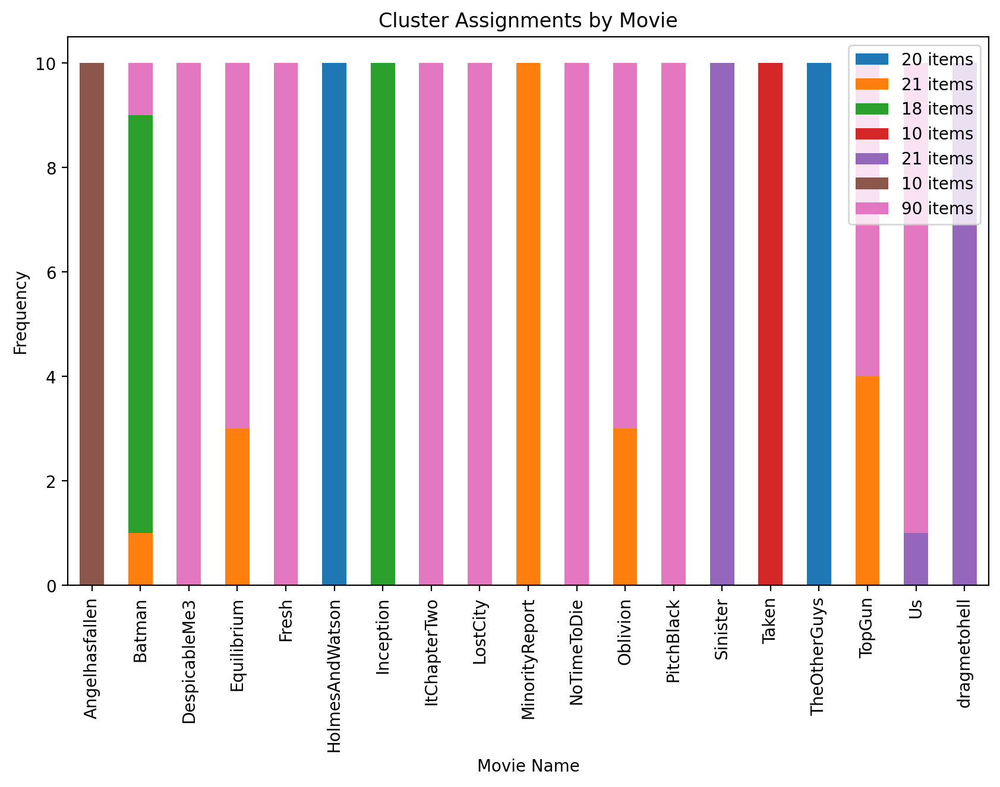

In [36]:
plot_cluster_by_movie(k_means_df_m1k7)

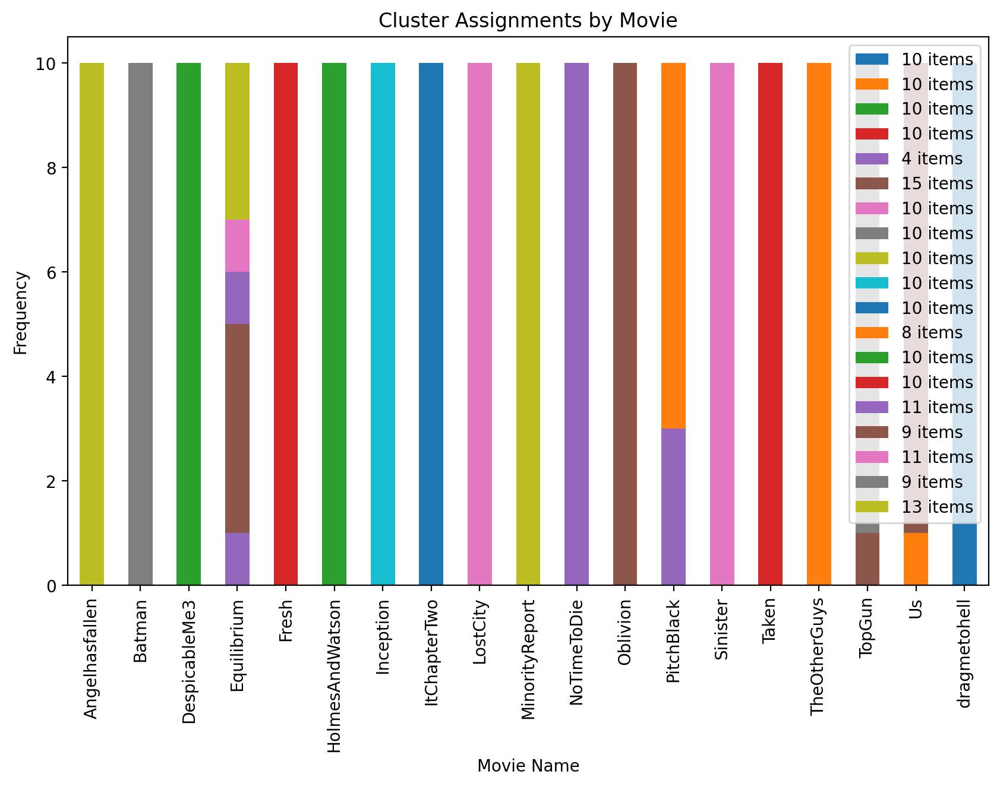

In [37]:
plot_cluster_by_movie(k_means_df_m1k19)

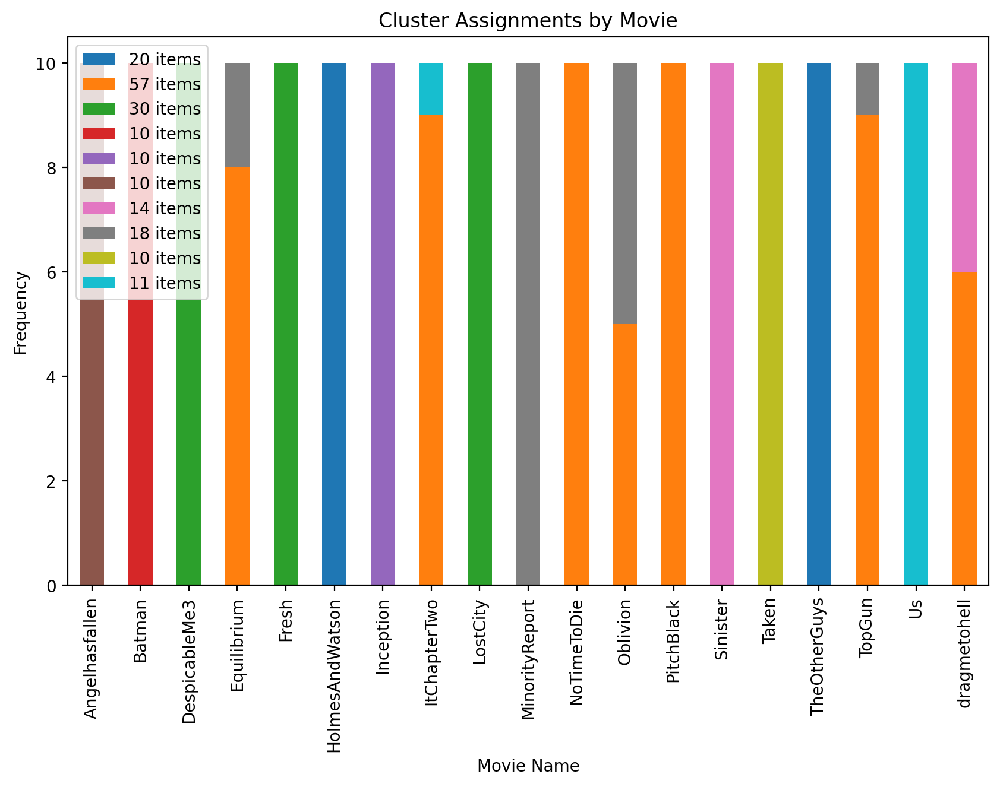

In [38]:
plot_cluster_by_movie(k_means_df_m2k10)

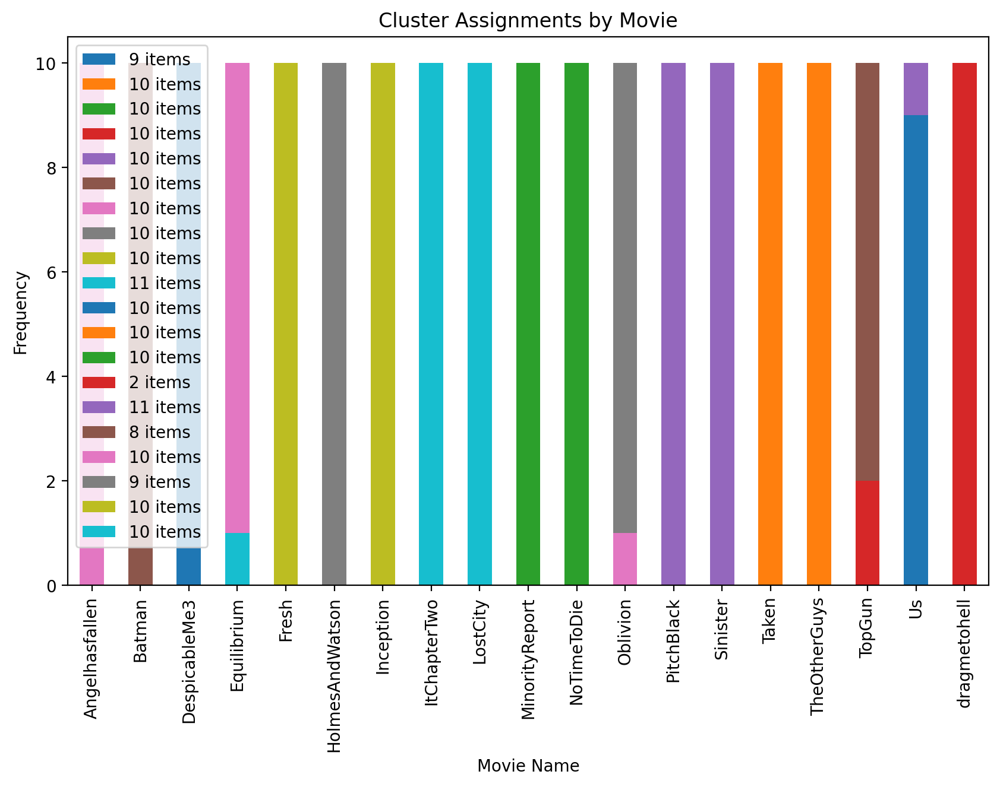

In [39]:
plot_cluster_by_movie(k_means_df_m2k20)

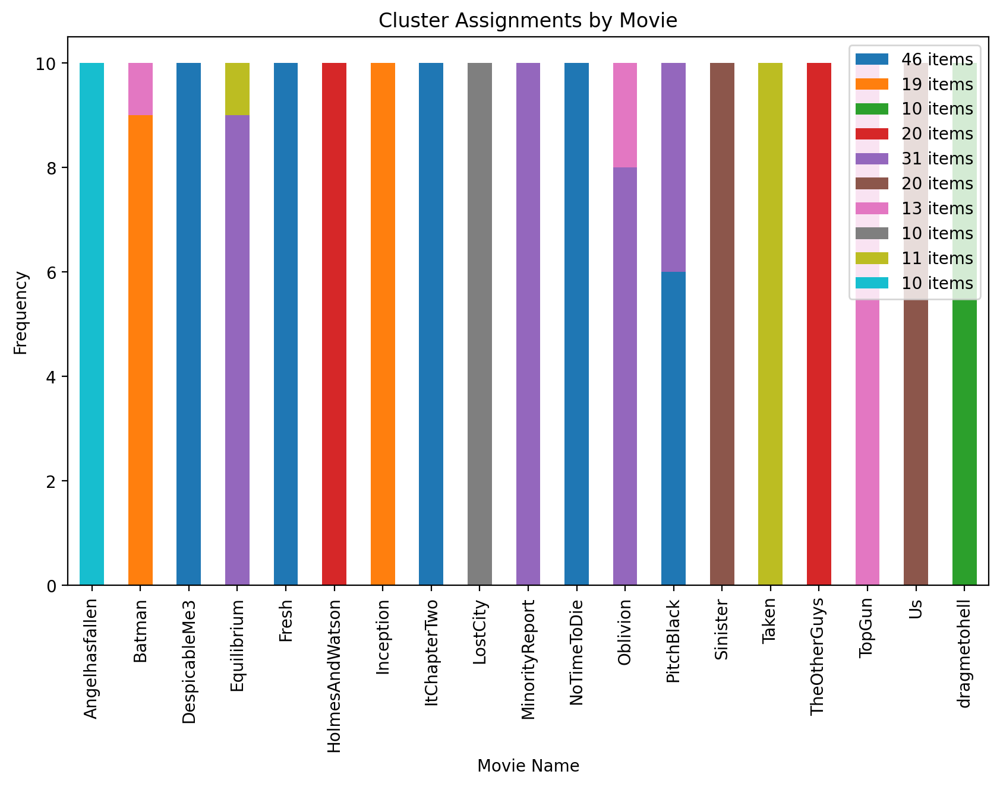

In [40]:
plot_cluster_by_movie(k_means_df_m3k10)

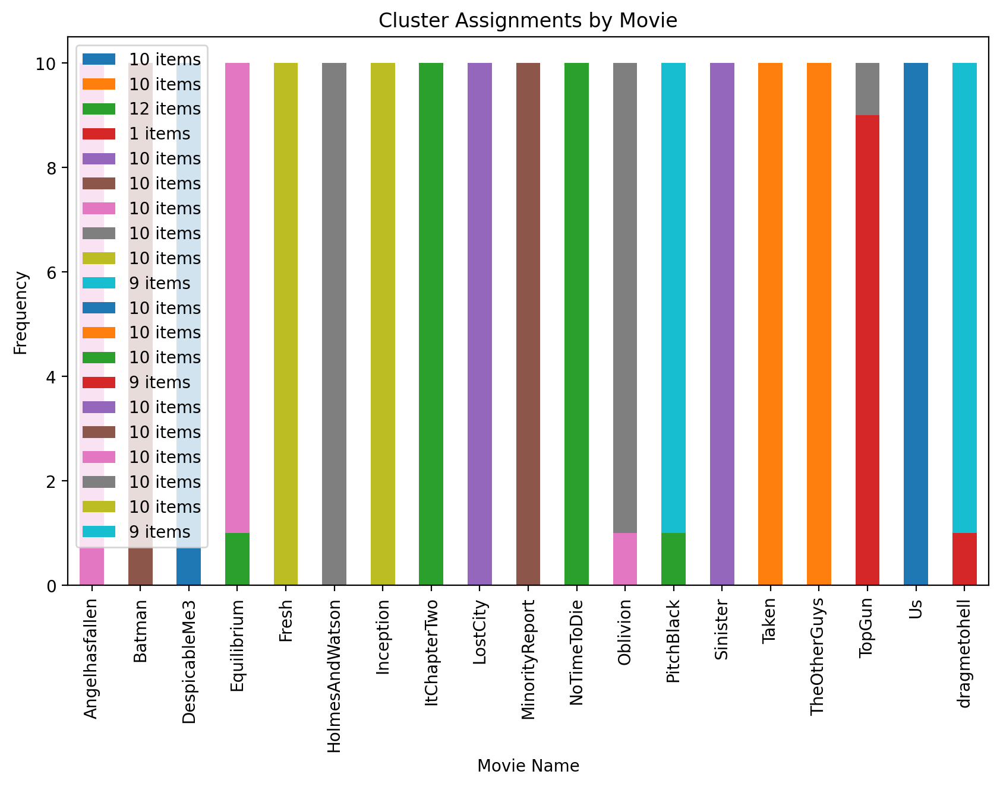

In [41]:
plot_cluster_by_movie(k_means_df_m3k20)

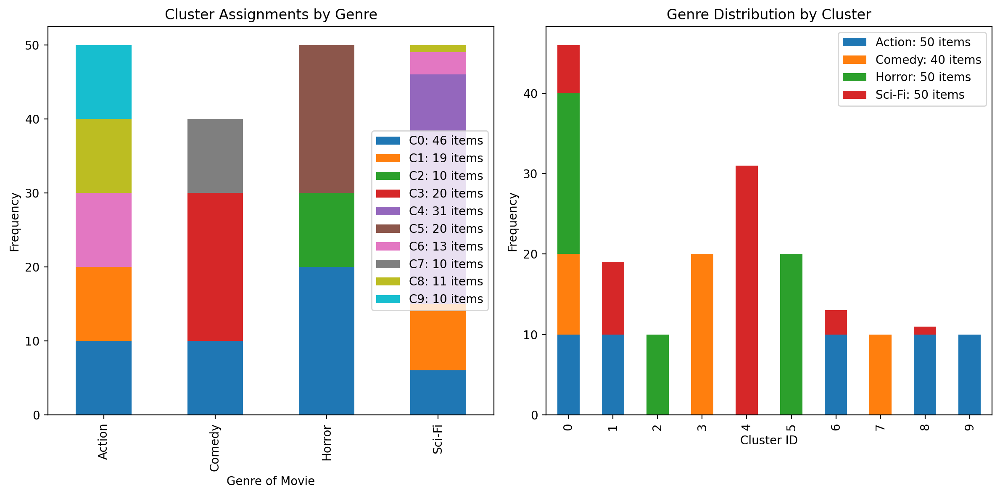

In [42]:
plot_genre_and_cluster(k_means_df_m3k10)

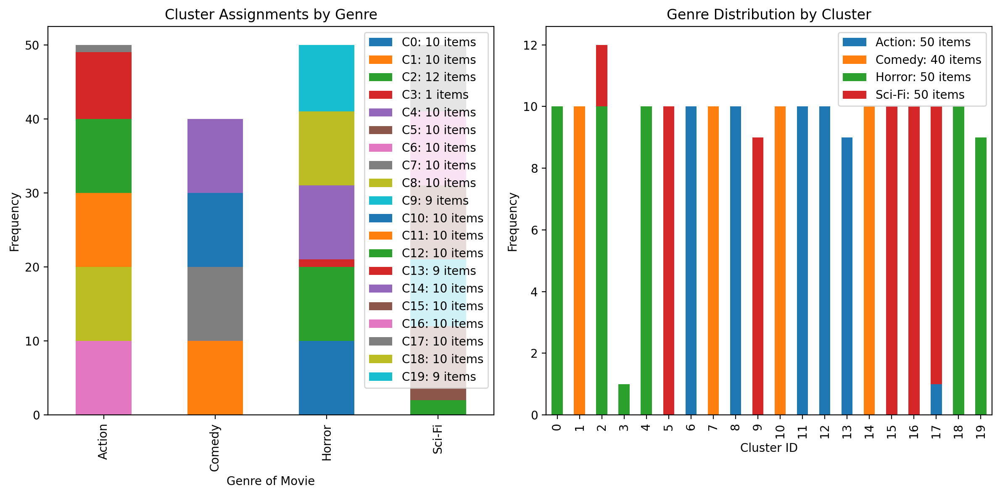

In [43]:
plot_genre_and_cluster(k_means_df_m3k20)

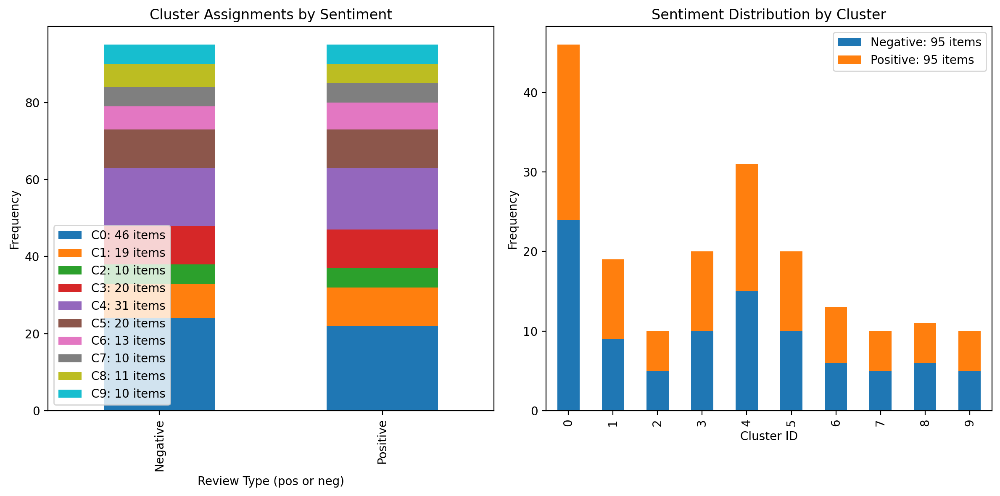

In [44]:
plot_sentiment_and_cluster(k_means_df_m3k10)

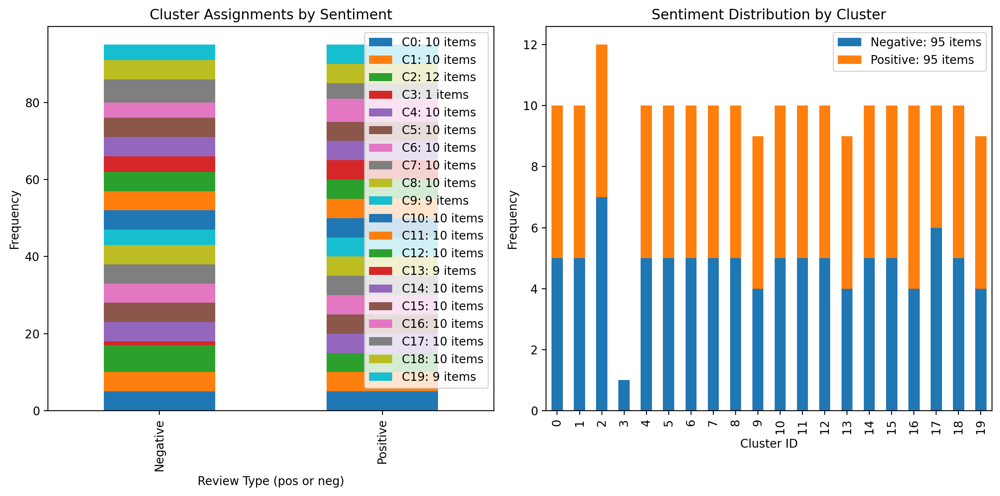

In [45]:
plot_sentiment_and_cluster(k_means_df_m3k20)

## 2.2 Clustering on Doc2Vec

### 2.2.1 Code Testing

In [46]:
cluster_title,clusters,k_means_df,km = k_means(processed_text = final_processed_text_m1, titles = titles, tfidf_matrix = features_doc2vec_m1_scaled, k=6)

### 2.2.2 Finding Silhouette Scores

In [228]:
# M1

for k in range(2,31):
  cluster_title,clusters,k_means_df,km = k_means(processed_text = final_processed_text_m1, titles = titles, tfidf_matrix = features_doc2vec_m1_scaled, k=k)
  sil_score = silhouette_score(features_doc2vec_m1_scaled, clusters)
  print(f"CM1, k = {k}, silhouette score = {sil_score}")

  '''
  CM1, k = 2, silhouette score = 0.5196551084518433
CM1, k = 3, silhouette score = 0.4253775477409363
CM1, k = 4, silhouette score = 0.42364996671676636
CM1, k = 5, silhouette score = 0.37898901104927063
CM1, k = 6, silhouette score = 0.37288859486579895
CM1, k = 7, silhouette score = 0.40903240442276
CM1, k = 8, silhouette score = 0.39504602551460266
CM1, k = 9, silhouette score = 0.3648478090763092
CM1, k = 10, silhouette score = 0.36450129747390747
CM1, k = 11, silhouette score = 0.3169756233692169
CM1, k = 12, silhouette score = 0.3276118040084839
CM1, k = 13, silhouette score = 0.2972152829170227
CM1, k = 14, silhouette score = 0.28175410628318787
CM1, k = 15, silhouette score = 0.2663489580154419
CM1, k = 16, silhouette score = 0.2600267231464386
CM1, k = 17, silhouette score = 0.2632405757904053
CM1, k = 18, silhouette score = 0.2619364559650421
CM1, k = 19, silhouette score = 0.24250631034374237
CM1, k = 20, silhouette score = 0.2216479629278183
CM1, k = 21, silhouette score = 0.2360871583223343
CM1, k = 22, silhouette score = 0.2372998297214508
CM1, k = 23, silhouette score = 0.21131037175655365
CM1, k = 24, silhouette score = 0.18802474439144135
CM1, k = 25, silhouette score = 0.21197375655174255
CM1, k = 26, silhouette score = 0.19370795786380768
CM1, k = 27, silhouette score = 0.18306680023670197
CM1, k = 28, silhouette score = 0.16755016148090363
CM1, k = 29, silhouette score = 0.19507472217082977
CM1, k = 30, silhouette score = 0.16344696283340454
'''


CM1, k = 2, silhouette score = 0.5196551084518433
CM1, k = 3, silhouette score = 0.4253775477409363
CM1, k = 4, silhouette score = 0.42364996671676636
CM1, k = 5, silhouette score = 0.37898901104927063
CM1, k = 6, silhouette score = 0.37288859486579895
CM1, k = 7, silhouette score = 0.40903240442276
CM1, k = 8, silhouette score = 0.39504602551460266
CM1, k = 9, silhouette score = 0.3648478090763092
CM1, k = 10, silhouette score = 0.36450129747390747
CM1, k = 11, silhouette score = 0.3169756233692169
CM1, k = 12, silhouette score = 0.3276118040084839
CM1, k = 13, silhouette score = 0.2972152829170227
CM1, k = 14, silhouette score = 0.28175410628318787
CM1, k = 15, silhouette score = 0.2663489580154419
CM1, k = 16, silhouette score = 0.2600267231464386
CM1, k = 17, silhouette score = 0.2632405757904053
CM1, k = 18, silhouette score = 0.2619364559650421
CM1, k = 19, silhouette score = 0.24250631034374237
CM1, k = 20, silhouette score = 0.2216479629278183
CM1, k = 21, silhouette score = 0.

In [48]:
# M2

for k in range(2,31):
  cluster_title,clusters,k_means_df,km = k_means(processed_text = final_processed_text_m2, titles = titles, tfidf_matrix = features_doc2vec_m2_scaled, k=k)
  sil_score = silhouette_score(features_doc2vec_m2_scaled, clusters)
  print(f"CM1, k = {k}, silhouette score = {sil_score}")

'''
CM1, k = 2, silhouette score = 0.5013188123703003
CM1, k = 3, silhouette score = 0.4550231993198395
CM1, k = 4, silhouette score = 0.4131399095058441
CM1, k = 5, silhouette score = 0.3679853677749634
CM1, k = 6, silhouette score = 0.3948546051979065
CM1, k = 7, silhouette score = 0.34941092133522034
CM1, k = 8, silhouette score = 0.3606193959712982
CM1, k = 9, silhouette score = 0.35646483302116394
CM1, k = 10, silhouette score = 0.31215569376945496
CM1, k = 11, silhouette score = 0.2931821048259735
CM1, k = 12, silhouette score = 0.31420600414276123
CM1, k = 13, silhouette score = 0.27191275358200073
CM1, k = 14, silhouette score = 0.29208776354789734
CM1, k = 15, silhouette score = 0.3013198971748352
CM1, k = 16, silhouette score = 0.2748512029647827
CM1, k = 17, silhouette score = 0.2806313633918762
CM1, k = 18, silhouette score = 0.27707234025001526
CM1, k = 19, silhouette score = 0.28793418407440186
CM1, k = 20, silhouette score = 0.2952708899974823
CM1, k = 21, silhouette score = 0.27119195461273193
CM1, k = 22, silhouette score = 0.2581327259540558
CM1, k = 23, silhouette score = 0.23072686791419983
CM1, k = 24, silhouette score = 0.24550387263298035
CM1, k = 25, silhouette score = 0.24132420122623444
CM1, k = 26, silhouette score = 0.2417166531085968
CM1, k = 27, silhouette score = 0.2216348797082901
CM1, k = 28, silhouette score = 0.24539455771446228
CM1, k = 29, silhouette score = 0.21428252756595612
CM1, k = 30, silhouette score = 0.2070695012807846
'''

CM1, k = 2, silhouette score = 0.5013188123703003
CM1, k = 3, silhouette score = 0.4550231993198395
CM1, k = 4, silhouette score = 0.4131399095058441
CM1, k = 5, silhouette score = 0.3679853677749634
CM1, k = 6, silhouette score = 0.3948546051979065
CM1, k = 7, silhouette score = 0.34941092133522034
CM1, k = 8, silhouette score = 0.3606193959712982
CM1, k = 9, silhouette score = 0.35646483302116394
CM1, k = 10, silhouette score = 0.31215569376945496
CM1, k = 11, silhouette score = 0.2931821048259735
CM1, k = 12, silhouette score = 0.31420600414276123
CM1, k = 13, silhouette score = 0.27191275358200073
CM1, k = 14, silhouette score = 0.29208776354789734
CM1, k = 15, silhouette score = 0.3013198971748352
CM1, k = 16, silhouette score = 0.2748512029647827
CM1, k = 17, silhouette score = 0.2806313633918762
CM1, k = 18, silhouette score = 0.27707234025001526
CM1, k = 19, silhouette score = 0.28793418407440186
CM1, k = 20, silhouette score = 0.2952708899974823
CM1, k = 21, silhouette score =

CM1, k = 2, silhouette score = 0.5028348565101624
CM1, k = 3, silhouette score = 0.46951568126678467
CM1, k = 4, silhouette score = 0.402498334646225
CM1, k = 5, silhouette score = 0.37891584634780884
CM1, k = 6, silhouette score = 0.3849501311779022
CM1, k = 7, silhouette score = 0.42282626032829285
CM1, k = 8, silhouette score = 0.38243746757507324
CM1, k = 9, silhouette score = 0.3561113476753235
CM1, k = 10, silhouette score = 0.3542611002922058
CM1, k = 11, silhouette score = 0.3399466276168823
CM1, k = 12, silhouette score = 0.34045788645744324
CM1, k = 13, silhouette score = 0.34179431200027466
CM1, k = 14, silhouette score = 0.3313223123550415
CM1, k = 15, silhouette score = 0.30008071660995483
CM1, k = 16, silhouette score = 0.29071012139320374
CM1, k = 17, silhouette score = 0.28814417123794556
CM1, k = 18, silhouette score = 0.2893514633178711
CM1, k = 19, silhouette score = 0.293396532535553
CM1, k = 20, silhouette score = 0.25772473216056824
CM1, k = 21, silhouette score =

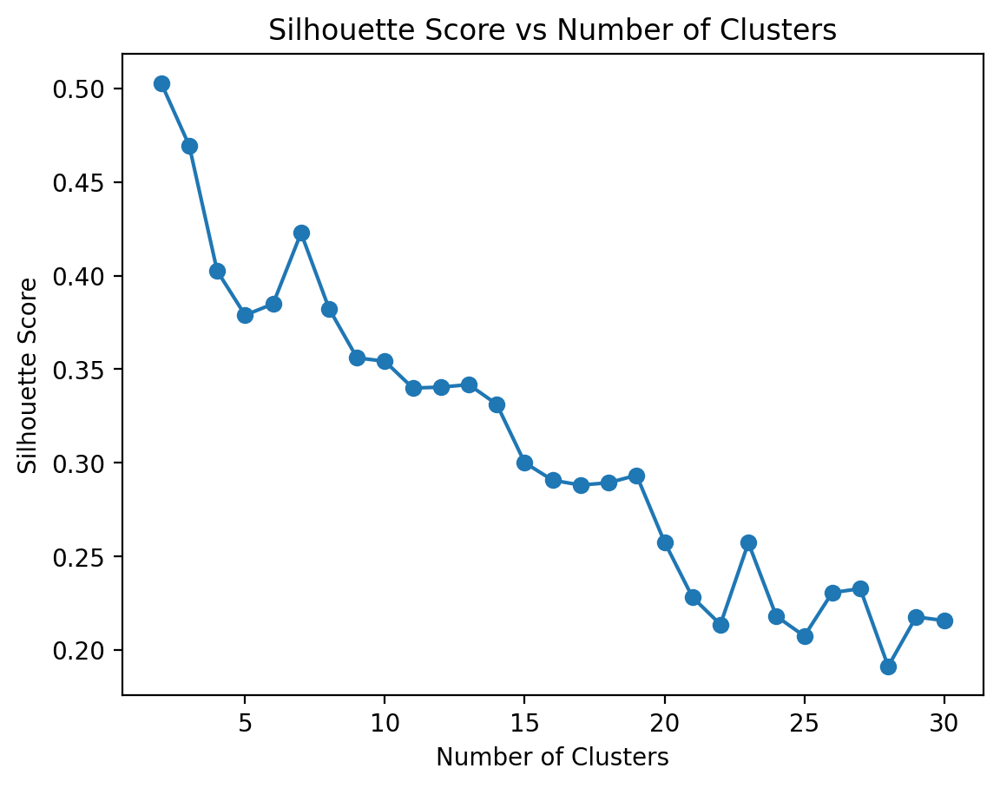

In [49]:
# M3

clusters_ct = []
sil_scores = []

for k in range(2,31):
  cluster_title,clusters,k_means_df,km = k_means(processed_text = final_processed_text_m3, titles = titles, tfidf_matrix = features_doc2vec_m3_scaled, k=k)
  sil_score = silhouette_score(features_doc2vec_m3_scaled, clusters)
  print(f"CM1, k = {k}, silhouette score = {sil_score}")
  clusters_ct.append(k)
  sil_scores.append(sil_score)

# Plot the graph of silhouette scores
plt.plot(clusters_ct, sil_scores, marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score vs Number of Clusters')
plt.show()

'''
CM1, k = 2, silhouette score = 0.5028348565101624
CM1, k = 3, silhouette score = 0.46951568126678467
CM1, k = 4, silhouette score = 0.402498334646225
CM1, k = 5, silhouette score = 0.37891584634780884
CM1, k = 6, silhouette score = 0.3849501311779022
CM1, k = 7, silhouette score = 0.42282626032829285
CM1, k = 8, silhouette score = 0.38243746757507324
CM1, k = 9, silhouette score = 0.3561113476753235
CM1, k = 10, silhouette score = 0.3542611002922058
CM1, k = 11, silhouette score = 0.3399466276168823
CM1, k = 12, silhouette score = 0.34045788645744324
CM1, k = 13, silhouette score = 0.34179431200027466
CM1, k = 14, silhouette score = 0.3313223123550415
CM1, k = 15, silhouette score = 0.30008071660995483
CM1, k = 16, silhouette score = 0.29071012139320374
CM1, k = 17, silhouette score = 0.28814417123794556
CM1, k = 18, silhouette score = 0.2893514633178711
CM1, k = 19, silhouette score = 0.293396532535553
CM1, k = 20, silhouette score = 0.25772473216056824
CM1, k = 21, silhouette score = 0.22822925448417664
CM1, k = 22, silhouette score = 0.2136688232421875
CM1, k = 23, silhouette score = 0.25728467106819153
CM1, k = 24, silhouette score = 0.21807853877544403
CM1, k = 25, silhouette score = 0.20746943354606628
CM1, k = 26, silhouette score = 0.23068611323833466
CM1, k = 27, silhouette score = 0.23277190327644348
CM1, k = 28, silhouette score = 0.19127430021762848
CM1, k = 29, silhouette score = 0.2176976054906845
CM1, k = 30, silhouette score = 0.2157650589942932
'''

### 2.2.3 Graph Results

In [50]:
cluster_title_m1k6_d2v,clusters_m1k6_d2v,k_means_df_m1k6_d2v,km_m1k6_d2v = k_means(processed_text = final_processed_text_m1, titles = titles, tfidf_matrix = features_doc2vec_m1_scaled, k=6)
cluster_title_m2k6_d2v,clusters_m2k6_d2v,k_means_df_m2k6_d2v,km_m2k6_d2v = k_means(processed_text = final_processed_text_m2, titles = titles, tfidf_matrix = features_doc2vec_m2_scaled, k=6)
cluster_title_m3k6_d2v,clusters_m3k6_d2v,k_means_df_m3k6_d2v,km_m3k6_d2v = k_means(processed_text = final_processed_text_m3, titles = titles, tfidf_matrix = features_doc2vec_m3_scaled, k=6)

cluster_title_m1k15_d2v,clusters_m1k15_d2v,k_means_df_m1k15_d2v,km_m1k15_d2v = k_means(processed_text = final_processed_text_m1, titles = titles, tfidf_matrix = features_doc2vec_m1_scaled, k=15)
cluster_title_m2k15_d2v,clusters_m2k15_d2v,k_means_df_m2k15_d2v,km_m2k15_d2v = k_means(processed_text = final_processed_text_m2, titles = titles, tfidf_matrix = features_doc2vec_m2_scaled, k=15)
cluster_title_m3k15_d2v,clusters_m3k15_d2v,k_means_df_m3k15_d2v,km_m3k15_d2v = k_means(processed_text = final_processed_text_m3, titles = titles, tfidf_matrix = features_doc2vec_m3_scaled, k=15)

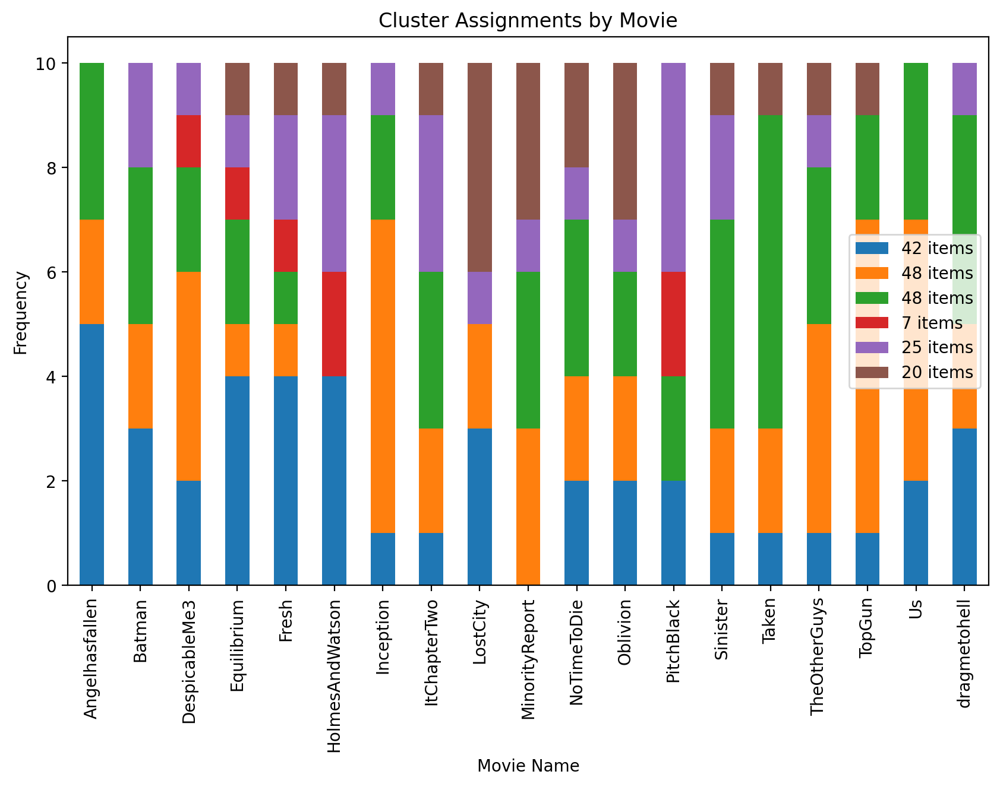

In [51]:
plot_cluster_by_movie(k_means_df_m1k6_d2v)

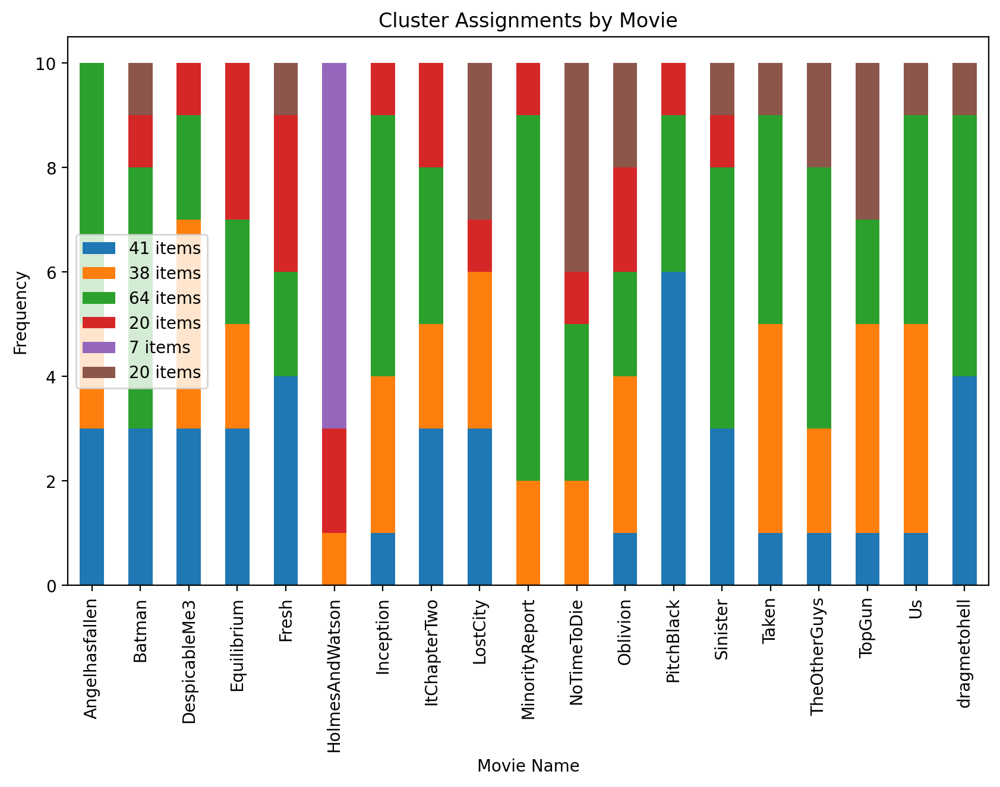

In [52]:
plot_cluster_by_movie(k_means_df_m2k6_d2v)

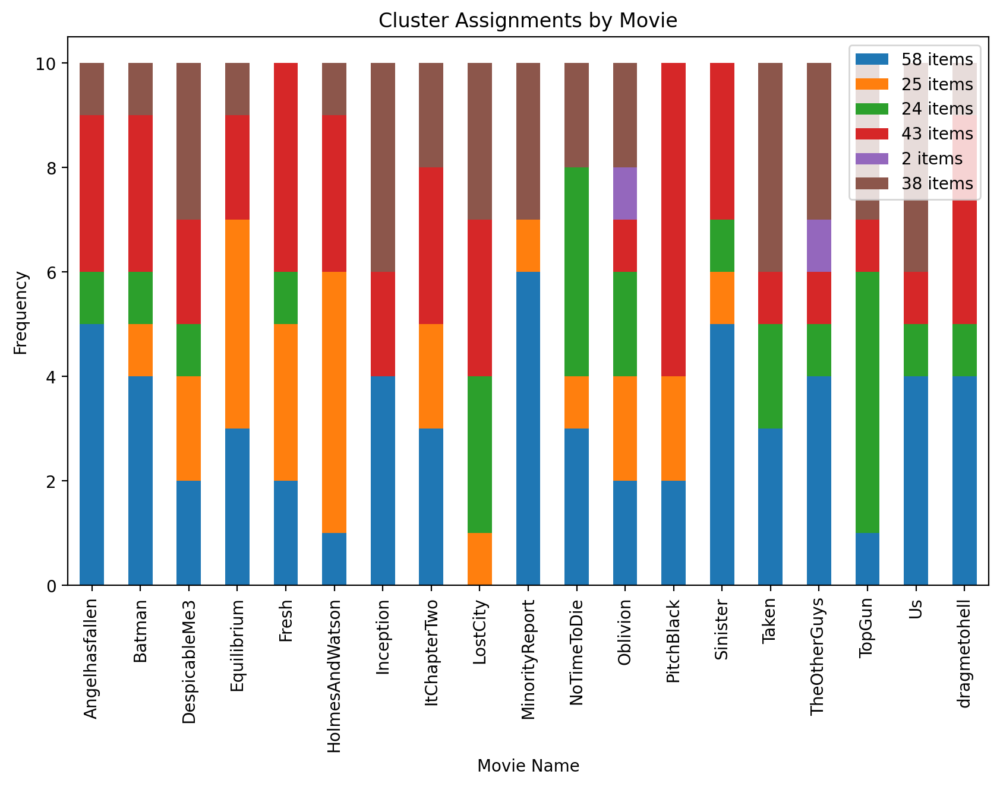

In [53]:
plot_cluster_by_movie(k_means_df_m3k6_d2v)

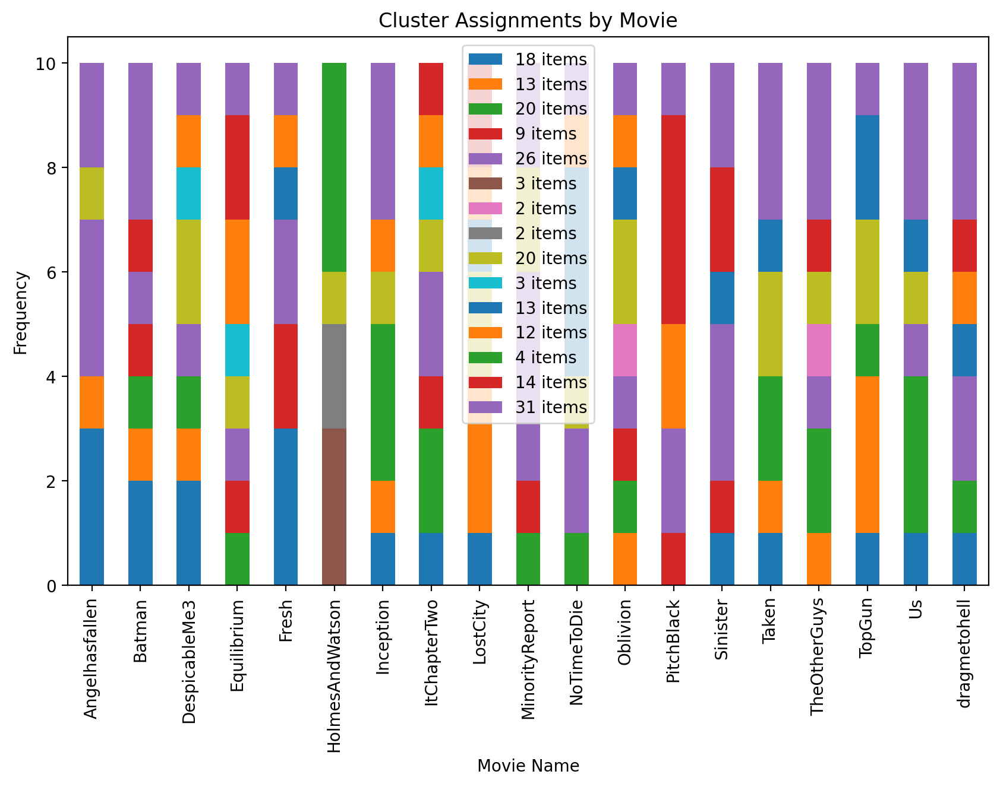

In [54]:
plot_cluster_by_movie(k_means_df_m3k15_d2v)

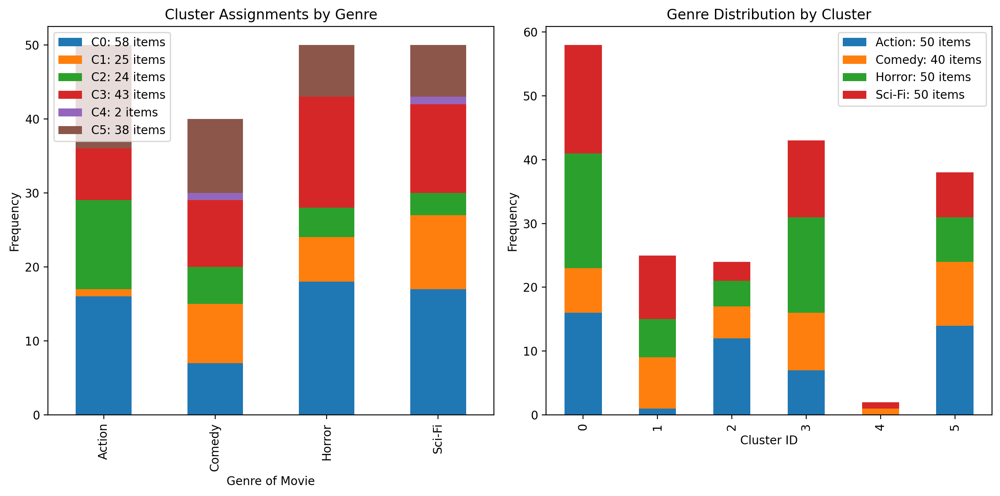

In [55]:
plot_genre_and_cluster(k_means_df_m3k6_d2v)

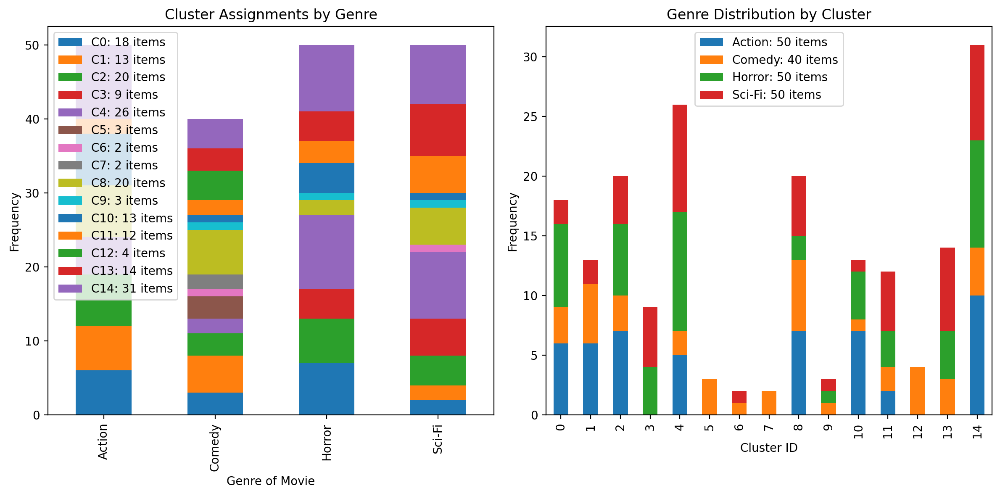

In [56]:
plot_genre_and_cluster(k_means_df_m3k15_d2v)

# 3. Sentiment Analysis Modeling

## 3.0 Methods

In [134]:
def plot_confusion_matrix(y_actual, y_pred):
    # Generate confusion matrix
    cm = confusion_matrix(y_actual, y_pred)

    # Create a heatmap of the confusion matrix
    sns.heatmap(cm, annot=True, cmap='Blues', fmt='d')

    # Add labels, title, and axis ticks
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title('Confusion Matrix')
    plt.show()

## 3.1 Data Prep

In [57]:
labels_pn = corpus_df['Review Type (pos or neg)']

labels_pn.value_counts()

Negative    95
Positive    95
Name: Review Type (pos or neg), dtype: int64

In [136]:
X_m1t_train, X_m1t_test, y_m1t_train, y_m1t_test = train_test_split(tfidf_matrix_m1, labels_pn, test_size=0.2, random_state=23)
X_m2t_train, X_m2t_test, y_m2t_train, y_m2t_test = train_test_split(tfidf_matrix_m2, labels_pn, test_size=0.2, random_state=23)
X_m3t_train, X_m3t_test, y_m3t_train, y_m3t_test = train_test_split(tfidf_matrix_m3, labels_pn, test_size=0.2, random_state=23)

X_m1d_train, X_m1d_test, y_m1d_train, y_m1d_test = train_test_split(features_doc2vec_m1_scaled, labels_pn, test_size=0.2, random_state=23)
X_m2d_train, X_m2d_test, y_m2d_train, y_m2d_test = train_test_split(features_doc2vec_m2_scaled, labels_pn, test_size=0.2, random_state=23)
X_m3d_train, X_m3d_test, y_m3d_train, y_m3d_test = train_test_split(features_doc2vec_m3_scaled, labels_pn, test_size=0.2, random_state=23)



In [59]:
model_type = 'svm'

print(classifiers(tfidf_matrix_m1, labels_pn, model_type))
print(classifiers(tfidf_matrix_m2, labels_pn, model_type))
print(classifiers(tfidf_matrix_m3, labels_pn, model_type))

print(classifiers(features_doc2vec_m1, labels_pn, model_type))
print(classifiers(features_doc2vec_m2, labels_pn, model_type))
print(classifiers(features_doc2vec_m3, labels_pn, model_type))

print(classifiers(features_doc2vec_m1_scaled, labels_pn, model_type))
print(classifiers(features_doc2vec_m2_scaled, labels_pn, model_type))
print(classifiers(features_doc2vec_m3_scaled, labels_pn, model_type))

svm
0.47368421052631576
svm
0.42105263157894735
svm
0.42105263157894735
svm
0.4473684210526316
svm
0.4473684210526316
svm
0.4473684210526316
svm
0.3684210526315789
svm
0.5526315789473685
svm
0.42105263157894735


In [60]:
model_type = 'logistic'

print(classifiers(tfidf_matrix_m1, labels_pn, model_type))
print(classifiers(tfidf_matrix_m2, labels_pn, model_type))
print(classifiers(tfidf_matrix_m3, labels_pn, model_type))

print(classifiers(features_doc2vec_m1, labels_pn, model_type))
print(classifiers(features_doc2vec_m2, labels_pn, model_type))
print(classifiers(features_doc2vec_m3, labels_pn, model_type))

print(classifiers(features_doc2vec_m1_scaled, labels_pn, model_type))
print(classifiers(features_doc2vec_m2_scaled, labels_pn, model_type))
print(classifiers(features_doc2vec_m3_scaled, labels_pn, model_type))

logistic
0.5
logistic
0.5
logistic
0.47368421052631576
logistic
0.47368421052631576
logistic
0.39473684210526316
logistic
0.39473684210526316
logistic
0.5526315789473685
logistic
0.6842105263157895
logistic
0.5


In [61]:
print(features_doc2vec_m1)

         0         1         2         3         4         5         6    \
0   0.496619 -0.442347  0.264046  0.068652  0.003146 -0.112818 -0.221591   
0   0.411480 -0.373832  0.221487  0.061469  0.002975 -0.096158 -0.181199   
0   0.401484 -0.362872  0.213643  0.058204  0.001264 -0.093291 -0.181023   
0   0.471627 -0.418859  0.247496  0.065461 -0.000172 -0.105383 -0.205586   
0   0.485289 -0.435037  0.258467  0.069029  0.002568 -0.109059 -0.215484   
..       ...       ...       ...       ...       ...       ...       ...   
0   0.400673 -0.346369  0.207761  0.055334  0.003530 -0.090596 -0.180048   
0   0.333292 -0.291018  0.172740  0.046912  0.002569 -0.077678 -0.149673   
0   0.477624 -0.418342  0.245770  0.068572  0.000701 -0.110132 -0.215810   
0   0.378045 -0.329834  0.193614  0.053435  0.000873 -0.087468 -0.168808   
0   0.357764 -0.315468  0.184374  0.051247  0.001908 -0.079668 -0.161849   

         7         8         9    ...       190       191       192       193  \
0   1.

In [62]:
model_type = 'naive_bayes'

print(classifiers(tfidf_matrix_m1, labels_pn, model_type))
print(classifiers(tfidf_matrix_m2, labels_pn, model_type))
print(classifiers(tfidf_matrix_m3, labels_pn, model_type))

#print(classifiers(features_doc2vec_m1, labels_pn, model_type))
#print(classifiers(features_doc2vec_m2, labels_pn, model_type))
#print(classifiers(features_doc2vec_m3, labels_pn, model_type))

naive_bayes
0.42105263157894735
naive_bayes
0.42105263157894735
naive_bayes
0.39473684210526316


In [63]:
model_type = 'randomforest'

print(classifiers(tfidf_matrix_m1, labels_pn, model_type))
print(classifiers(tfidf_matrix_m2, labels_pn, model_type))
print(classifiers(tfidf_matrix_m3, labels_pn, model_type))

print(classifiers(features_doc2vec_m1, labels_pn, model_type))
print(classifiers(features_doc2vec_m2, labels_pn, model_type))
print(classifiers(features_doc2vec_m3, labels_pn, model_type))

print(classifiers(features_doc2vec_m1_scaled, labels_pn, model_type))
print(classifiers(features_doc2vec_m2_scaled, labels_pn, model_type))
print(classifiers(features_doc2vec_m3_scaled, labels_pn, model_type))

randomforest
0.631578947368421
randomforest
0.631578947368421
randomforest
0.5526315789473685
randomforest
0.47368421052631576
randomforest
0.34210526315789475
randomforest
0.3684210526315789
randomforest
0.4473684210526316
randomforest
0.3684210526315789
randomforest
0.3157894736842105


### 3.3 Research Model Feature Terms

In [142]:
rf = RandomForestClassifier()

# Fit the model on the training data
rf.fit(X_m3t_train, y_m3t_train)
y_pred = rf.predict(X_m3t_test)

accuracy_score(y_m3t_test, y_pred)

0.6578947368421053

In [143]:
# Extract feature importances
feature_importances = pd.Series(rf.feature_importances_, index=X_m3t_train.columns)

# Sort the feature importances in descending order
sorted_importances = feature_importances.sort_values(ascending=False)

# Print the top 10 most important features
print(sorted_importances.head(30))

right       0.006791
point       0.005555
clich       0.004607
despit      0.004597
someth      0.004464
everi       0.004386
routin      0.003912
mention     0.003893
anticip     0.003829
tradit      0.003778
viewer      0.003609
thank       0.003545
order       0.003543
scene       0.003383
often       0.003366
success     0.003360
entir       0.003171
angel       0.003147
though      0.003064
horror      0.003030
feel        0.002883
engag       0.002870
strong      0.002863
interest    0.002803
whole       0.002784
delight     0.002775
style       0.002758
might       0.002664
doesnt      0.002655
bare        0.002622
dtype: float64


## 3.4 Try to Make the Best Model

We're going to dig deeply into making "best" models from three different permutations:

* SVM using Normalized Doc2Vec, Method 2 cleaning
* Logistic using TF/IDF, Method 3 cleaning
* Random Forest using TF/IDF, Method 1 cleaning

### 3.4.1 SVM Normalized Doc2Vec Method2

In [144]:
X_train, X_test, y_train, y_test = X_m2d_train, X_m2d_test, y_m2d_train, y_m2d_test

for kernel in ['linear', 'rbf', 'poly']:
  for C_value in [0.01, 0.1, 1, 10, 100, 1000, 10000]:
      
      model_svm = SVC(kernel = kernel, C=C_value, random_state = random_seed)
      model_svm.fit(X_train, y_train)
      y_pred = model_svm.predict(X_test)
      acc = accuracy_score(y_test, y_pred) 
      print(f"Kernel: {kernel}, C: {C_value}, Accuracy: {acc}")

# Best performing is Kernel: linear, C: 10

Kernel: linear, C: 0.01, Accuracy: 0.4473684210526316
Kernel: linear, C: 0.1, Accuracy: 0.6578947368421053
Kernel: linear, C: 1, Accuracy: 0.6842105263157895
Kernel: linear, C: 10, Accuracy: 0.6842105263157895
Kernel: linear, C: 100, Accuracy: 0.5263157894736842
Kernel: linear, C: 1000, Accuracy: 0.5263157894736842
Kernel: linear, C: 10000, Accuracy: 0.5263157894736842
Kernel: rbf, C: 0.01, Accuracy: 0.4473684210526316
Kernel: rbf, C: 0.1, Accuracy: 0.4473684210526316
Kernel: rbf, C: 1, Accuracy: 0.5526315789473685
Kernel: rbf, C: 10, Accuracy: 0.47368421052631576
Kernel: rbf, C: 100, Accuracy: 0.7105263157894737
Kernel: rbf, C: 1000, Accuracy: 0.6052631578947368
Kernel: rbf, C: 10000, Accuracy: 0.6052631578947368
Kernel: poly, C: 0.01, Accuracy: 0.4473684210526316
Kernel: poly, C: 0.1, Accuracy: 0.4473684210526316
Kernel: poly, C: 1, Accuracy: 0.47368421052631576
Kernel: poly, C: 10, Accuracy: 0.6578947368421053
Kernel: poly, C: 100, Accuracy: 0.47368421052631576
Kernel: poly, C: 1000

In [145]:
# Best performing is Kernel: linear, C: 10

svm_m2d_best = SVC(kernel = 'linear', C = 10, probability = True, random_state = random_seed)
svm_m2d_best.fit(X_train, y_train)
y_pred = svm_m2d_best.predict(X_test)
y_pred_proba = svm_m2d_best.predict_proba(X_test)
acc = accuracy_score(y_test, y_pred)
print(acc)
print(classification_report(y_test, y_pred))

y_pred_svm_m2d_best = y_pred.copy()
y_prob_svm_m2d_best = y_pred_proba.copy()


0.6842105263157895
              precision    recall  f1-score   support

    Negative       0.65      0.65      0.65        17
    Positive       0.71      0.71      0.71        21

    accuracy                           0.68        38
   macro avg       0.68      0.68      0.68        38
weighted avg       0.68      0.68      0.68        38



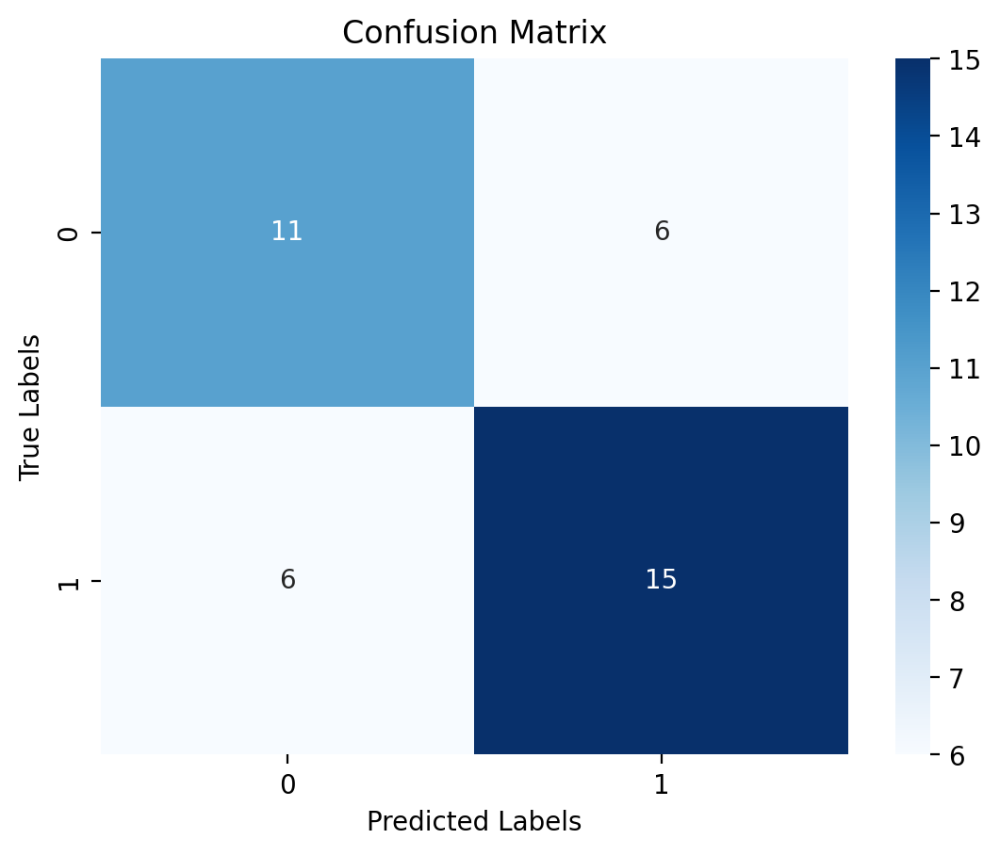

In [146]:
plot_confusion_matrix(y_test, y_pred)

### 3.4.2 Logistic TF/IDF Method 3

In [147]:
X_train, X_test, y_train, y_test = X_m3t_train, X_m3t_test, y_m3t_train, y_m3t_test

solver = 'saga'

penalties = ['l2', 'elasticnet']
C_values = [0.01, 0.1, 1, 10, 100, 1000, 10000]
alphas = [0, 0.5, 1]

penalties = ['elasticnet']
C_values = [0.01]
alphas = [0.5]

for penalty in penalties:
  for C_value in C_values:
    if penalty == 'elasticnet':
      for alpha in alphas:
        model_log = LogisticRegression(C=C_value, penalty = penalty, l1_ratio = alpha, solver = solver, random_state = random_seed)
        model_log.fit(X_train, y_train)
        y_pred = model_log.predict(X_test)
        acc = accuracy_score(y_test, y_pred) 
        print(f"Penalty: {penalty}, Alpha:{alpha}, C: {C_value}, Accuracy: {acc}")
    else:
        model_log = LogisticRegression(C=C_value, penalty = penalty, solver = solver, random_state = random_seed)
        model_log.fit(X_train, y_train)
        y_pred = model_log.predict(X_test)
        acc = accuracy_score(y_test, y_pred) 
        print(f"Penalty: {penalty}, C: {C_value}, Accuracy: {acc}")


# Best performing is penalty: elasticnet, alpha:0.5, C:0.01

Penalty: elasticnet, Alpha:0.5, C: 0.01, Accuracy: 0.5526315789473685


In [148]:
# Best performing is penalty: elasticnet, alpha:0.5, C:0.01

log_m3t_best = LogisticRegression(C=0.01, penalty = 'elasticnet', l1_ratio = 0.5, solver = solver, random_state = random_seed)
log_m3t_best.fit(X_train, y_train)
y_pred = log_m3t_best.predict(X_test)
y_pred_proba = log_m3t_best.predict_proba(X_test)
acc = accuracy_score(y_test, y_pred)
print(acc)
print(classification_report(y_test, y_pred))

y_pred_log_m3t_best = y_pred.copy()
y_prob_log_m3t_best = y_pred_proba.copy()

0.5526315789473685
              precision    recall  f1-score   support

    Negative       0.00      0.00      0.00        17
    Positive       0.55      1.00      0.71        21

    accuracy                           0.55        38
   macro avg       0.28      0.50      0.36        38
weighted avg       0.31      0.55      0.39        38



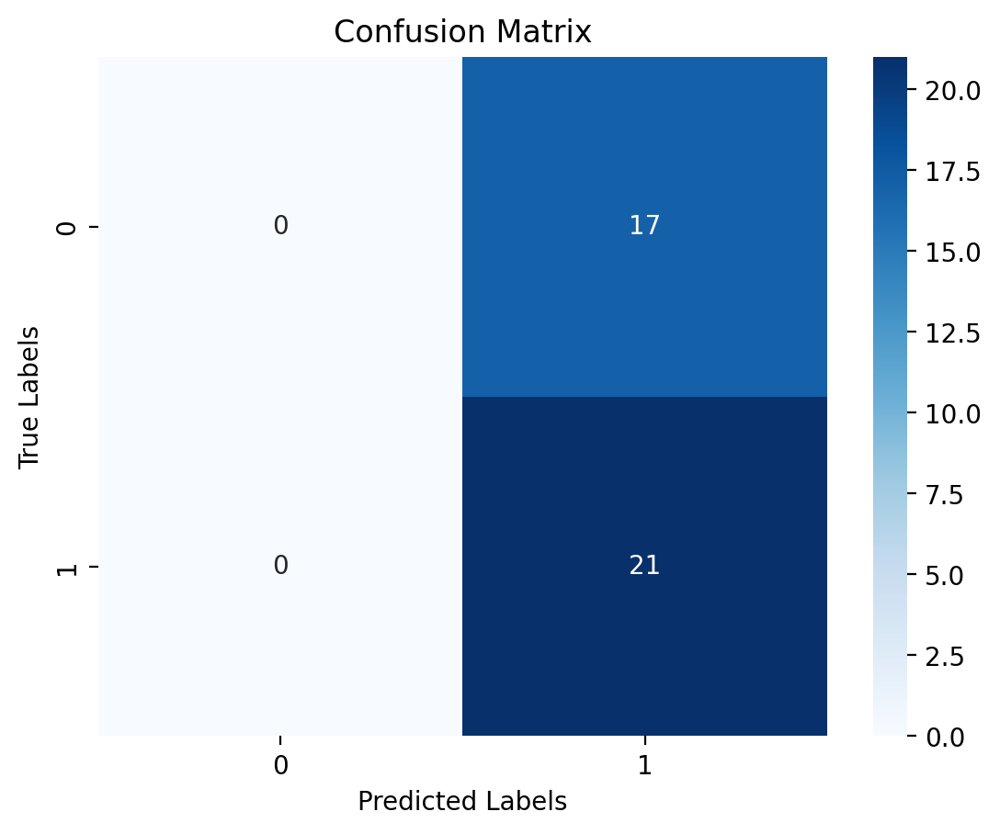

In [149]:
plot_confusion_matrix(y_test, y_pred)

In [150]:
#Note: using a different model (l2 best performing) so that I can extract coefficients

logreg = LogisticRegression(C=10, penalty = 'l2', solver = 'liblinear', random_state = random_seed)

# Fit the model on the training data
logreg.fit(X_train, y_train)
y_pred = logreg.predict(X_test)

accuracy_score(y_test, y_pred)

0.5263157894736842

In [151]:
# Extract the coefficients and feature names
coefficients = logreg.coef_[0]
feature_names = list(X_train.columns)

# Create a dataframe to store the coefficients and feature names
coefficients_df = pd.DataFrame({'Feature': feature_names, 'Coefficient': coefficients})

# Sort the coefficients by absolute value (magnitude)
coefficients_df['Absolute_Coefficient'] = np.abs(coefficients_df['Coefficient'])
coefficients_df = coefficients_df.sort_values(by='Absolute_Coefficient', ascending=False)

# Print the top 10 features with their coefficients
top_features = coefficients_df.head(30)
print(top_features)

      Feature  Coefficient  Absolute_Coefficient
7218    taken     1.427845              1.427845
4212  loretta     1.357291              1.357291
1908   despic    -1.351650              1.351650
2859    fresh     1.343620              1.343620
7484    total    -1.317660              1.317660
6031    right     1.210175              1.210175
4455  mention    -1.189147              1.189147
2537   fallen    -1.183575              1.183575
5395    polit     1.171241              1.171241
1293    clich    -1.168078              1.168078
7943   vision     1.160015              1.160015
2273     emot     1.159597              1.159597
8196    woman    -1.142333              1.142333
1640  creatur     1.133992              1.133992
7298    terri     1.104900              1.104900
3427   horror     1.097254              1.097254
140     agent    -1.069994              1.069994
8020    watch    -1.031741              1.031741
3860     joke    -1.017379              1.017379
5497   presid     0.

### 3.4.3 Random Forest TF/IDF Method 1

In [152]:
X_train, X_test, y_train, y_test = X_m1t_train, X_m1t_test, y_m1t_train, y_m1t_test

for n_estimators in [5, 10, 20, 50, 100, 200, 400]:
  model_rf = RandomForestClassifier(n_estimators = n_estimators, random_state = random_seed)
  model_rf.fit(X_train, y_train)
  y_pred = model_rf.predict(X_test)
  acc = accuracy_score(y_test, y_pred) 
  print(f"Estimators: {n_estimators}, Accuracy: {acc}")


# Best performing is n_estimators 200

Estimators: 5, Accuracy: 0.5526315789473685
Estimators: 10, Accuracy: 0.5263157894736842
Estimators: 20, Accuracy: 0.5263157894736842
Estimators: 50, Accuracy: 0.5
Estimators: 100, Accuracy: 0.5526315789473685
Estimators: 200, Accuracy: 0.6578947368421053
Estimators: 400, Accuracy: 0.631578947368421


In [153]:
# Best performing is n_estimators 200

rf_m1t_best = RandomForestClassifier(n_estimators = 200, random_state = random_seed)
rf_m1t_best.fit(X_train, y_train)
y_pred = rf_m1t_best.predict(X_test)
y_pred_proba = rf_m1t_best.predict_proba(X_test)
acc = accuracy_score(y_test, y_pred)
print(acc)
print(classification_report(y_test, y_pred))

y_pred_rf_m1t_best = y_pred.copy()
y_prob_rf_m1t_best = y_pred_proba.copy()

0.6578947368421053
              precision    recall  f1-score   support

    Negative       0.58      0.82      0.68        17
    Positive       0.79      0.52      0.63        21

    accuracy                           0.66        38
   macro avg       0.68      0.67      0.66        38
weighted avg       0.70      0.66      0.65        38



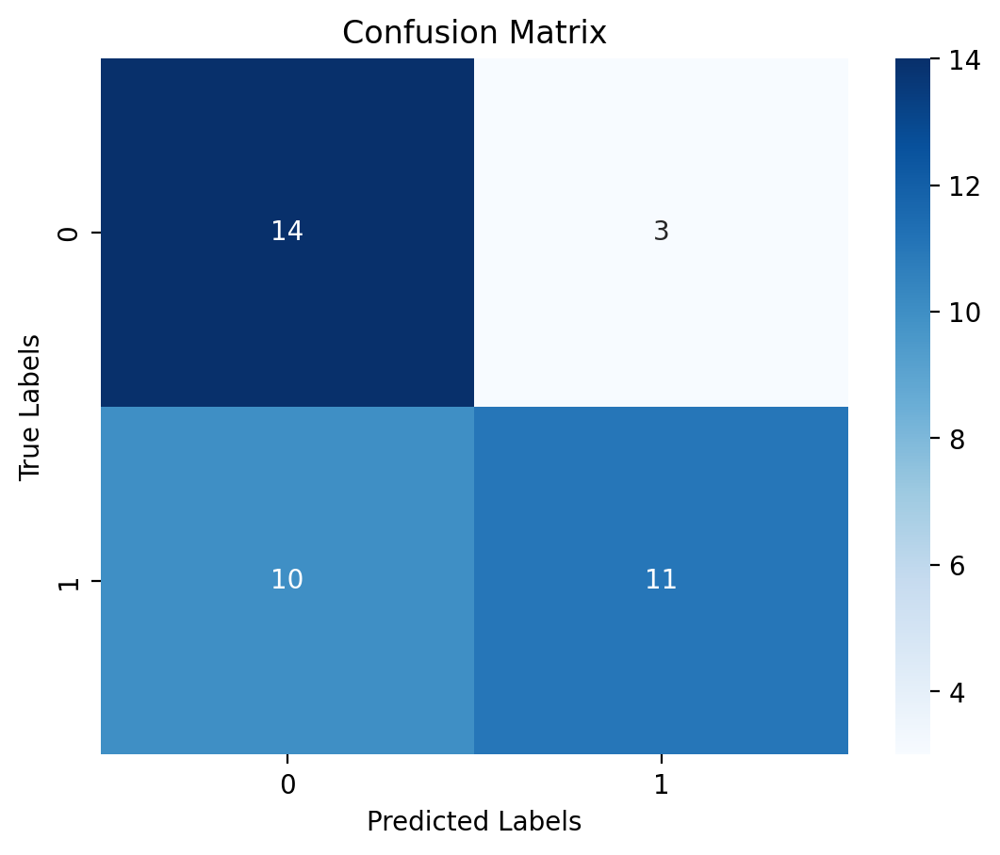

In [154]:
plot_confusion_matrix(y_test, y_pred)

### 3.4.4 Ensemble!

In [155]:
test = (y_prob_log_m3t_best + y_prob_rf_m1t_best) / 2
print(test)

y_pred_ensemble = np.where(test >= 0.5, "Negative", "Positive")

y_pred_ensemble = [x[0] for x in y_pred_ensemble]
print(y_pred_ensemble)

[[0.49838891 0.50161109]
 [0.53338891 0.46661109]
 [0.48338891 0.51661109]
 [0.43338891 0.56661109]
 [0.50588891 0.49411109]
 [0.54338891 0.45661109]
 [0.47088891 0.52911109]
 [0.45338891 0.54661109]
 [0.50088891 0.49911109]
 [0.51338891 0.48661109]
 [0.47838891 0.52161109]
 [0.51338891 0.48661109]
 [0.47088891 0.52911109]
 [0.48338891 0.51661109]
 [0.47088891 0.52911109]
 [0.51588891 0.48411109]
 [0.49088891 0.50911109]
 [0.43588891 0.56411109]
 [0.50588891 0.49411109]
 [0.53338891 0.46661109]
 [0.52838891 0.47161109]
 [0.50338891 0.49661109]
 [0.49588891 0.50411109]
 [0.57088891 0.42911109]
 [0.45838891 0.54161109]
 [0.47088891 0.52911109]
 [0.52088891 0.47911109]
 [0.51088891 0.48911109]
 [0.45588891 0.54411109]
 [0.52088891 0.47911109]
 [0.59838891 0.40161109]
 [0.48838891 0.51161109]
 [0.53088891 0.46911109]
 [0.49088891 0.50911109]
 [0.52338891 0.47661109]
 [0.46338891 0.53661109]
 [0.50338891 0.49661109]
 [0.48588891 0.51411109]]
['Positive', 'Negative', 'Positive', 'Positive', 

In [156]:
# Aggregate the predicted probabilities
y_prob_ensemble = (y_prob_svm_m2d_best + y_prob_log_m3t_best + y_prob_rf_m1t_best) / 3

# Make ensemble predictions
ensemble_threshold = 0.5  # Threshold for binary classification
y_pred_ensemble = np.where(y_prob_ensemble >= ensemble_threshold, "Negative", "Positive")

y_pred_ensemble = [x[0] for x in y_pred_ensemble]
print(y_pred_ensemble)

['Negative', 'Negative', 'Positive', 'Positive', 'Negative', 'Negative', 'Positive', 'Positive', 'Negative', 'Negative', 'Positive', 'Negative', 'Positive', 'Positive', 'Positive', 'Negative', 'Negative', 'Positive', 'Positive', 'Negative', 'Negative', 'Positive', 'Positive', 'Negative', 'Positive', 'Positive', 'Negative', 'Negative', 'Positive', 'Negative', 'Negative', 'Positive', 'Negative', 'Positive', 'Negative', 'Positive', 'Negative', 'Positive']


In [157]:
print(y_prob_ensemble)
print(y_pred_ensemble)

[[0.51886875 0.48113125]
 [0.52225927 0.47774073]
 [0.48330868 0.51669132]
 [0.46219695 0.53780305]
 [0.5157708  0.4842292 ]
 [0.5074213  0.4925787 ]
 [0.48676317 0.51323683]
 [0.46892594 0.53107406]
 [0.50998825 0.49001175]
 [0.50892594 0.49107406]
 [0.49667774 0.50332226]
 [0.5198856  0.4801144 ]
 [0.47799505 0.52200495]
 [0.48892594 0.51107406]
 [0.48059261 0.51940739]
 [0.51533565 0.48466435]
 [0.5036307  0.4963693 ]
 [0.43642745 0.56357255]
 [0.49345666 0.50654334]
 [0.52024151 0.47975849]
 [0.52253531 0.47746469]
 [0.49363596 0.50636404]
 [0.49256851 0.50743149]
 [0.56237775 0.43762225]
 [0.47225927 0.52774073]
 [0.46596161 0.53403839]
 [0.511648   0.488352  ]
 [0.51726499 0.48273501]
 [0.47780371 0.52219629]
 [0.52961957 0.47038043]
 [0.58862175 0.41137825]
 [0.48671044 0.51328956]
 [0.52680992 0.47319008]
 [0.49080014 0.50919986]
 [0.53700938 0.46299062]
 [0.47559261 0.52440739]
 [0.50733165 0.49266835]
 [0.47917644 0.52082356]]
['Negative', 'Negative', 'Positive', 'Positive', 

In [158]:
acc = accuracy_score(y_test, y_pred_ensemble)
print(acc)
print(classification_report(y_test, y_pred_ensemble))


0.631578947368421
              precision    recall  f1-score   support

    Negative       0.58      0.65      0.61        17
    Positive       0.68      0.62      0.65        21

    accuracy                           0.63        38
   macro avg       0.63      0.63      0.63        38
weighted avg       0.64      0.63      0.63        38



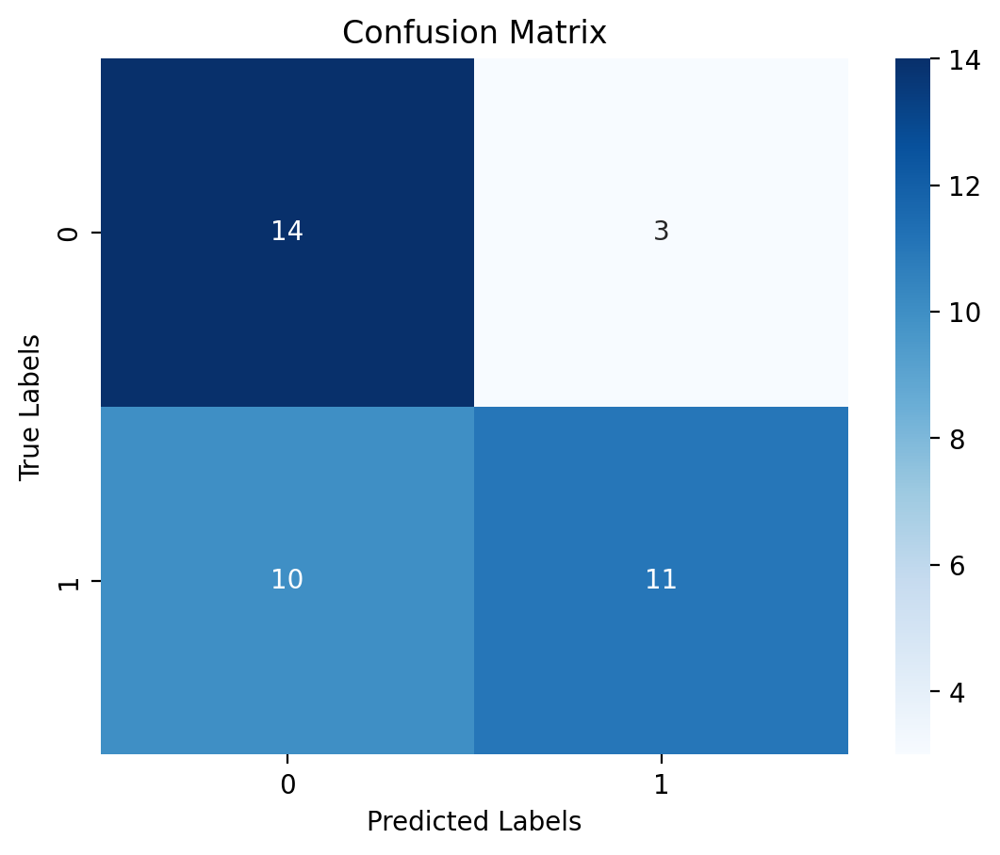

In [159]:
plot_confusion_matrix(y_test, y_pred)

In [160]:
print(type(y_pred))

<class 'numpy.ndarray'>


### 3.4.5 Ensemble Take 2

In [161]:
# Perform majority voting
y_pred_ensemble2 = []
y_pred1, y_pred2, y_pred3 = y_prob_svm_m2d_best, y_prob_log_m3t_best, y_prob_rf_m1t_best

for i in range(len(y_pred1)):
    votes = [y_pred1[i], y_pred2[i], y_pred3[i]]
    positive_count = votes.count("Positive")
    if positive_count >= 2:
        y_pred_ensemble2.append("Positive")
    else:
        y_pred_ensemble2.append("Negative")

<ipython-input-161-4137c40c4f7d>:7: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  positive_count = votes.count("Positive")


In [162]:
acc = accuracy_score(y_test, y_pred_ensemble2)
print(acc)
print(classification_report(y_test, y_pred_ensemble))


0.4473684210526316
              precision    recall  f1-score   support

    Negative       0.58      0.65      0.61        17
    Positive       0.68      0.62      0.65        21

    accuracy                           0.63        38
   macro avg       0.63      0.63      0.63        38
weighted avg       0.64      0.63      0.63        38



# 4. Genre (Multi-Class) Analysis Modeling

## 4.0 Methods

## 4.1 Data Prep

In [163]:
labels_genre = corpus_df['Genre of Movie']

labels_genre.value_counts()

Action    50
Horror    50
Sci-Fi    50
Comedy    40
Name: Genre of Movie, dtype: int64

In [164]:
X_m1t_train, X_m1t_test, y_m1t_train, y_m1t_test = train_test_split(tfidf_matrix_m1, labels_genre, test_size=0.2, random_state=23)
X_m2t_train, X_m2t_test, y_m2t_train, y_m2t_test = train_test_split(tfidf_matrix_m2, labels_genre, test_size=0.2, random_state=23)
X_m3t_train, X_m3t_test, y_m3t_train, y_m3t_test = train_test_split(tfidf_matrix_m3, labels_genre, test_size=0.2, random_state=23)

X_m1d_train, X_m1d_test, y_m1d_train, y_m1d_test = train_test_split(features_doc2vec_m1_scaled, labels_genre, test_size=0.2, random_state=23)
X_m2d_train, X_m2d_test, y_m2d_train, y_m2d_test = train_test_split(features_doc2vec_m2_scaled, labels_genre, test_size=0.2, random_state=23)
X_m3d_train, X_m3d_test, y_m3d_train, y_m3d_test = train_test_split(features_doc2vec_m3_scaled, labels_genre, test_size=0.2, random_state=23)



In [165]:
y_m1t_test.value_counts()

Sci-Fi    11
Action    10
Comedy     9
Horror     8
Name: Genre of Movie, dtype: int64

## 4.2 High-Level Runthru of Model Performance

In [166]:
model_type = 'svm'

print(classifiers(tfidf_matrix_m1, labels_genre, model_type))
print(classifiers(tfidf_matrix_m2, labels_genre, model_type))
print(classifiers(tfidf_matrix_m3, labels_genre, model_type))

print(classifiers(features_doc2vec_m1, labels_genre, model_type))
print(classifiers(features_doc2vec_m2, labels_genre, model_type))
print(classifiers(features_doc2vec_m3, labels_genre, model_type))

print(classifiers(features_doc2vec_m1_scaled, labels_genre, model_type))
print(classifiers(features_doc2vec_m2_scaled, labels_genre, model_type))
print(classifiers(features_doc2vec_m3_scaled, labels_genre, model_type))

svm
1.0
svm
1.0
svm
1.0
svm
0.23684210526315788
svm
0.3157894736842105
svm
0.34210526315789475
svm
0.39473684210526316
svm
0.42105263157894735
svm
0.42105263157894735


In [167]:
model_type = 'logistic'

print(classifiers(tfidf_matrix_m1, labels_genre, model_type))
print(classifiers(tfidf_matrix_m2, labels_genre, model_type))
print(classifiers(tfidf_matrix_m3, labels_genre, model_type))

print(classifiers(features_doc2vec_m1, labels_genre, model_type))
print(classifiers(features_doc2vec_m2, labels_genre, model_type))
print(classifiers(features_doc2vec_m3, labels_genre, model_type))

print(classifiers(features_doc2vec_m1_scaled, labels_genre, model_type))
print(classifiers(features_doc2vec_m2_scaled, labels_genre, model_type))
print(classifiers(features_doc2vec_m3_scaled, labels_genre, model_type))

logistic
1.0
logistic
1.0
logistic
1.0
logistic
0.3157894736842105
logistic
0.34210526315789475
logistic
0.3157894736842105
logistic
0.7631578947368421
logistic
0.8421052631578947
logistic
0.9210526315789473


In [168]:
print(features_doc2vec_m3_scaled)

[[ 1.1121095  -1.2558252   0.17836088 ... -1.2611057  -1.2035795
   1.2172606 ]
 [-0.15057202  0.03058074 -0.49335238 ...  0.08484349  0.07704046
  -0.04867771]
 [-0.60445064  0.5125871  -0.8624781  ...  0.5460088   0.5004548
  -0.48269078]
 ...
 [ 0.13437457 -0.09266438  0.16614889 ... -0.14959307 -0.06852027
  -0.00225776]
 [-0.7384927   0.82846063 -0.6079049  ...  0.81635225  0.84378654
  -0.8101964 ]
 [-1.1234992   1.1387123  -1.1391052  ...  1.201207    1.1707984
  -1.1422355 ]]


In [169]:
model_type = 'naive_bayes'

print(classifiers(tfidf_matrix_m1, labels_genre, model_type))
print(classifiers(tfidf_matrix_m2, labels_genre, model_type))
print(classifiers(tfidf_matrix_m3, labels_genre, model_type))

#print(classifiers(features_doc2vec_m1, labels_genre, model_type))
#print(classifiers(features_doc2vec_m2, labels_genre, model_type))
#print(classifiers(features_doc2vec_m3, labels_genre, model_type))

naive_bayes
1.0
naive_bayes
1.0
naive_bayes
1.0


In [170]:
model_type = 'randomforest'

print(classifiers(tfidf_matrix_m1, labels_genre, model_type))
print(classifiers(tfidf_matrix_m2, labels_genre, model_type))
print(classifiers(tfidf_matrix_m3, labels_genre, model_type))

print(classifiers(features_doc2vec_m1, labels_genre, model_type))
print(classifiers(features_doc2vec_m2, labels_genre, model_type))
print(classifiers(features_doc2vec_m3, labels_genre, model_type))

print(classifiers(features_doc2vec_m1_scaled, labels_genre, model_type))
print(classifiers(features_doc2vec_m2_scaled, labels_genre, model_type))
print(classifiers(features_doc2vec_m3_scaled, labels_genre, model_type))

# WHY THE HECK ARE THESE MODELS SO GOOD ON THE TFIDF?

randomforest
0.8947368421052632
randomforest
0.8947368421052632
randomforest
0.8947368421052632
randomforest
0.5
randomforest
0.5263157894736842
randomforest
0.5526315789473685
randomforest
0.47368421052631576
randomforest
0.6052631578947368
randomforest
0.5263157894736842


## 4.3 Digging into Too-Good Model Performance

### 4.3.1 SVM on Multi-Class (note: failed)

In [171]:
model_svm = SVC()
model_svm.fit(X_m1t_train, y_m1t_train)
y_pred = model_svm.predict(X_m1t_test)
y_pred

array(['Action', 'Sci-Fi', 'Sci-Fi', 'Sci-Fi', 'Horror', 'Comedy',
       'Sci-Fi', 'Action', 'Comedy', 'Comedy', 'Action', 'Horror',
       'Sci-Fi', 'Sci-Fi', 'Sci-Fi', 'Sci-Fi', 'Action', 'Comedy',
       'Horror', 'Sci-Fi', 'Action', 'Action', 'Horror', 'Comedy',
       'Horror', 'Sci-Fi', 'Comedy', 'Comedy', 'Action', 'Action',
       'Comedy', 'Horror', 'Comedy', 'Sci-Fi', 'Action', 'Horror',
       'Horror', 'Action'], dtype=object)

In [172]:
accuracy_score(y_m1t_test, y_pred)

1.0

In [173]:
print(classification_report(y_m1t_test, y_pred))

              precision    recall  f1-score   support

      Action       1.00      1.00      1.00        10
      Comedy       1.00      1.00      1.00         9
      Horror       1.00      1.00      1.00         8
      Sci-Fi       1.00      1.00      1.00        11

    accuracy                           1.00        38
   macro avg       1.00      1.00      1.00        38
weighted avg       1.00      1.00      1.00        38



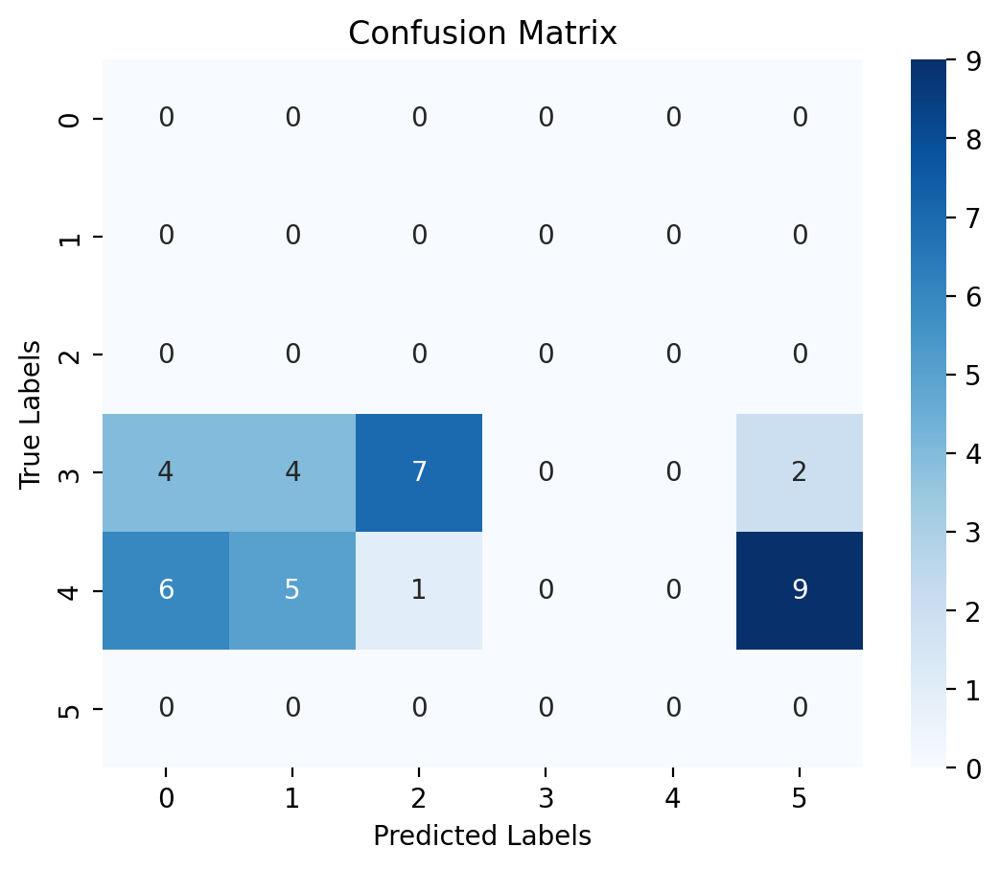

In [174]:
plot_confusion_matrix(y_test, y_pred)

### 4.3.2 RandomForest on Sentiment M1 for Clarity

In [175]:
rf = RandomForestClassifier()

# Fit the model on the training data
rf.fit(X_m1t_train, y_m1t_train)
y_pred = rf.predict(X_m1t_test)
y_prob = rf.predict_proba(X_m1t_test)

accuracy_score(y_m1t_test, y_pred)

0.9473684210526315

In [176]:
print(classification_report(y_m1t_test, y_pred))

              precision    recall  f1-score   support

      Action       1.00      0.80      0.89        10
      Comedy       1.00      1.00      1.00         9
      Horror       1.00      1.00      1.00         8
      Sci-Fi       0.85      1.00      0.92        11

    accuracy                           0.95        38
   macro avg       0.96      0.95      0.95        38
weighted avg       0.96      0.95      0.95        38



In [177]:
print(y_prob)
print(y_pred)

[[0.4  0.05 0.07 0.48]
 [0.18 0.06 0.13 0.63]
 [0.19 0.07 0.25 0.49]
 [0.1  0.03 0.05 0.82]
 [0.25 0.13 0.43 0.19]
 [0.28 0.33 0.15 0.24]
 [0.26 0.06 0.08 0.6 ]
 [0.49 0.07 0.15 0.29]
 [0.2  0.54 0.12 0.14]
 [0.16 0.45 0.12 0.27]
 [0.61 0.08 0.12 0.19]
 [0.1  0.05 0.71 0.14]
 [0.19 0.05 0.17 0.59]
 [0.13 0.05 0.13 0.69]
 [0.12 0.13 0.23 0.52]
 [0.08 0.06 0.24 0.62]
 [0.41 0.11 0.12 0.36]
 [0.2  0.39 0.19 0.22]
 [0.09 0.04 0.65 0.22]
 [0.16 0.07 0.13 0.64]
 [0.5  0.03 0.18 0.29]
 [0.41 0.03 0.18 0.38]
 [0.22 0.15 0.47 0.16]
 [0.13 0.58 0.08 0.21]
 [0.18 0.05 0.6  0.17]
 [0.22 0.04 0.17 0.57]
 [0.19 0.51 0.16 0.14]
 [0.23 0.33 0.24 0.2 ]
 [0.67 0.08 0.11 0.14]
 [0.54 0.07 0.15 0.24]
 [0.08 0.6  0.13 0.19]
 [0.14 0.03 0.63 0.2 ]
 [0.09 0.73 0.06 0.12]
 [0.15 0.05 0.37 0.43]
 [0.36 0.03 0.11 0.5 ]
 [0.15 0.08 0.57 0.2 ]
 [0.13 0.09 0.59 0.19]
 [0.42 0.16 0.31 0.11]]
['Sci-Fi' 'Sci-Fi' 'Sci-Fi' 'Sci-Fi' 'Horror' 'Comedy' 'Sci-Fi' 'Action'
 'Comedy' 'Comedy' 'Action' 'Horror' 'Sci-Fi' 'Sci-F

In [178]:
# Extract feature importances
feature_importances = pd.Series(rf.feature_importances_, index=X_m1t_train.columns)

# Sort the feature importances in descending order
sorted_importances = feature_importances.sort_values(ascending=False)

# Print the top 10 most important features
print(sorted_importances.head(10))

horror      0.021557
steve       0.013351
comedy      0.009471
agent       0.009222
scifi       0.007968
future      0.007657
sinister    0.006846
bratt       0.006708
begins      0.006432
jackson     0.005937
dtype: float64


### 4.3.3 LogReg on TFIDF Method 1

In [229]:
logreg = LogisticRegression()

# Fit the model on the training data
logreg.fit(X_m3t_train, y_m3t_train)
y_pred = logreg.predict(X_m3t_test)

accuracy_score(y_m3t_test, y_pred)

1.0

In [232]:
# Extract the coefficients and feature names
coefficients = logreg.coef_[3]
feature_names = list(X_m3t_train.columns)

# Create a dataframe to store the coefficients and feature names
coefficients_df = pd.DataFrame({'Feature': feature_names, 'Coefficient': coefficients})

# Sort the coefficients by absolute value (magnitude)
coefficients_df['Absolute_Coefficient'] = np.abs(coefficients_df['Coefficient'])
coefficients_df = coefficients_df.sort_values(by='Absolute_Coefficient', ascending=False)

# Print the top 10 features with their coefficients
top_features = coefficients_df.head(30)
print(top_features)

          Feature  Coefficient  Absolute_Coefficient
581        batman     1.215270              1.215270
6021      riddick     0.824541              0.824541
2356  equilibrium     0.662421              0.662421
251      anderton     0.628675              0.628675
5336       planet     0.621015              0.621015
3460        human     0.577708              0.577708
2607       ferrel    -0.479128              0.479128
1686        cruis     0.471891              0.471891
4886     oblivion     0.467540              0.467540
5466      precrim     0.443652              0.443652
5834         reef     0.438989              0.438989
5502      preston     0.424671              0.424671
2922        futur     0.422660              0.422660
3427       horror    -0.422144              0.422144
3965     kosinski     0.411987              0.411987
6243       scienc     0.407679              0.407679
5934       report     0.404461              0.404461
4531        minor     0.397206              0.

## 4.4 Interrogate the Best Models

All for SVM.  The TFIDF is just too good to be interesting

All M2.  That seems to be the best.

So then we do logistic, SVM, and RF.

### 4.4.1 SVM Normalized Doc2Vec Method2

In [181]:
X_train, X_test, y_train, y_test = X_m2d_train, X_m2d_test, y_m2d_train, y_m2d_test

for kernel in ['linear', 'rbf', 'poly']:
  for C_value in [0.01, 0.1, 1, 10, 100, 1000, 10000]:
      
      model_svm = SVC(kernel = kernel, C=C_value, random_state = random_seed)
      model_svm.fit(X_train, y_train)
      y_pred = model_svm.predict(X_test)
      acc = accuracy_score(y_test, y_pred) 
      print(f"Kernel: {kernel}, C: {C_value}, Accuracy: {acc}")

# Best performing is Kernel: linear, C: 10

Kernel: linear, C: 0.01, Accuracy: 0.5789473684210527
Kernel: linear, C: 0.1, Accuracy: 0.8421052631578947
Kernel: linear, C: 1, Accuracy: 0.9473684210526315
Kernel: linear, C: 10, Accuracy: 0.9210526315789473
Kernel: linear, C: 100, Accuracy: 0.9210526315789473
Kernel: linear, C: 1000, Accuracy: 0.9210526315789473
Kernel: linear, C: 10000, Accuracy: 0.9210526315789473
Kernel: rbf, C: 0.01, Accuracy: 0.21052631578947367
Kernel: rbf, C: 0.1, Accuracy: 0.34210526315789475
Kernel: rbf, C: 1, Accuracy: 0.42105263157894735
Kernel: rbf, C: 10, Accuracy: 0.7368421052631579
Kernel: rbf, C: 100, Accuracy: 0.7894736842105263
Kernel: rbf, C: 1000, Accuracy: 0.7894736842105263
Kernel: rbf, C: 10000, Accuracy: 0.7894736842105263
Kernel: poly, C: 0.01, Accuracy: 0.3157894736842105
Kernel: poly, C: 0.1, Accuracy: 0.3684210526315789
Kernel: poly, C: 1, Accuracy: 0.42105263157894735
Kernel: poly, C: 10, Accuracy: 0.5526315789473685
Kernel: poly, C: 100, Accuracy: 0.6842105263157895
Kernel: poly, C: 100

In [182]:
# Best performing is Kernel: linear, C: 10

svm_m2d_best = SVC(kernel = 'linear', C = 10, probability = True, random_state = random_seed)
svm_m2d_best.fit(X_train, y_train)
y_pred = svm_m2d_best.predict(X_test)
y_pred_proba = svm_m2d_best.predict_proba(X_test)
acc = accuracy_score(y_test, y_pred)
print(acc)
print(classification_report(y_test, y_pred))

y_pred_svm_m2d_best = y_pred.copy()
y_prob_svm_m2d_best = y_pred_proba.copy()


0.9210526315789473
              precision    recall  f1-score   support

      Action       0.89      0.80      0.84        10
      Comedy       1.00      1.00      1.00         9
      Horror       1.00      0.88      0.93         8
      Sci-Fi       0.85      1.00      0.92        11

    accuracy                           0.92        38
   macro avg       0.93      0.92      0.92        38
weighted avg       0.93      0.92      0.92        38



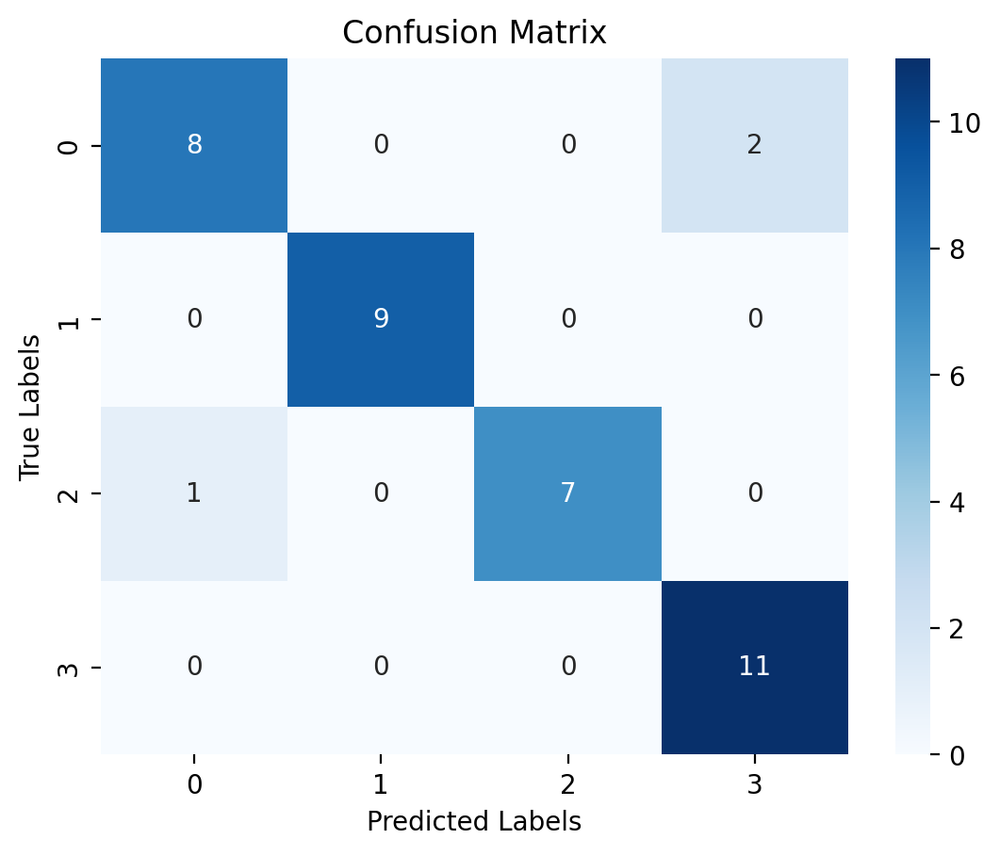

In [183]:
plot_confusion_matrix(y_test, y_pred)

### 4.4.2 Logistic Normalized D2V Method 2

In [184]:
X_train, X_test, y_train, y_test = X_m2d_train, X_m2d_test, y_m2d_train, y_m2d_test

solver = 'saga'

for penalty in ['l2', 'elasticnet']:
  for C_value in [0.01, 0.1, 1, 10, 100, 1000, 10000]:
    if penalty == 'elasticnet':
      for alpha in [0, 0.5, 1]:
        model_log = LogisticRegression(C=C_value, penalty = penalty, l1_ratio = alpha, solver = solver, random_state = random_seed)
        model_log.fit(X_train, y_train)
        y_pred = model_log.predict(X_test)
        acc = accuracy_score(y_test, y_pred) 
        print(f"Penalty: {penalty}, Alpha:{alpha}, C: {C_value}, Accuracy: {acc}")
    else:
        model_log = LogisticRegression(C=C_value, penalty = penalty, solver = solver, random_state = random_seed)
        model_log.fit(X_train, y_train)
        y_pred = model_log.predict(X_test)
        acc = accuracy_score(y_test, y_pred) 
        print(f"Penalty: {penalty}, C: {C_value}, Accuracy: {acc}")


# Best performing is penalty: L2, C:1

Penalty: l2, C: 0.01, Accuracy: 0.6052631578947368
Penalty: l2, C: 0.1, Accuracy: 0.8157894736842105
Penalty: l2, C: 1, Accuracy: 0.8157894736842105
Penalty: l2, C: 10, Accuracy: 0.8157894736842105
Penalty: l2, C: 100, Accuracy: 0.8157894736842105
Penalty: l2, C: 1000, Accuracy: 0.8157894736842105
Penalty: l2, C: 10000, Accuracy: 0.8157894736842105
Penalty: elasticnet, Alpha:0, C: 0.01, Accuracy: 0.6052631578947368
Penalty: elasticnet, Alpha:0.5, C: 0.01, Accuracy: 0.21052631578947367
Penalty: elasticnet, Alpha:1, C: 0.01, Accuracy: 0.2894736842105263
Penalty: elasticnet, Alpha:0, C: 0.1, Accuracy: 0.8157894736842105
Penalty: elasticnet, Alpha:0.5, C: 0.1, Accuracy: 0.6578947368421053
Penalty: elasticnet, Alpha:1, C: 0.1, Accuracy: 0.5526315789473685
Penalty: elasticnet, Alpha:0, C: 1, Accuracy: 0.8157894736842105
Penalty: elasticnet, Alpha:0.5, C: 1, Accuracy: 0.7894736842105263
Penalty: elasticnet, Alpha:1, C: 1, Accuracy: 0.7368421052631579
Penalty: elasticnet, Alpha:0, C: 10, Accur

In [185]:
# Best performing is penalty: L2, C:1

log_m2d_best = LogisticRegression(C=1, penalty = 'l2', solver = solver, random_state = random_seed)
log_m2d_best.fit(X_train, y_train)
y_pred = log_m2d_best.predict(X_test)
y_pred_proba = log_m2d_best.predict_proba(X_test)
acc = accuracy_score(y_test, y_pred)
print(acc)
print(classification_report(y_test, y_pred))

y_pred_log_m2d_best = y_pred.copy()
y_prob_log_m2d_best = y_pred_proba.copy()

0.8157894736842105
              precision    recall  f1-score   support

      Action       0.89      0.80      0.84        10
      Comedy       1.00      0.78      0.88         9
      Horror       0.75      0.75      0.75         8
      Sci-Fi       0.71      0.91      0.80        11

    accuracy                           0.82        38
   macro avg       0.84      0.81      0.82        38
weighted avg       0.84      0.82      0.82        38



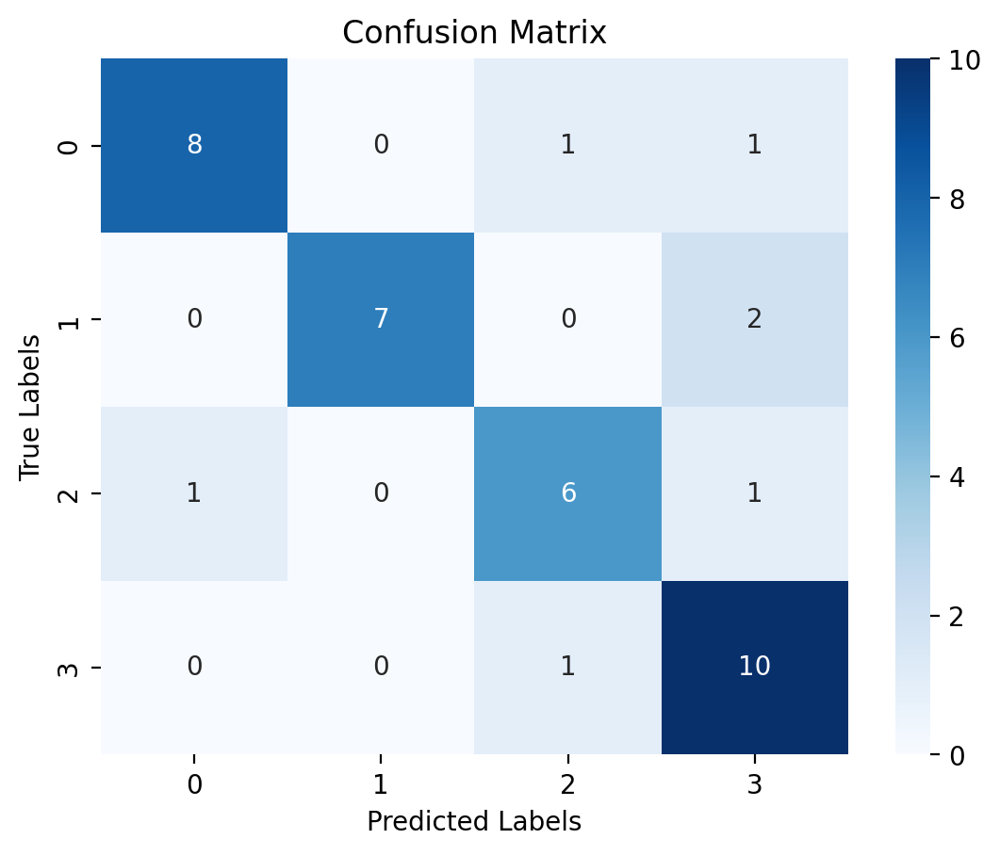

In [186]:
plot_confusion_matrix(y_test, y_pred)

### 3.4.3 Random Forest Doc2Vec Method 2

In [187]:
X_train, X_test, y_train, y_test = X_m2d_train, X_m2d_test, y_m2d_train, y_m2d_test

for n_estimators in [5, 10, 20, 50, 100, 200, 400]:
  model_rf = RandomForestClassifier(n_estimators = n_estimators, random_state = random_seed)
  model_rf.fit(X_train, y_train)
  y_pred = model_rf.predict(X_test)
  acc = accuracy_score(y_test, y_pred) 
  print(f"Estimators: {n_estimators}, Accuracy: {acc}")


# Best performing is n_estimators 400

Estimators: 5, Accuracy: 0.47368421052631576
Estimators: 10, Accuracy: 0.631578947368421
Estimators: 20, Accuracy: 0.5526315789473685
Estimators: 50, Accuracy: 0.5789473684210527
Estimators: 100, Accuracy: 0.631578947368421
Estimators: 200, Accuracy: 0.6052631578947368
Estimators: 400, Accuracy: 0.6052631578947368


In [188]:
# Best performing is n_estimators 400

rf_m2d_best = RandomForestClassifier(n_estimators = 400, random_state = random_seed)
rf_m2d_best.fit(X_train, y_train)
y_pred = rf_m2d_best.predict(X_test)
y_pred_proba = rf_m2d_best.predict_proba(X_test)
acc = accuracy_score(y_test, y_pred)
print(acc)
print(classification_report(y_test, y_pred))

y_pred_rf_m2d_best = y_pred.copy()
y_prob_rf_m2d_best = y_pred_proba.copy()

0.6052631578947368
              precision    recall  f1-score   support

      Action       0.60      0.90      0.72        10
      Comedy       1.00      0.44      0.62         9
      Horror       0.40      0.25      0.31         8
      Sci-Fi       0.57      0.73      0.64        11

    accuracy                           0.61        38
   macro avg       0.64      0.58      0.57        38
weighted avg       0.64      0.61      0.59        38



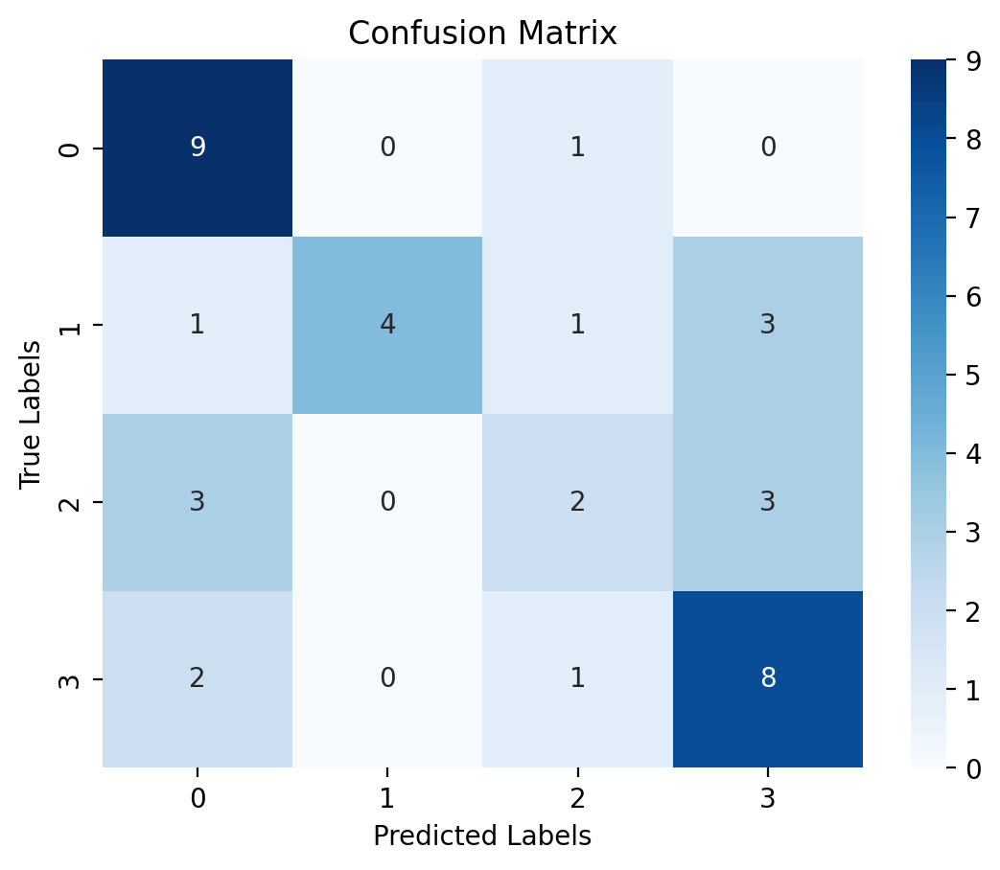

In [189]:
plot_confusion_matrix(y_test, y_pred)

### 3.4.4 Ensemble!

In [190]:
print(y_prob_rf_m2d_best)
print(y_pred_rf_m2d_best)

[[0.72   0.0325 0.1075 0.14  ]
 [0.405  0.035  0.315  0.245 ]
 [0.0725 0.0925 0.28   0.555 ]
 [0.125  0.07   0.3375 0.4675]
 [0.6375 0.095  0.185  0.0825]
 [0.0475 0.2975 0.3325 0.3225]
 [0.2775 0.0475 0.2475 0.4275]
 [0.415  0.225  0.1125 0.2475]
 [0.25   0.2625 0.2175 0.27  ]
 [0.4575 0.2225 0.18   0.14  ]
 [0.5775 0.0825 0.1975 0.1425]
 [0.0875 0.06   0.59   0.2625]
 [0.32   0.1875 0.155  0.3375]
 [0.275  0.0625 0.4125 0.25  ]
 [0.0475 0.0825 0.1775 0.6925]
 [0.055  0.0925 0.425  0.4275]
 [0.4975 0.155  0.065  0.2825]
 [0.1275 0.215  0.3    0.3575]
 [0.38   0.175  0.2875 0.1575]
 [0.33   0.07   0.2    0.4   ]
 [0.455  0.1225 0.12   0.3025]
 [0.535  0.1225 0.205  0.1375]
 [0.145  0.1125 0.255  0.4875]
 [0.04   0.8625 0.0525 0.045 ]
 [0.4125 0.085  0.3225 0.18  ]
 [0.36   0.065  0.3425 0.2325]
 [0.0375 0.0675 0.1375 0.7575]
 [0.2675 0.3625 0.195  0.175 ]
 [0.3975 0.315  0.11   0.1775]
 [0.145  0.095  0.4025 0.3575]
 [0.02   0.945  0.0175 0.0175]
 [0.3475 0.135  0.3725 0.145 ]
 [0.015 

In [191]:
# Aggregate the predicted probabilities
y_prob1, y_prob2, y_prob3 = y_prob_svm_m2d_best, y_prob_log_m2d_best, y_prob_rf_m2d_best
y_prob_ensemble = (y_prob1 + y_prob2 + y_prob3) / 3

categories = np.array(["Action", "Comedy", "Horror", "Sci-Fi"])
max_indices = np.argmax(y_prob_ensemble, axis=1)
y_pred_ensemble = categories[max_indices]

print(y_pred_ensemble)

['Action' 'Sci-Fi' 'Sci-Fi' 'Sci-Fi' 'Action' 'Comedy' 'Sci-Fi' 'Action'
 'Comedy' 'Comedy' 'Action' 'Horror' 'Sci-Fi' 'Horror' 'Sci-Fi' 'Sci-Fi'
 'Action' 'Sci-Fi' 'Horror' 'Sci-Fi' 'Action' 'Sci-Fi' 'Horror' 'Comedy'
 'Horror' 'Sci-Fi' 'Sci-Fi' 'Comedy' 'Action' 'Action' 'Comedy' 'Horror'
 'Comedy' 'Sci-Fi' 'Action' 'Horror' 'Sci-Fi' 'Action']


In [192]:
print(y_prob_ensemble)
print(y_pred_ensemble)

[[0.835412   0.01666176 0.03966034 0.10826591]
 [0.40119485 0.02796833 0.13577117 0.43506565]
 [0.06769312 0.07171905 0.28697632 0.57361151]
 [0.06669387 0.02798692 0.13004715 0.77527205]
 [0.56082228 0.10531432 0.13643631 0.19742709]
 [0.03490881 0.49425897 0.27196472 0.19886749]
 [0.14209284 0.02286217 0.10010103 0.73494395]
 [0.7539939  0.07813585 0.03876126 0.12910902]
 [0.16400168 0.47908761 0.20607201 0.15083867]
 [0.2893122  0.37401076 0.181696   0.15498107]
 [0.80833456 0.02940627 0.07645431 0.0858049 ]
 [0.04748293 0.1164099  0.56545385 0.27065332]
 [0.18095061 0.08181721 0.05618708 0.6810451 ]
 [0.12732624 0.07846945 0.46043168 0.33377262]
 [0.1189234  0.05934776 0.1796247  0.64210414]
 [0.04154002 0.06579949 0.27363711 0.61902339]
 [0.55199008 0.08321042 0.11116165 0.25363786]
 [0.07019134 0.31931215 0.16025954 0.45023696]
 [0.2588285  0.09318706 0.51142028 0.13656418]
 [0.17581808 0.03963942 0.11041227 0.67413023]
 [0.7116818  0.04901665 0.05059149 0.18871008]
 [0.31681306 

In [193]:
acc = accuracy_score(y_test, y_pred_ensemble)
print(acc)
print(classification_report(y_test, y_pred_ensemble))


0.8421052631578947
              precision    recall  f1-score   support

      Action       0.90      0.90      0.90        10
      Comedy       1.00      0.78      0.88         9
      Horror       0.86      0.75      0.80         8
      Sci-Fi       0.71      0.91      0.80        11

    accuracy                           0.84        38
   macro avg       0.87      0.83      0.84        38
weighted avg       0.86      0.84      0.84        38



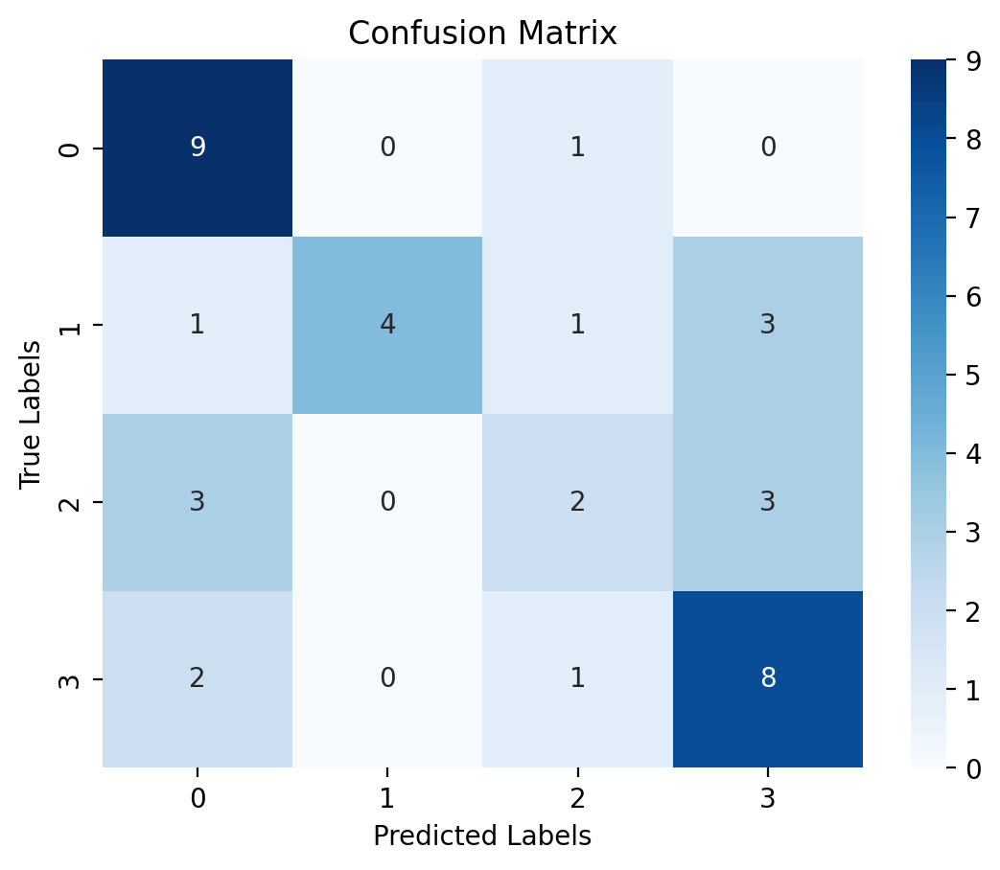

In [194]:
plot_confusion_matrix(y_test, y_pred)

# 5. LSA and LDA

## 5.1 LSA

Ok so the thing here is you identify the number of concepts and the number of words.  So let's make this fun:

* 2 or 4 concepts
* 2, 4, 6, 8, 10, 20 words

### 5.1.1 LSA on the M2 Processed Text

[(0, '0.503*"movi" + 0.166*"charact"'), (1, '-0.453*"holm" + -0.410*"watson"')]


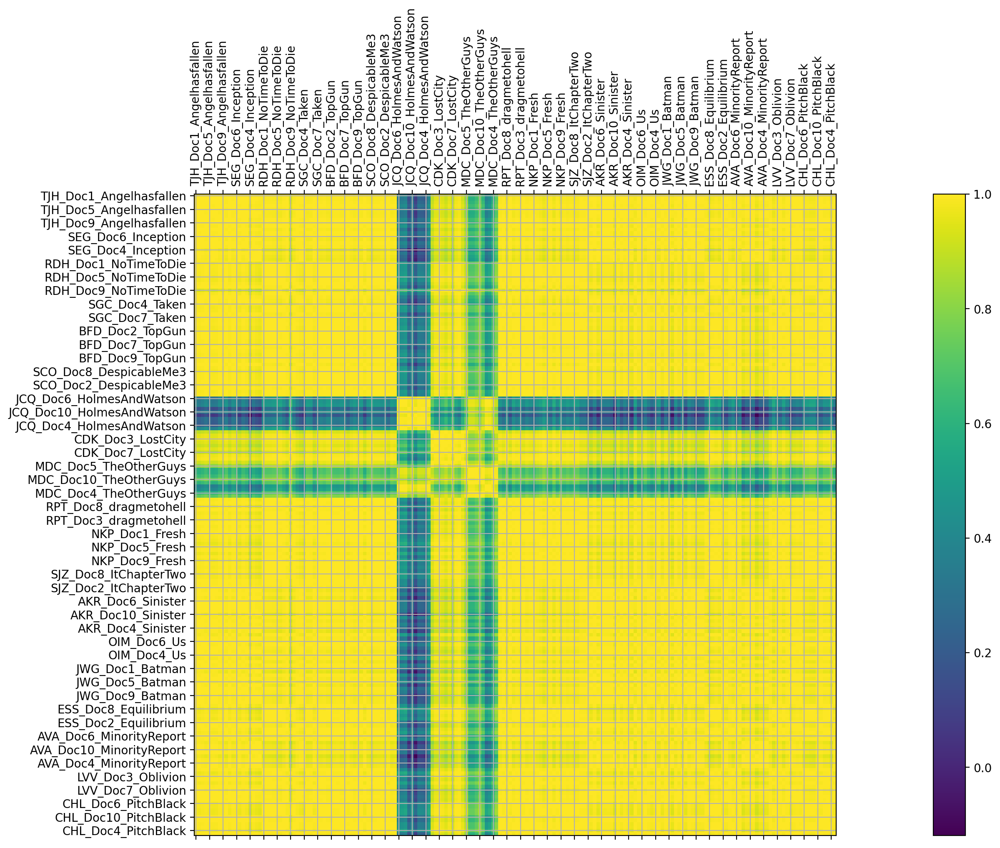

In [195]:
model_2concepts_2words=plot_lsa(processed_text_m2, 2, 2)

[(0, '0.503*"movi" + 0.166*"charact" + 0.146*"film" + 0.138*"stori"'), (1, '-0.453*"holm" + -0.410*"watson" + -0.398*"ferrel" + -0.257*"reilli"')]


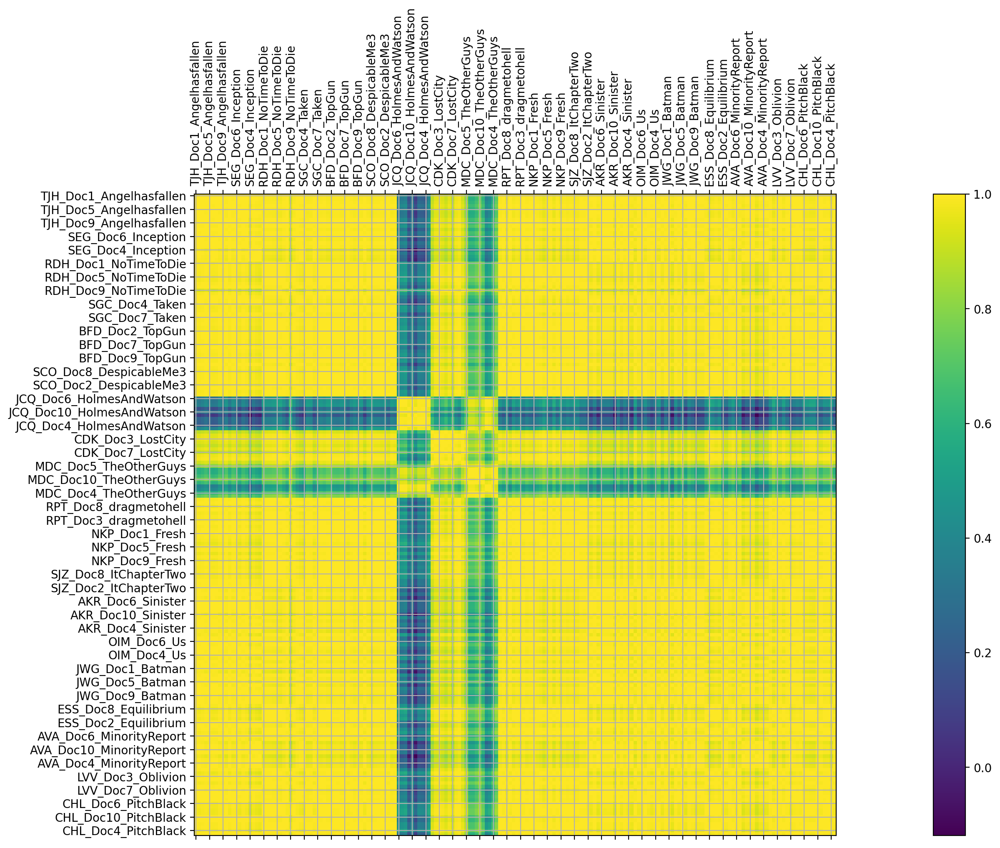

In [196]:
model_2concepts_4words=plot_lsa(processed_text_m2, 2, 4)

[(0, '0.503*"movi" + 0.166*"charact" + 0.146*"film" + 0.138*"stori" + 0.124*"first" + 0.122*"ferrel"'), (1, '-0.453*"holm" + -0.410*"watson" + -0.398*"ferrel" + -0.257*"reilli" + -0.241*"comedi" + -0.154*"humor"')]


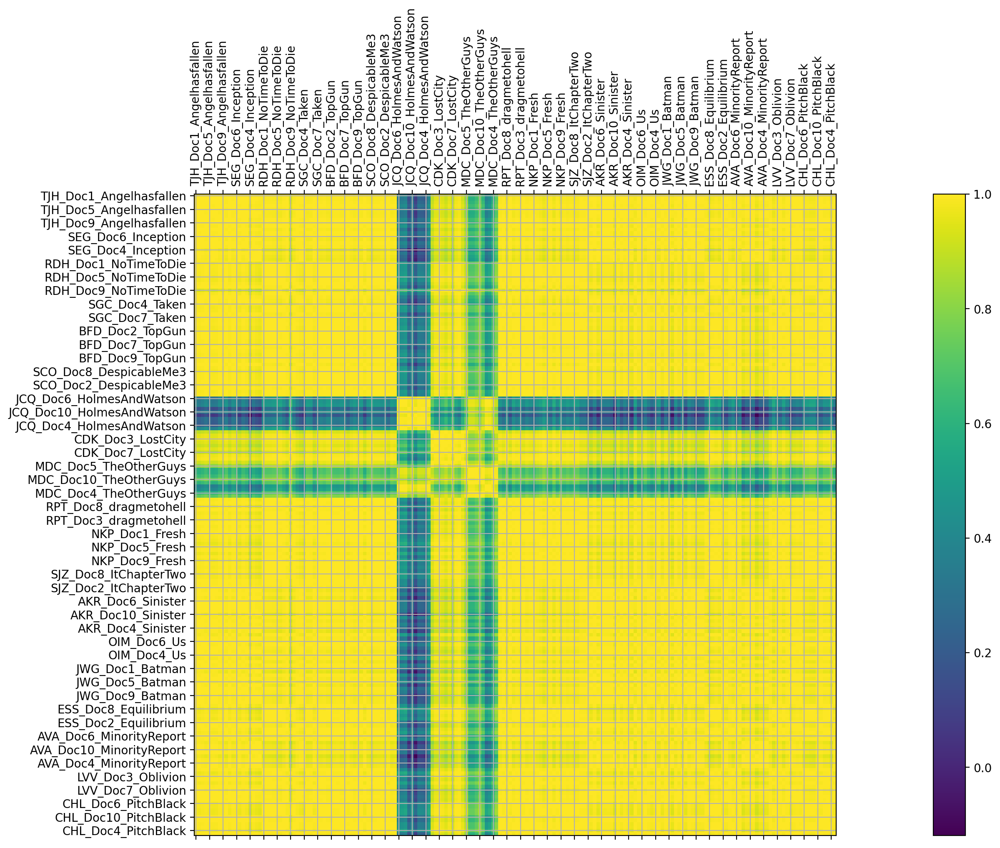

In [197]:
model_2concepts_6words=plot_lsa(processed_text_m2, 2, 6)

[(0, '0.503*"movi" + 0.166*"charact" + 0.146*"film" + 0.138*"stori" + 0.124*"first" + 0.122*"ferrel" + 0.114*"holm" + 0.103*"watson"'), (1, '-0.453*"holm" + -0.410*"watson" + -0.398*"ferrel" + -0.257*"reilli" + -0.241*"comedi" + -0.154*"humor" + 0.092*"batman" + -0.092*"laugh"')]


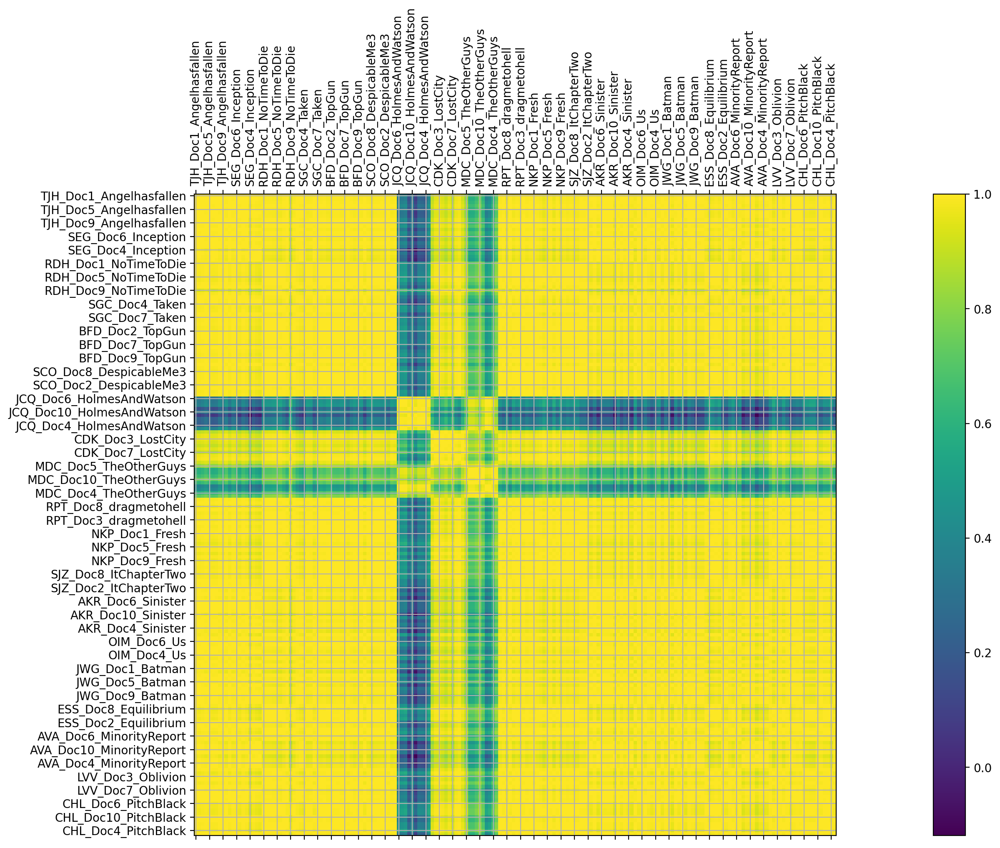

In [198]:
model_2concepts_8words=plot_lsa(processed_text_m2, 2, 8)

[(0, '0.503*"movi" + 0.166*"charact" + 0.146*"film" + 0.138*"stori" + 0.124*"first" + 0.122*"ferrel" + 0.114*"holm" + 0.103*"watson" + 0.101*"thing" + 0.101*"make"'), (1, '-0.453*"holm" + -0.410*"watson" + -0.398*"ferrel" + -0.257*"reilli" + -0.241*"comedi" + -0.154*"humor" + 0.092*"batman" + -0.092*"laugh" + -0.083*"joke" + 0.077*"first"')]


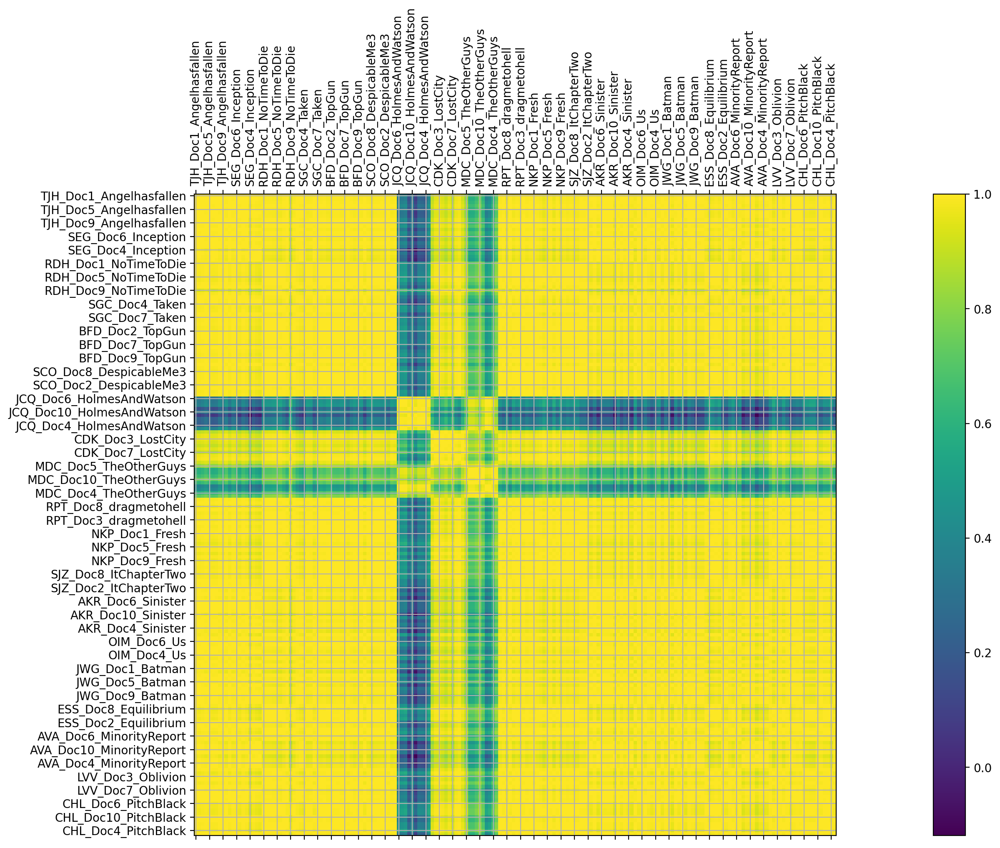

In [199]:
model_2concepts_10words=plot_lsa(processed_text_m2, 2, 10)

[(0, '0.503*"movi" + 0.166*"charact" + 0.146*"film" + 0.138*"stori" + 0.124*"first" + 0.122*"ferrel" + 0.114*"holm" + 0.103*"watson" + 0.101*"thing" + 0.101*"make" + 0.099*"scene" + 0.096*"play" + 0.090*"would" + 0.088*"comedi" + 0.088*"batman" + 0.087*"there" + 0.087*"action" + 0.082*"feel" + 0.078*"doesnt" + 0.077*"realli"'), (1, '-0.453*"holm" + -0.410*"watson" + -0.398*"ferrel" + -0.257*"reilli" + -0.241*"comedi" + -0.154*"humor" + 0.092*"batman" + -0.092*"laugh" + -0.083*"joke" + 0.077*"first" + 0.071*"dream" + -0.070*"involv" + -0.070*"sherlock" + 0.069*"nolan" + -0.069*"funni" + 0.066*"ellison" + 0.063*"stori" + 0.063*"famili" + 0.061*"horror" + -0.057*"queen"')]


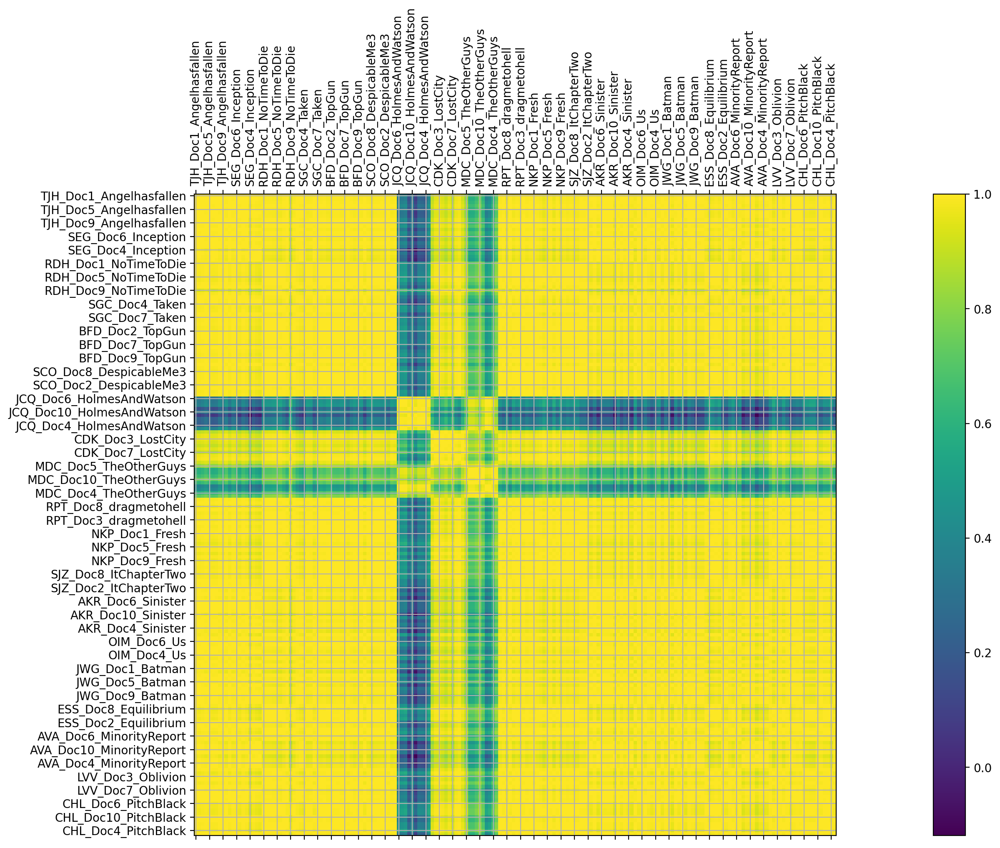

In [200]:
model_2concepts_20words=plot_lsa(processed_text_m2, 2, 20)

[(0, '0.503*"movi" + 0.166*"charact"'), (1, '0.453*"holm" + 0.410*"watson"'), (2, '0.420*"batman" + 0.377*"nolan"'), (3, '-0.621*"movi" + 0.167*"anderton"')]


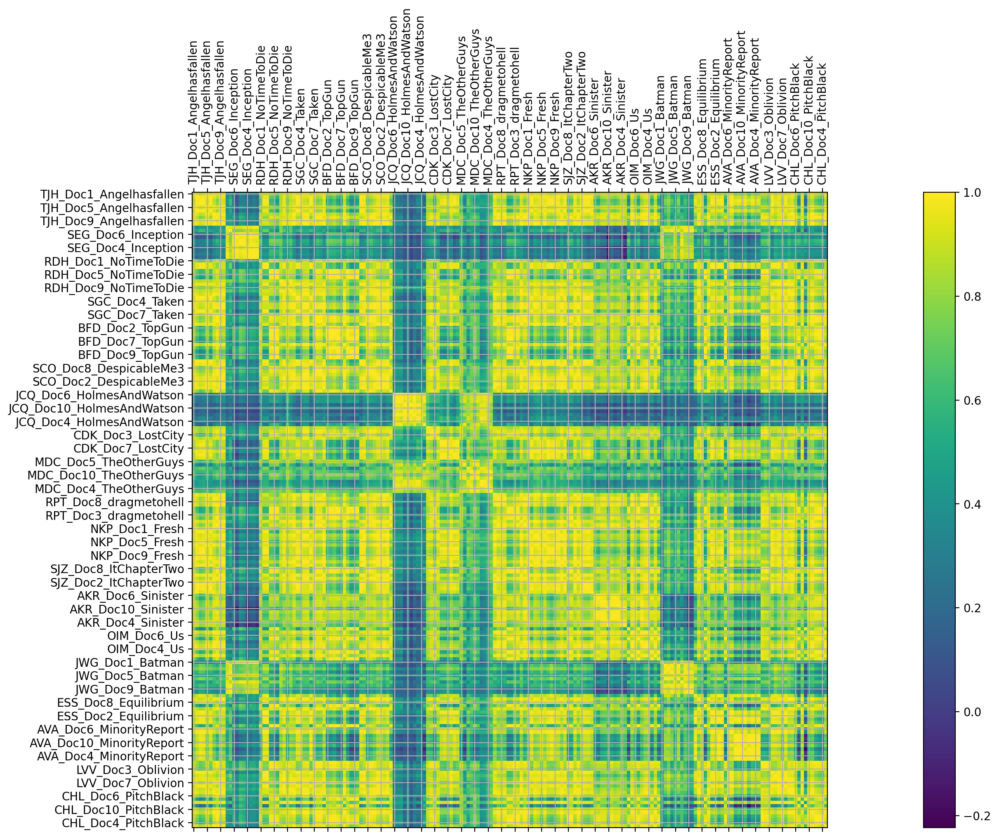

In [201]:
model_4concepts_2words=plot_lsa(processed_text_m2, 4, 2)

[(0, '0.503*"movi" + 0.166*"charact" + 0.146*"film" + 0.138*"stori"'), (1, '0.453*"holm" + 0.410*"watson" + 0.398*"ferrel" + 0.257*"reilli"'), (2, '-0.420*"batman" + -0.377*"nolan" + -0.364*"dream" + -0.315*"incept"'), (3, '0.621*"movi" + -0.167*"anderton" + -0.164*"film" + -0.162*"batman"')]


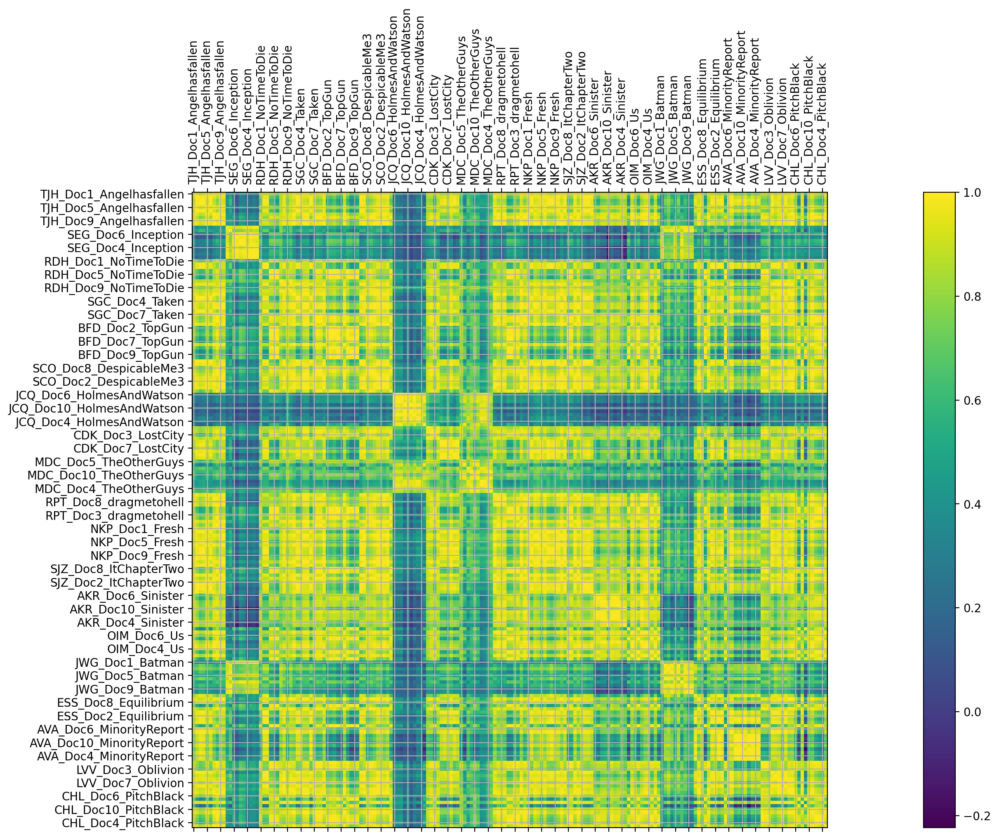

In [202]:
model_4concepts_4words=plot_lsa(processed_text_m2, 4, 4)

[(0, '0.503*"movi" + 0.166*"charact" + 0.146*"film" + 0.138*"stori" + 0.124*"first" + 0.122*"ferrel"'), (1, '-0.453*"holm" + -0.410*"watson" + -0.398*"ferrel" + -0.257*"reilli" + -0.241*"comedi" + -0.154*"humor"'), (2, '-0.420*"batman" + -0.377*"nolan" + -0.364*"dream" + -0.315*"incept" + 0.182*"ellison" + 0.124*"horror"'), (3, '0.621*"movi" + -0.167*"anderton" + -0.164*"film" + -0.162*"batman" + -0.138*"stori" + -0.129*"charact"')]


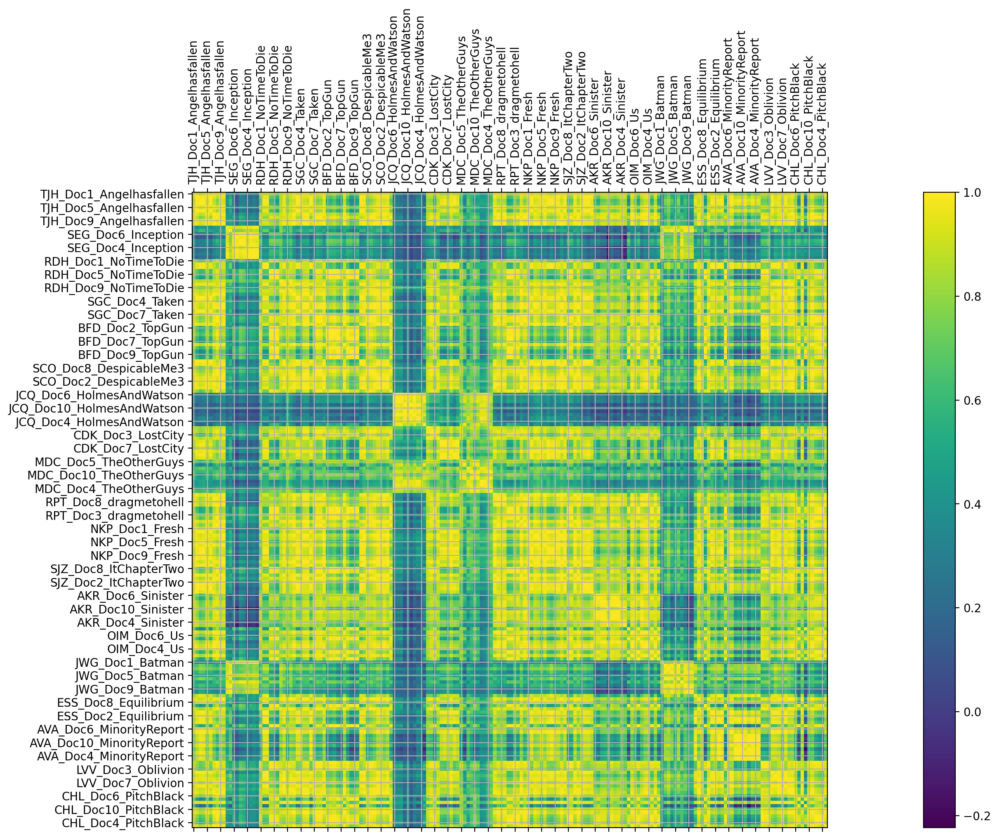

In [203]:
model_4concepts_6words=plot_lsa(processed_text_m2, 4, 6)

[(0, '0.503*"movi" + 0.166*"charact" + 0.146*"film" + 0.138*"stori" + 0.124*"first" + 0.122*"ferrel" + 0.114*"holm" + 0.103*"watson"'), (1, '-0.453*"holm" + -0.410*"watson" + -0.398*"ferrel" + -0.257*"reilli" + -0.241*"comedi" + -0.154*"humor" + 0.092*"batman" + -0.092*"laugh"'), (2, '-0.420*"batman" + -0.377*"nolan" + -0.364*"dream" + -0.315*"incept" + 0.182*"ellison" + 0.124*"horror" + -0.114*"christoph" + -0.106*"reef"'), (3, '0.621*"movi" + -0.167*"anderton" + -0.164*"film" + -0.162*"batman" + -0.138*"stori" + -0.129*"charact" + 0.116*"riddick" + -0.116*"murder"')]


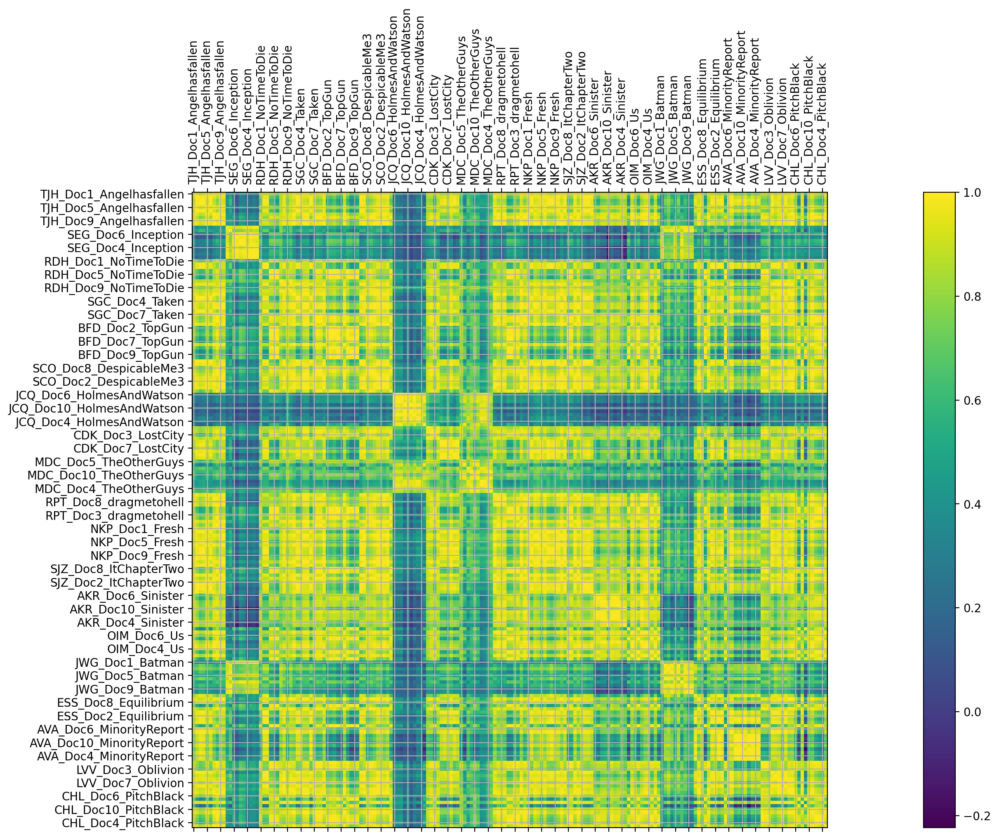

In [204]:
model_4concepts_8words=plot_lsa(processed_text_m2, 4, 8)

[(0, '0.503*"movi" + 0.166*"charact" + 0.146*"film" + 0.138*"stori" + 0.124*"first" + 0.122*"ferrel" + 0.114*"holm" + 0.103*"watson" + 0.101*"thing" + 0.101*"make"'), (1, '-0.453*"holm" + -0.410*"watson" + -0.398*"ferrel" + -0.257*"reilli" + -0.241*"comedi" + -0.154*"humor" + 0.092*"batman" + -0.092*"laugh" + -0.083*"joke" + 0.077*"first"'), (2, '0.420*"batman" + 0.377*"nolan" + 0.364*"dream" + 0.315*"incept" + -0.182*"ellison" + -0.124*"horror" + 0.114*"christoph" + 0.106*"reef" + 0.105*"movi" + -0.105*"sinist"'), (3, '0.621*"movi" + -0.167*"anderton" + -0.164*"film" + -0.162*"batman" + -0.138*"stori" + -0.129*"charact" + 0.116*"riddick" + -0.116*"murder" + -0.113*"precrim" + -0.104*"precog"')]


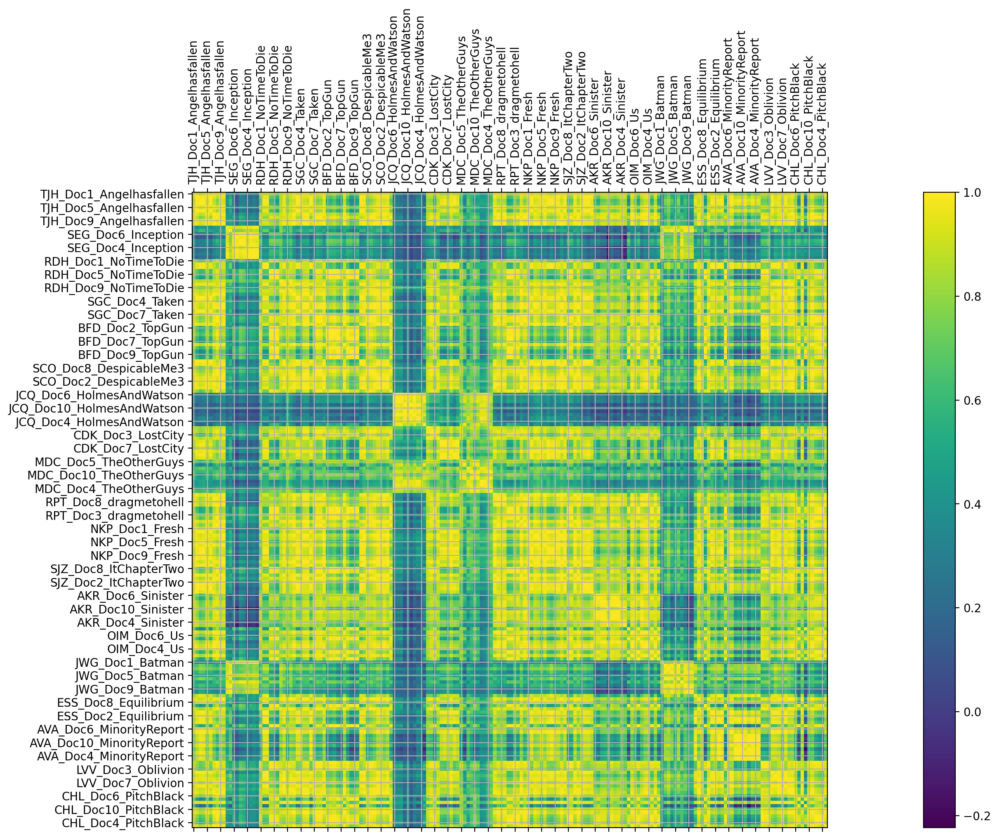

In [205]:
model_4concepts_10words=plot_lsa(processed_text_m2, 4, 10)

[(0, '0.503*"movi" + 0.166*"charact" + 0.146*"film" + 0.138*"stori" + 0.124*"first" + 0.122*"ferrel" + 0.114*"holm" + 0.103*"watson" + 0.101*"thing" + 0.101*"make" + 0.099*"scene" + 0.096*"play" + 0.090*"would" + 0.088*"comedi" + 0.088*"batman" + 0.087*"there" + 0.087*"action" + 0.082*"feel" + 0.078*"doesnt" + 0.077*"realli"'), (1, '0.453*"holm" + 0.410*"watson" + 0.398*"ferrel" + 0.257*"reilli" + 0.241*"comedi" + 0.154*"humor" + -0.092*"batman" + 0.092*"laugh" + 0.083*"joke" + -0.077*"first" + -0.071*"dream" + 0.070*"involv" + 0.070*"sherlock" + -0.069*"nolan" + 0.069*"funni" + -0.066*"ellison" + -0.063*"stori" + -0.063*"famili" + -0.061*"horror" + 0.057*"queen"'), (2, '-0.420*"batman" + -0.377*"nolan" + -0.364*"dream" + -0.315*"incept" + 0.182*"ellison" + 0.124*"horror" + -0.114*"christoph" + -0.106*"reef" + -0.105*"movi" + 0.105*"sinist" + 0.102*"famili" + 0.099*"hous" + -0.099*"knight" + -0.081*"within" + -0.070*"gotham" + 0.066*"first" + -0.063*"dicaprio" + 0.062*"fallen" + 0.061*

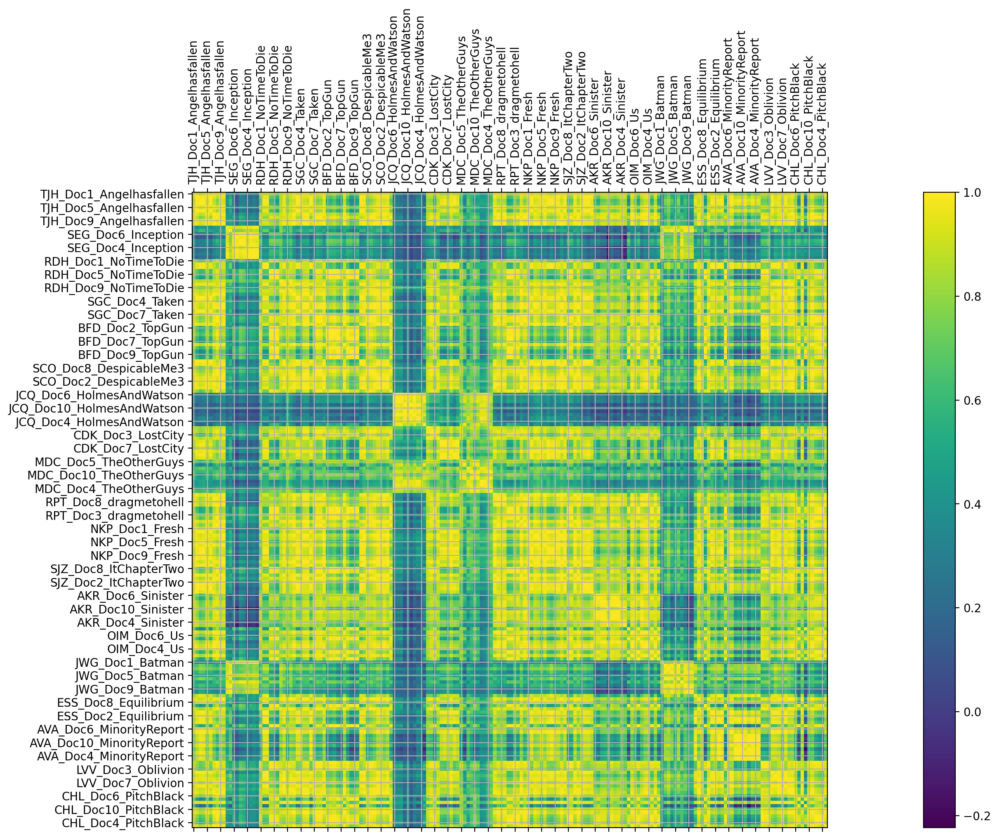

In [206]:
model_4concepts_20words=plot_lsa(processed_text_m2, 4, 20)

[(0, '-0.503*"movi" + -0.166*"charact" + -0.146*"film" + -0.138*"stori" + -0.124*"first" + -0.122*"ferrel" + -0.114*"holm" + -0.103*"watson" + -0.101*"thing" + -0.101*"make"'), (1, '0.453*"holm" + 0.410*"watson" + 0.398*"ferrel" + 0.257*"reilli" + 0.241*"comedi" + 0.154*"humor" + -0.092*"batman" + 0.092*"laugh" + 0.083*"joke" + -0.077*"first"'), (2, '-0.420*"batman" + -0.377*"nolan" + -0.364*"dream" + -0.315*"incept" + 0.182*"ellison" + 0.124*"horror" + -0.114*"christoph" + -0.106*"reef" + -0.105*"movi" + 0.105*"sinist"'), (3, '0.621*"movi" + -0.167*"anderton" + -0.164*"film" + -0.162*"batman" + -0.138*"stori" + -0.129*"charact" + 0.116*"riddick" + -0.116*"murder" + -0.113*"precrim" + -0.104*"precog"'), (4, '-0.369*"ellison" + -0.295*"batman" + 0.258*"presid" + 0.253*"fallen" + 0.213*"ban" + -0.196*"famili" + -0.189*"sinist" + -0.185*"horror" + 0.144*"angel" + -0.121*"hous"'), (5, '-0.254*"dream" + -0.250*"ellison" + -0.233*"presid" + -0.227*"fallen" + -0.197*"incept" + -0.184*"ban" + 

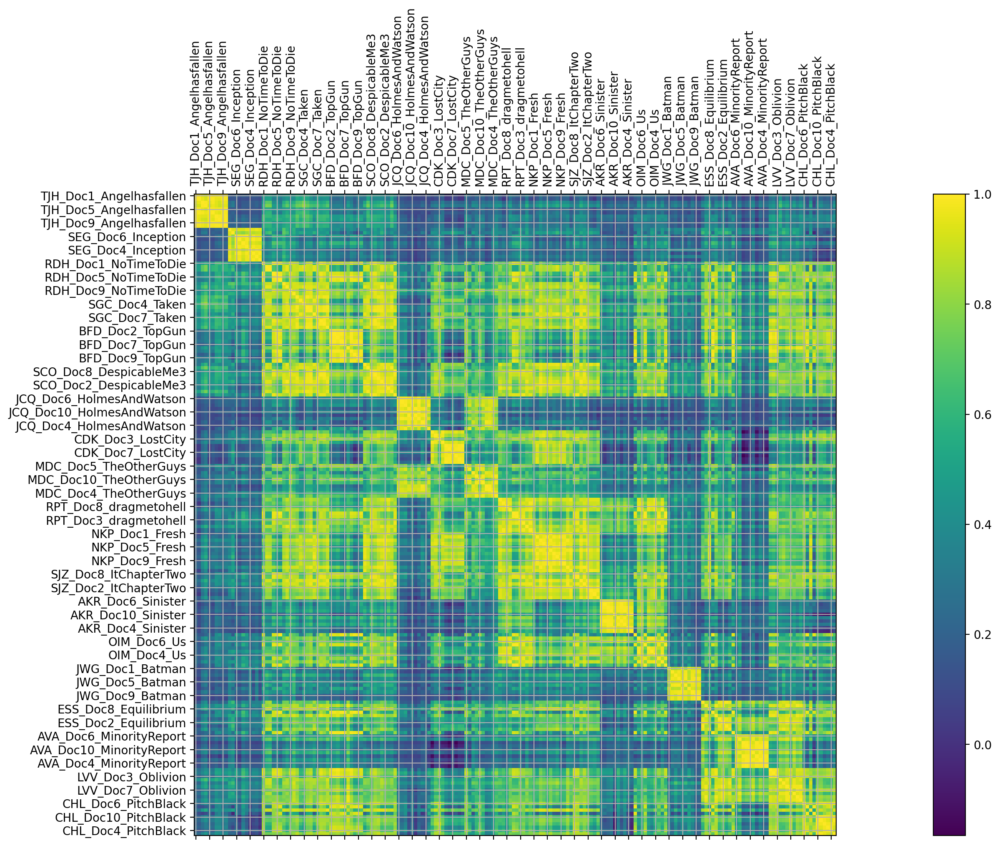

In [207]:
model_4concepts_10words=plot_lsa(processed_text_m2, 8, 10)

[(0, '-0.503*"movi" + -0.166*"charact" + -0.146*"film" + -0.138*"stori" + -0.124*"first" + -0.122*"ferrel" + -0.114*"holm" + -0.103*"watson" + -0.101*"thing" + -0.101*"make"'), (1, '-0.453*"holm" + -0.410*"watson" + -0.398*"ferrel" + -0.257*"reilli" + -0.241*"comedi" + -0.154*"humor" + 0.092*"batman" + -0.092*"laugh" + -0.083*"joke" + 0.077*"first"'), (2, '-0.420*"batman" + -0.377*"nolan" + -0.364*"dream" + -0.315*"incept" + 0.182*"ellison" + 0.124*"horror" + -0.114*"christoph" + -0.106*"reef" + -0.105*"movi" + 0.105*"sinist"'), (3, '-0.621*"movi" + 0.167*"anderton" + 0.164*"film" + 0.162*"batman" + 0.138*"stori" + 0.129*"charact" + -0.116*"riddick" + 0.116*"murder" + 0.113*"precrim" + 0.104*"precog"'), (4, '0.369*"ellison" + 0.295*"batman" + -0.258*"presid" + -0.253*"fallen" + -0.213*"ban" + 0.196*"famili" + 0.189*"sinist" + 0.185*"horror" + -0.144*"angel" + 0.121*"hous"'), (5, '0.254*"dream" + 0.250*"ellison" + 0.233*"presid" + 0.227*"fallen" + 0.197*"incept" + 0.184*"ban" + 0.175*"n

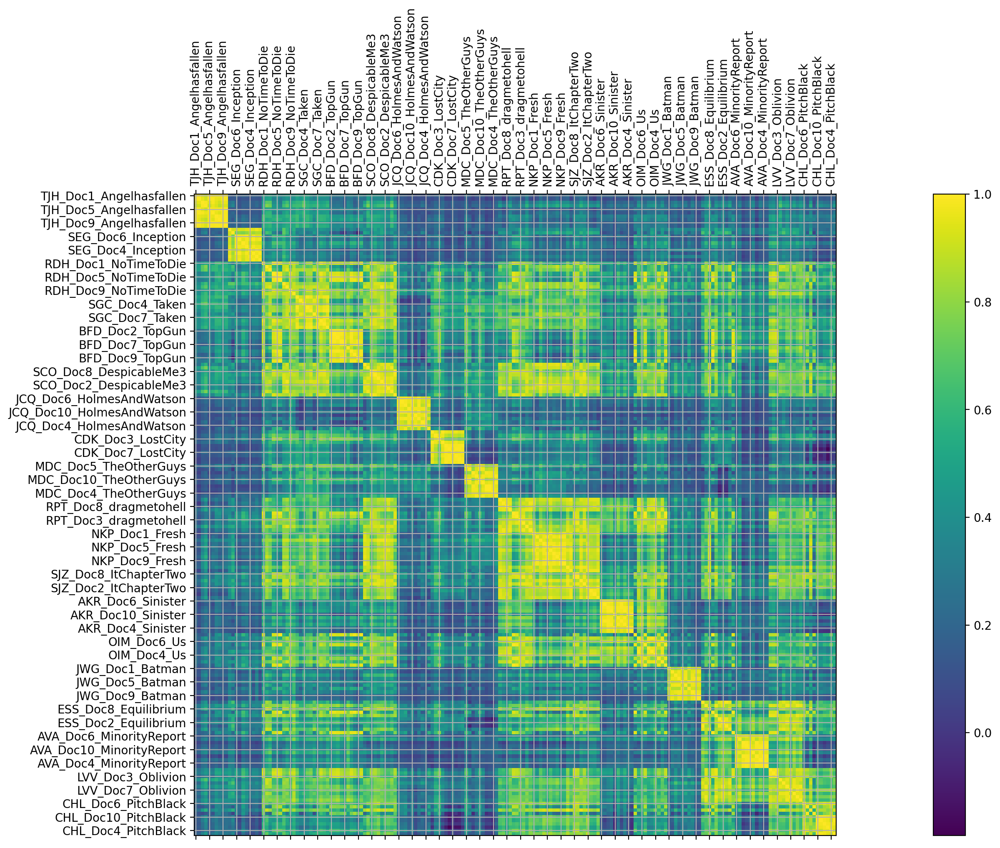

In [208]:
model_4concepts_10words=plot_lsa(processed_text_m2, 10, 10)

[(0, '-0.503*"movi" + -0.166*"charact" + -0.146*"film" + -0.138*"stori" + -0.124*"first" + -0.122*"ferrel" + -0.114*"holm" + -0.103*"watson" + -0.101*"thing" + -0.101*"make"'), (1, '-0.453*"holm" + -0.410*"watson" + -0.398*"ferrel" + -0.257*"reilli" + -0.241*"comedi" + -0.154*"humor" + 0.092*"batman" + -0.092*"laugh" + -0.083*"joke" + 0.077*"first"'), (2, '-0.420*"batman" + -0.377*"nolan" + -0.364*"dream" + -0.315*"incept" + 0.182*"ellison" + 0.124*"horror" + -0.114*"christoph" + -0.106*"reef" + -0.105*"movi" + 0.105*"sinist"'), (3, '0.621*"movi" + -0.167*"anderton" + -0.164*"film" + -0.162*"batman" + -0.138*"stori" + -0.129*"charact" + 0.116*"riddick" + -0.116*"murder" + -0.113*"precrim" + -0.104*"precog"'), (4, '-0.369*"ellison" + -0.295*"batman" + 0.258*"presid" + 0.253*"fallen" + 0.213*"ban" + -0.196*"famili" + -0.189*"sinist" + -0.185*"horror" + 0.144*"angel" + -0.121*"hous"'), (5, '-0.254*"dream" + -0.250*"ellison" + -0.233*"presid" + -0.227*"fallen" + -0.197*"incept" + -0.184*"b

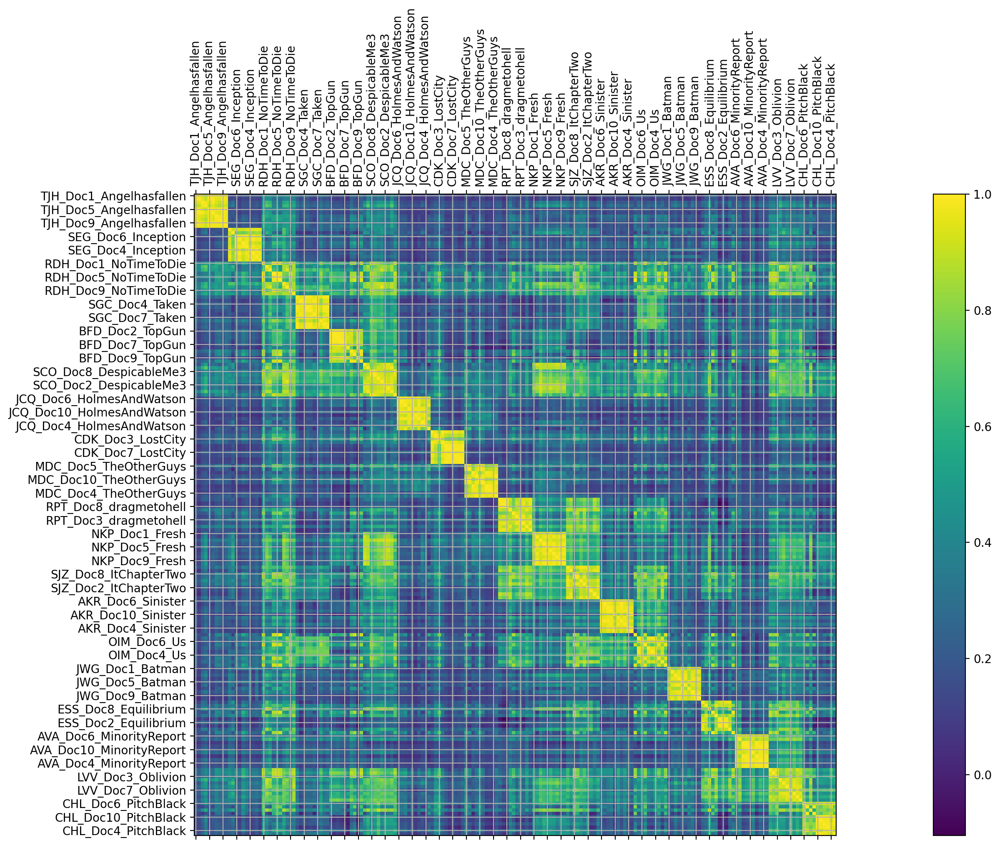

In [209]:
model_4concepts_10words=plot_lsa(processed_text_m2, 14, 10)


[(0, '-0.503*"movi" + -0.166*"charact" + -0.146*"film" + -0.138*"stori" + -0.124*"first" + -0.122*"ferrel" + -0.114*"holm" + -0.103*"watson" + -0.101*"thing" + -0.101*"make"'), (1, '-0.453*"holm" + -0.410*"watson" + -0.398*"ferrel" + -0.257*"reilli" + -0.241*"comedi" + -0.154*"humor" + 0.092*"batman" + -0.092*"laugh" + -0.083*"joke" + 0.077*"first"'), (2, '-0.420*"batman" + -0.377*"nolan" + -0.364*"dream" + -0.315*"incept" + 0.182*"ellison" + 0.124*"horror" + -0.114*"christoph" + -0.106*"reef" + -0.105*"movi" + 0.105*"sinist"'), (3, '-0.621*"movi" + 0.167*"anderton" + 0.164*"film" + 0.162*"batman" + 0.138*"stori" + 0.129*"charact" + -0.116*"riddick" + 0.116*"murder" + 0.113*"precrim" + 0.104*"precog"'), (4, '-0.369*"ellison" + -0.295*"batman" + 0.258*"presid" + 0.253*"fallen" + 0.213*"ban" + -0.196*"famili" + -0.189*"sinist" + -0.185*"horror" + 0.144*"angel" + -0.121*"hous"'), (5, '0.254*"dream" + 0.250*"ellison" + 0.233*"presid" + 0.227*"fallen" + 0.197*"incept" + 0.184*"ban" + 0.175*

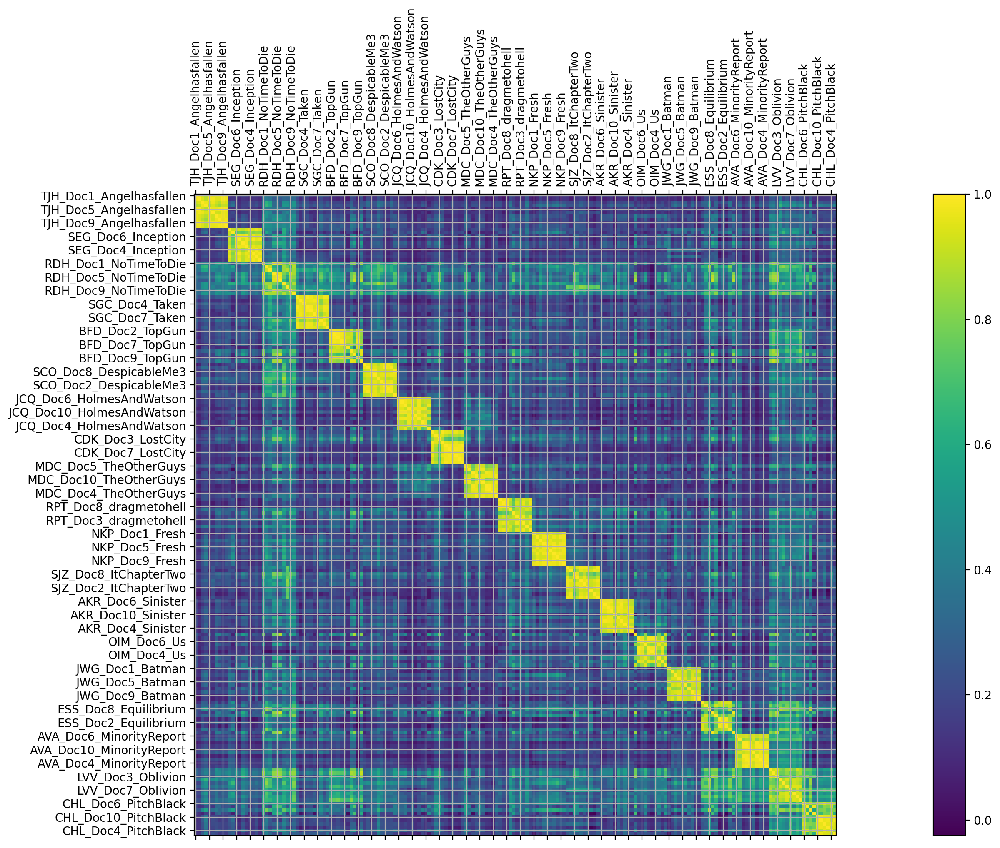

In [210]:
model_4concepts_10words=plot_lsa(processed_text_m2, 18, 10)

[(0, '-0.503*"movi" + -0.166*"charact" + -0.146*"film" + -0.138*"stori" + -0.124*"first" + -0.122*"ferrel" + -0.114*"holm" + -0.103*"watson" + -0.101*"thing" + -0.101*"make"'), (1, '0.453*"holm" + 0.410*"watson" + 0.398*"ferrel" + 0.257*"reilli" + 0.241*"comedi" + 0.154*"humor" + -0.092*"batman" + 0.092*"laugh" + 0.083*"joke" + -0.077*"first"'), (2, '-0.420*"batman" + -0.377*"nolan" + -0.364*"dream" + -0.315*"incept" + 0.182*"ellison" + 0.124*"horror" + -0.114*"christoph" + -0.106*"reef" + -0.105*"movi" + 0.105*"sinist"'), (3, '-0.621*"movi" + 0.167*"anderton" + 0.164*"film" + 0.162*"batman" + 0.138*"stori" + 0.129*"charact" + -0.116*"riddick" + 0.116*"murder" + 0.113*"precrim" + 0.104*"precog"'), (4, '0.369*"ellison" + 0.295*"batman" + -0.258*"presid" + -0.253*"fallen" + -0.213*"ban" + 0.196*"famili" + 0.189*"sinist" + 0.185*"horror" + -0.144*"angel" + 0.121*"hous"'), (5, '0.254*"dream" + 0.250*"ellison" + 0.233*"presid" + 0.227*"fallen" + 0.197*"incept" + 0.184*"ban" + 0.175*"nolan" 

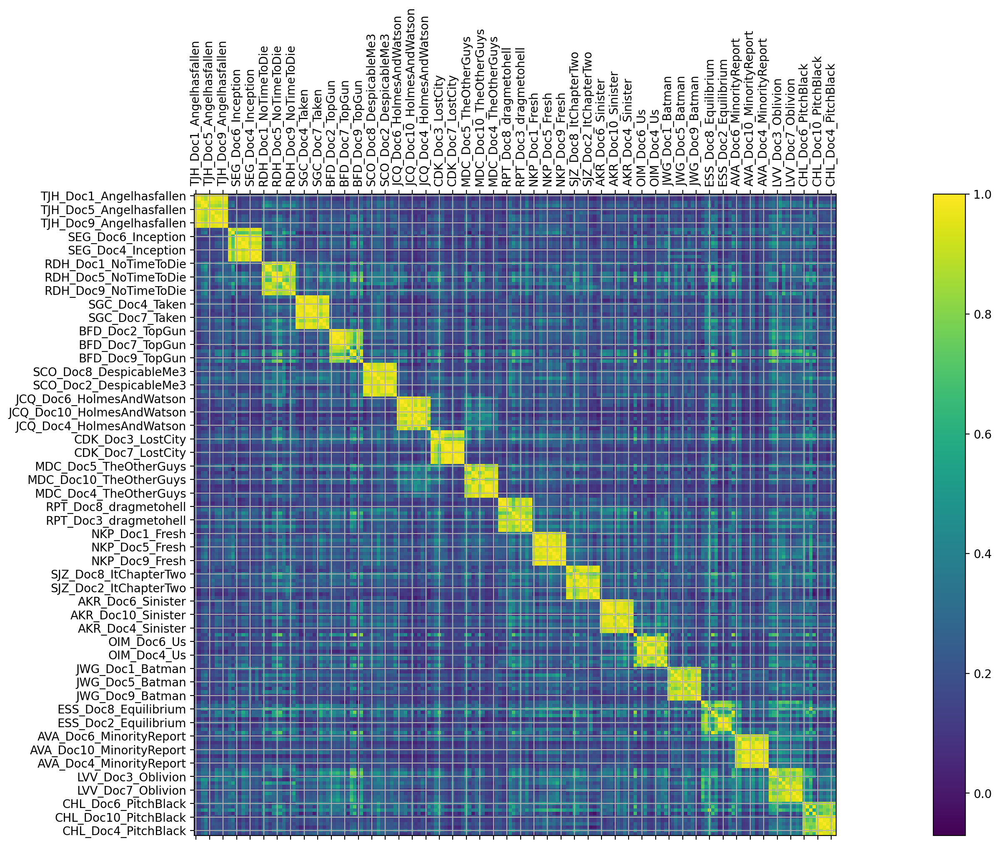

In [211]:
model_4concepts_10words=plot_lsa(processed_text_m2, 20, 10)

### 5.1.2 LSA on the M3 Processed Text

[(0, '0.205*"charact" + 0.163*"stori"'), (1, '-0.450*"holm" + -0.407*"watson"')]


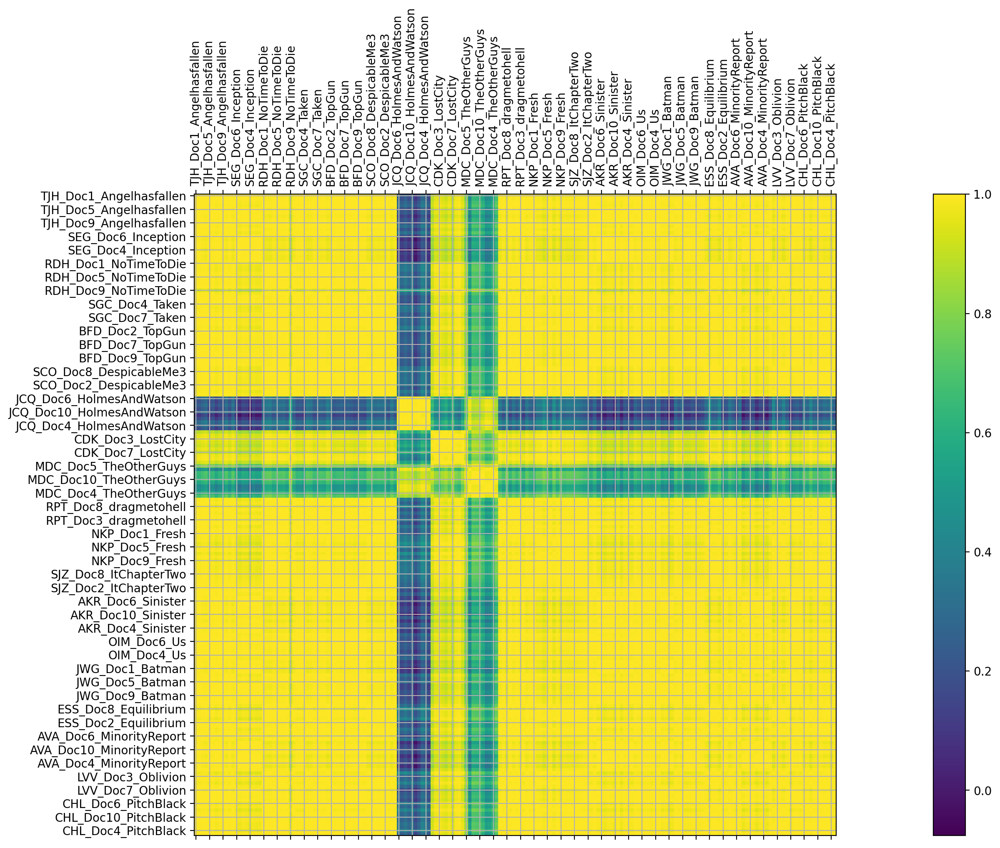

In [212]:
model_2concepts_2words_3=plot_lsa(processed_text_m3, 2, 2)

[(0, '0.205*"charact" + 0.163*"stori" + 0.147*"ferrel" + 0.140*"first"'), (1, '-0.450*"holm" + -0.407*"watson" + -0.394*"ferrel" + -0.255*"reilli"')]


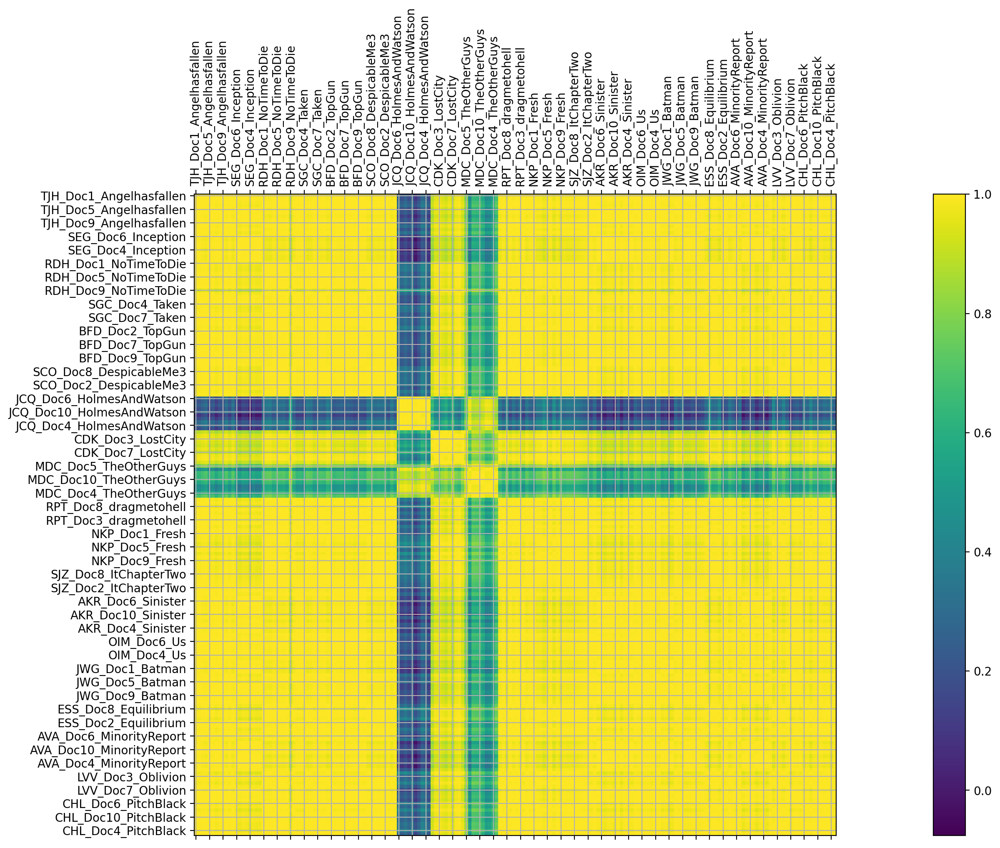

In [213]:
model_2concepts_4words_3=plot_lsa(processed_text_m3, 2, 4)

[(0, '0.205*"charact" + 0.163*"stori" + 0.147*"ferrel" + 0.140*"first" + 0.136*"holm" + 0.124*"watson"'), (1, '-0.450*"holm" + -0.407*"watson" + -0.394*"ferrel" + -0.255*"reilli" + -0.238*"comedi" + -0.152*"humor"')]


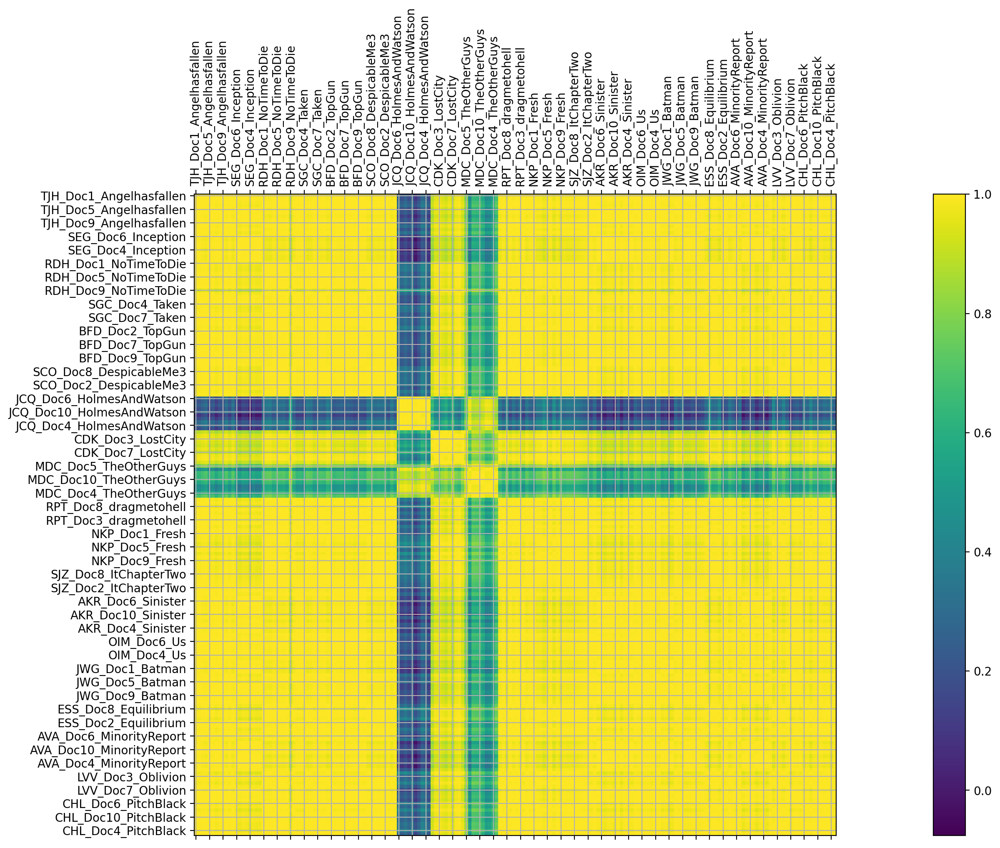

In [214]:
model_2concepts_6words_3=plot_lsa(processed_text_m3, 2, 6)

[(0, '0.205*"charact" + 0.163*"stori" + 0.147*"ferrel" + 0.140*"first" + 0.136*"holm" + 0.124*"watson" + 0.119*"make" + 0.117*"scene"'), (1, '-0.450*"holm" + -0.407*"watson" + -0.394*"ferrel" + -0.255*"reilli" + -0.238*"comedi" + -0.152*"humor" + 0.094*"batman" + -0.091*"laugh"')]


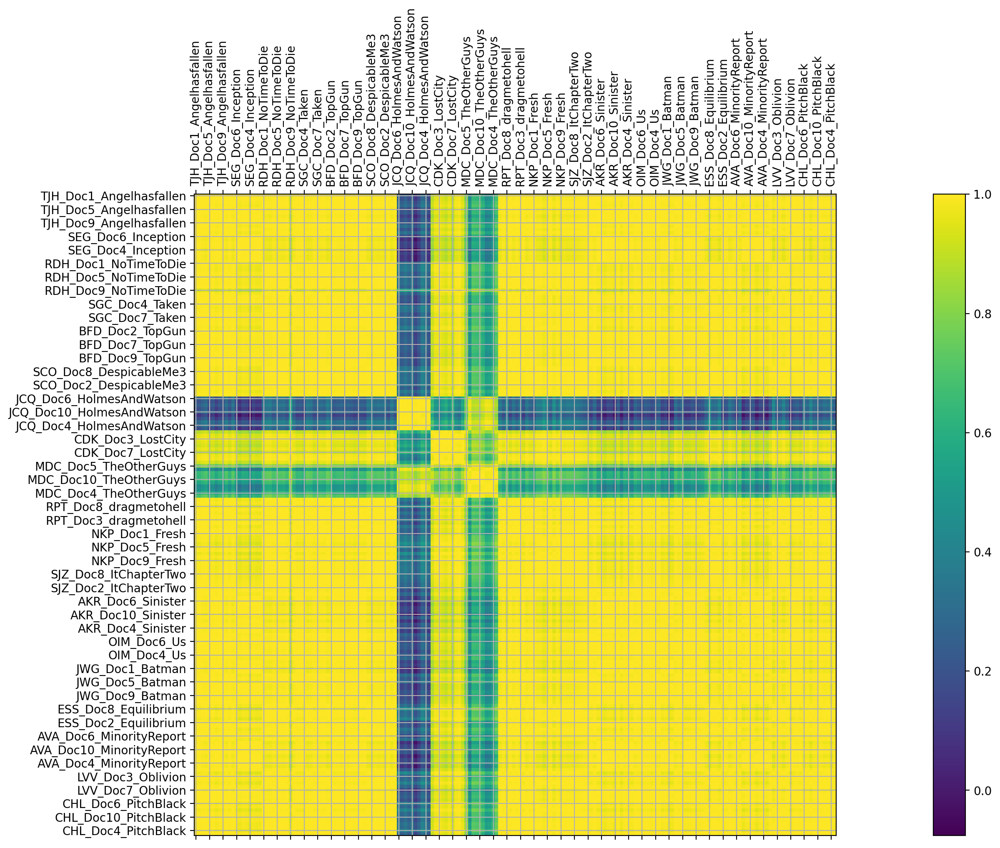

In [215]:
model_2concepts_8words_3=plot_lsa(processed_text_m3, 2, 8)

[(0, '0.205*"charact" + 0.163*"stori" + 0.147*"ferrel" + 0.140*"first" + 0.136*"holm" + 0.124*"watson" + 0.119*"make" + 0.117*"scene" + 0.116*"thing" + 0.112*"play"'), (1, '-0.450*"holm" + -0.407*"watson" + -0.394*"ferrel" + -0.255*"reilli" + -0.238*"comedi" + -0.152*"humor" + 0.094*"batman" + -0.091*"laugh" + -0.083*"joke" + 0.080*"first"')]


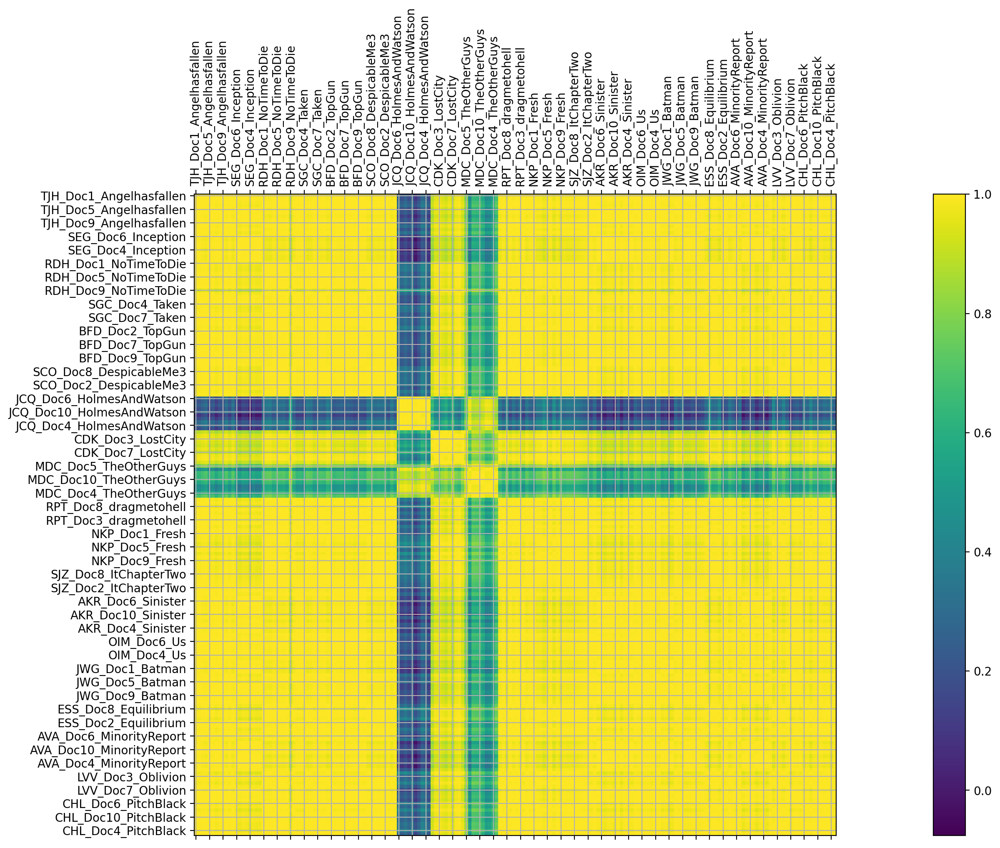

In [216]:
model_2concepts_10words_3=plot_lsa(processed_text_m3, 2, 10)

[(0, '0.205*"charact" + 0.163*"stori" + 0.147*"ferrel" + 0.140*"first" + 0.136*"holm" + 0.124*"watson" + 0.119*"make" + 0.117*"scene" + 0.116*"thing" + 0.112*"play" + 0.105*"action" + 0.104*"comedi" + 0.102*"there" + 0.101*"would" + 0.101*"batman" + 0.095*"feel" + 0.090*"doesnt" + 0.088*"someth" + 0.087*"that" + 0.086*"horror"'), (1, '-0.450*"holm" + -0.407*"watson" + -0.394*"ferrel" + -0.255*"reilli" + -0.238*"comedi" + -0.152*"humor" + 0.094*"batman" + -0.091*"laugh" + -0.083*"joke" + 0.080*"first" + 0.072*"dream" + 0.071*"nolan" + -0.070*"sherlock" + -0.069*"involv" + -0.068*"funni" + 0.067*"stori" + 0.067*"ellison" + 0.065*"famili" + 0.063*"horror" + 0.059*"world"')]


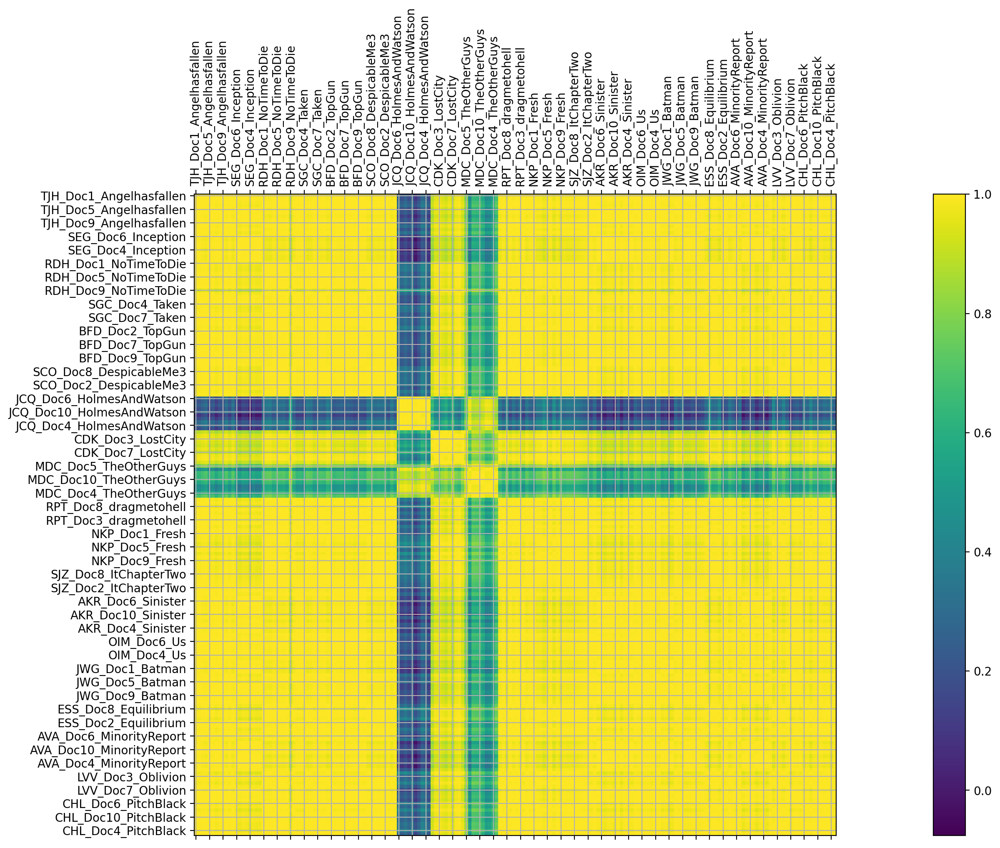

In [217]:
model_2concepts_20words_3=plot_lsa(processed_text_m3, 2, 20)

[(0, '0.205*"charact" + 0.163*"stori"'), (1, '-0.450*"holm" + -0.407*"watson"'), (2, '0.439*"batman" + 0.377*"nolan"'), (3, '0.373*"ellison" + 0.272*"batman"')]


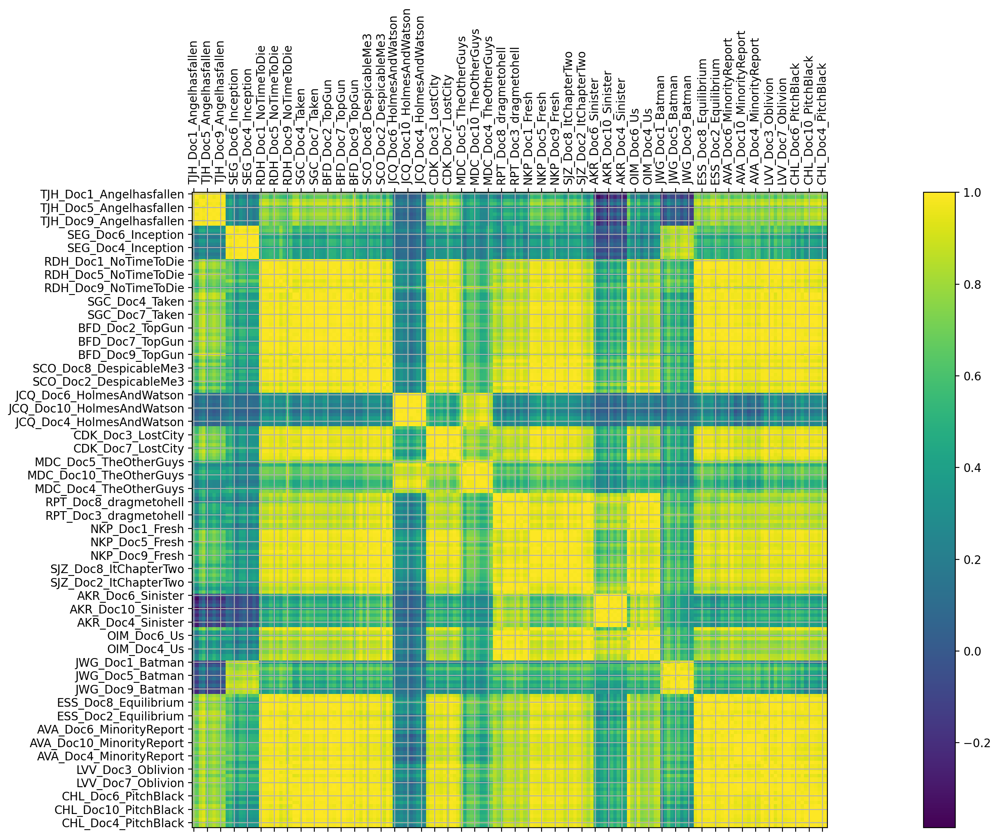

In [218]:
model_4concepts_2words_3=plot_lsa(processed_text_m3, 4, 2)

[(0, '0.205*"charact" + 0.163*"stori" + 0.147*"ferrel" + 0.140*"first"'), (1, '-0.450*"holm" + -0.407*"watson" + -0.394*"ferrel" + -0.255*"reilli"'), (2, '0.439*"batman" + 0.377*"nolan" + 0.356*"dream" + 0.318*"incept"'), (3, '-0.373*"ellison" + -0.272*"batman" + 0.262*"presid" + 0.259*"fallen"')]


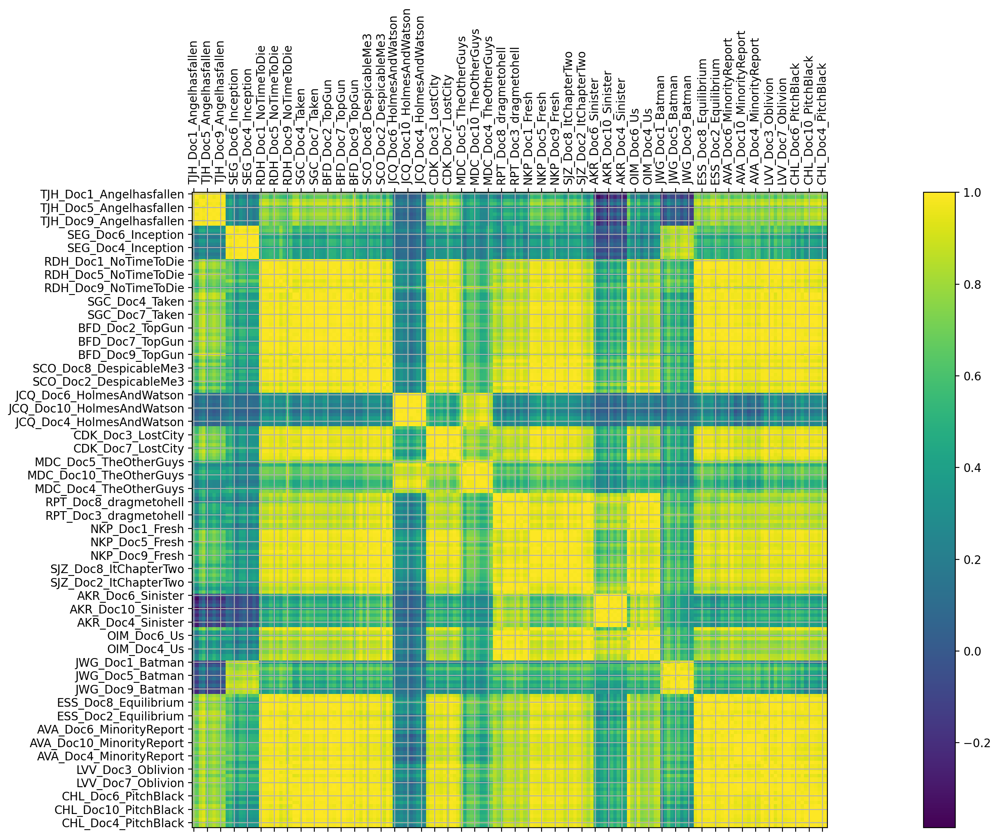

In [219]:
model_4concepts_4words_3=plot_lsa(processed_text_m3, 4, 4)

[(0, '0.205*"charact" + 0.163*"stori" + 0.147*"ferrel" + 0.140*"first" + 0.136*"holm" + 0.124*"watson"'), (1, '0.450*"holm" + 0.407*"watson" + 0.394*"ferrel" + 0.255*"reilli" + 0.238*"comedi" + 0.152*"humor"'), (2, '-0.439*"batman" + -0.377*"nolan" + -0.356*"dream" + -0.318*"incept" + 0.191*"ellison" + 0.126*"horror"'), (3, '0.373*"ellison" + 0.272*"batman" + -0.262*"presid" + -0.259*"fallen" + -0.219*"ban" + 0.200*"famili"')]


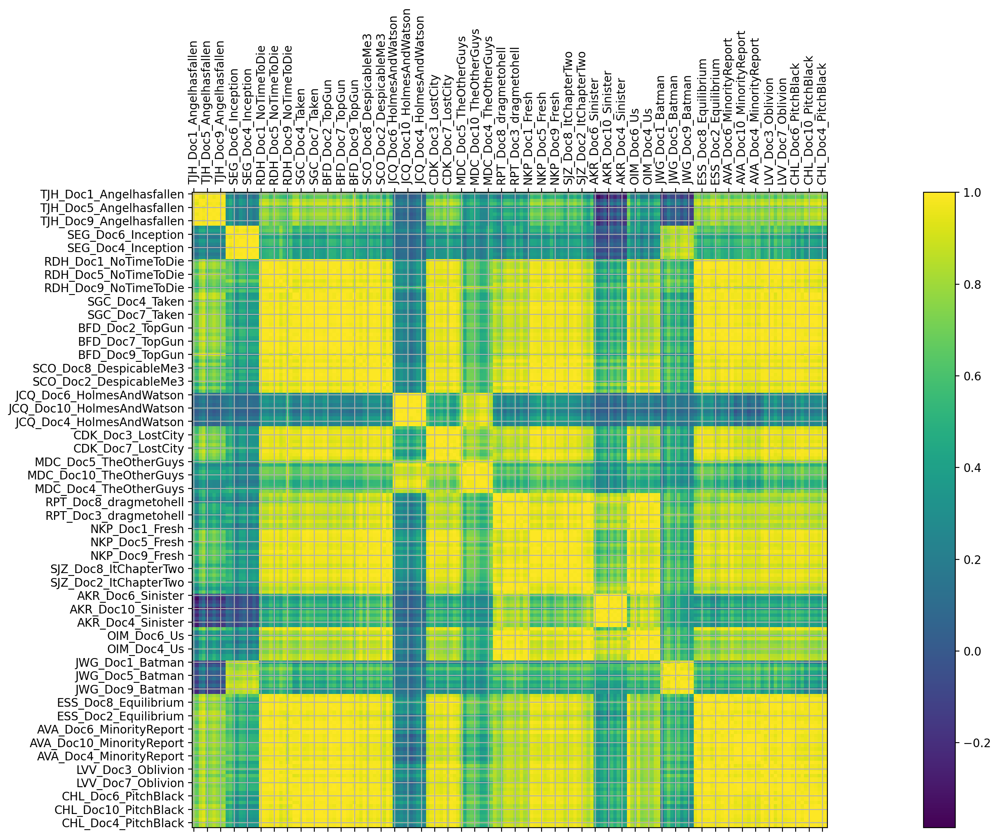

In [220]:
model_4concepts_6words_3=plot_lsa(processed_text_m3, 4, 6)

[(0, '0.205*"charact" + 0.163*"stori" + 0.147*"ferrel" + 0.140*"first" + 0.136*"holm" + 0.124*"watson" + 0.119*"make" + 0.117*"scene"'), (1, '-0.450*"holm" + -0.407*"watson" + -0.394*"ferrel" + -0.255*"reilli" + -0.238*"comedi" + -0.152*"humor" + 0.094*"batman" + -0.091*"laugh"'), (2, '-0.439*"batman" + -0.377*"nolan" + -0.356*"dream" + -0.318*"incept" + 0.191*"ellison" + 0.126*"horror" + -0.116*"reef" + -0.114*"christoph"'), (3, '0.373*"ellison" + 0.272*"batman" + -0.262*"presid" + -0.259*"fallen" + -0.219*"ban" + 0.200*"famili" + 0.193*"horror" + 0.191*"sinist"')]


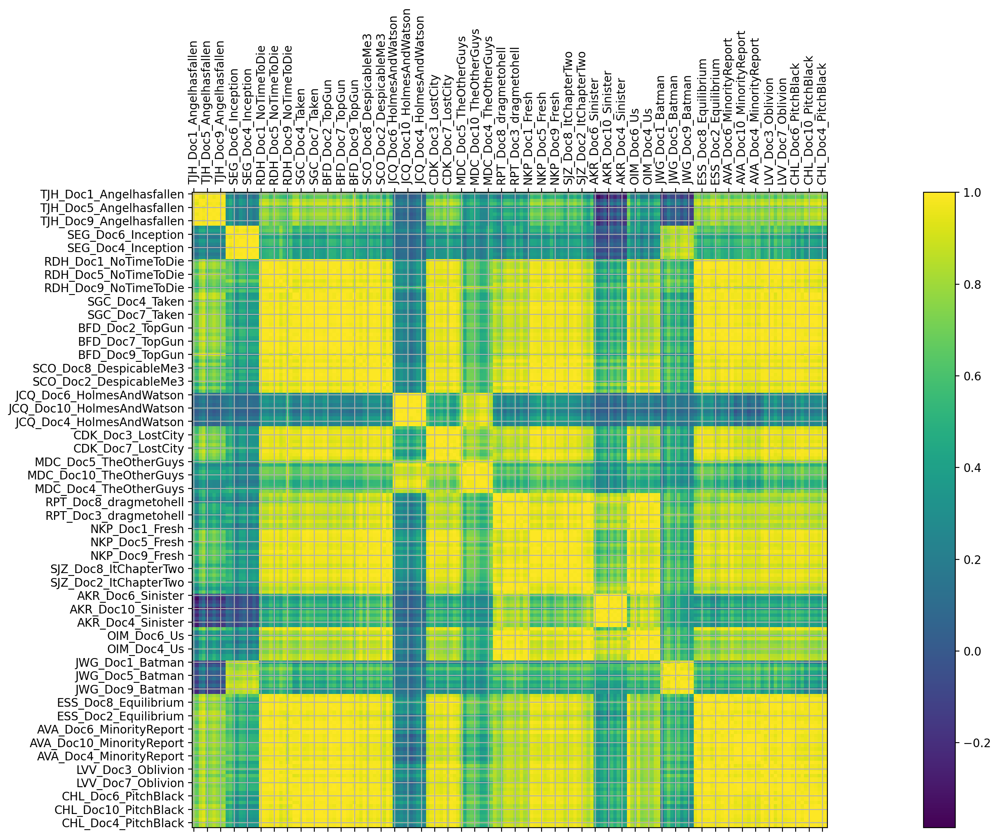

In [221]:
model_4concepts_8words_3=plot_lsa(processed_text_m3, 4, 8)

[(0, '0.205*"charact" + 0.163*"stori" + 0.147*"ferrel" + 0.140*"first" + 0.136*"holm" + 0.124*"watson" + 0.119*"make" + 0.117*"scene" + 0.116*"thing" + 0.112*"play"'), (1, '-0.450*"holm" + -0.407*"watson" + -0.394*"ferrel" + -0.255*"reilli" + -0.238*"comedi" + -0.152*"humor" + 0.094*"batman" + -0.091*"laugh" + -0.083*"joke" + 0.080*"first"'), (2, '0.439*"batman" + 0.377*"nolan" + 0.356*"dream" + 0.318*"incept" + -0.191*"ellison" + -0.126*"horror" + 0.116*"reef" + 0.114*"christoph" + -0.109*"sinist" + -0.103*"famili"'), (3, '-0.373*"ellison" + -0.272*"batman" + 0.262*"presid" + 0.259*"fallen" + 0.219*"ban" + -0.200*"famili" + -0.193*"horror" + -0.191*"sinist" + 0.147*"angel" + -0.125*"hous"')]


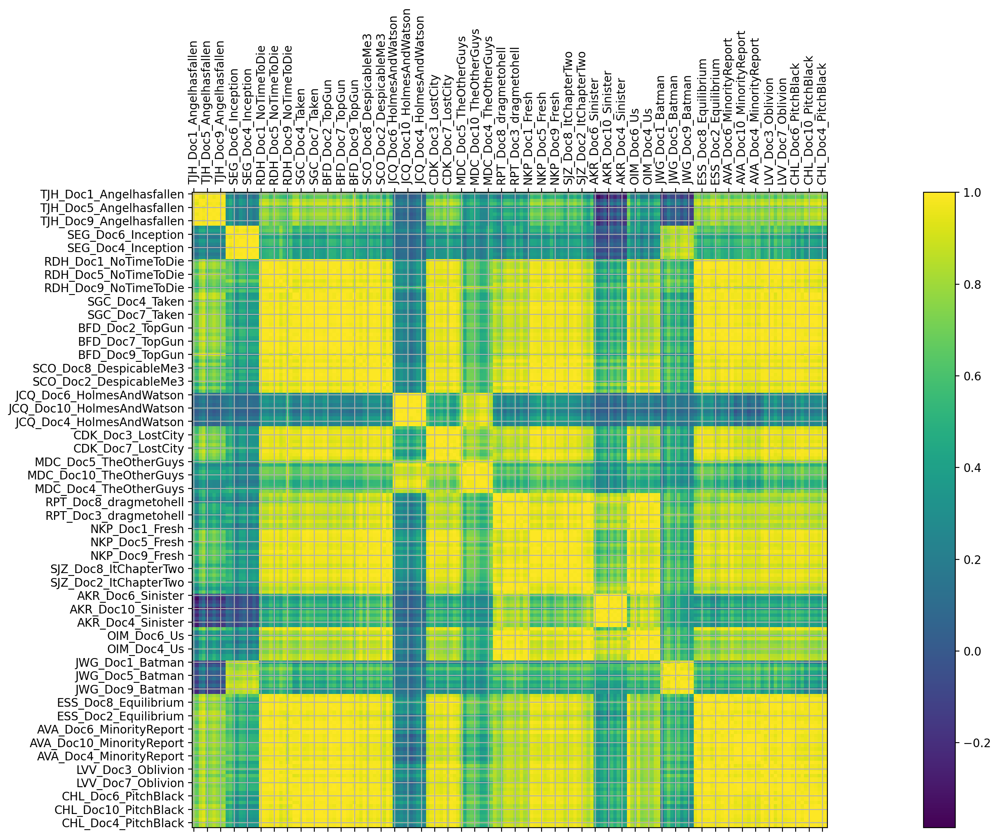

In [222]:
model_4concepts_10words_3=plot_lsa(processed_text_m3, 4, 10)

[(0, '0.205*"charact" + 0.163*"stori" + 0.147*"ferrel" + 0.140*"first" + 0.136*"holm" + 0.124*"watson" + 0.119*"make" + 0.117*"scene" + 0.116*"thing" + 0.112*"play" + 0.105*"action" + 0.104*"comedi" + 0.102*"there" + 0.101*"would" + 0.101*"batman" + 0.095*"feel" + 0.090*"doesnt" + 0.088*"someth" + 0.087*"that" + 0.086*"horror"'), (1, '0.450*"holm" + 0.407*"watson" + 0.394*"ferrel" + 0.255*"reilli" + 0.238*"comedi" + 0.152*"humor" + -0.094*"batman" + 0.091*"laugh" + 0.083*"joke" + -0.080*"first" + -0.072*"dream" + -0.071*"nolan" + 0.070*"sherlock" + 0.069*"involv" + 0.068*"funni" + -0.067*"stori" + -0.067*"ellison" + -0.065*"famili" + -0.063*"horror" + -0.059*"world"'), (2, '0.439*"batman" + 0.377*"nolan" + 0.356*"dream" + 0.318*"incept" + -0.191*"ellison" + -0.126*"horror" + 0.116*"reef" + 0.114*"christoph" + -0.109*"sinist" + -0.103*"famili" + -0.101*"hous" + 0.101*"knight" + 0.082*"within" + 0.078*"stori" + 0.073*"gotham" + -0.066*"first" + 0.064*"dicaprio" + -0.064*"hawk" + 0.061*"p

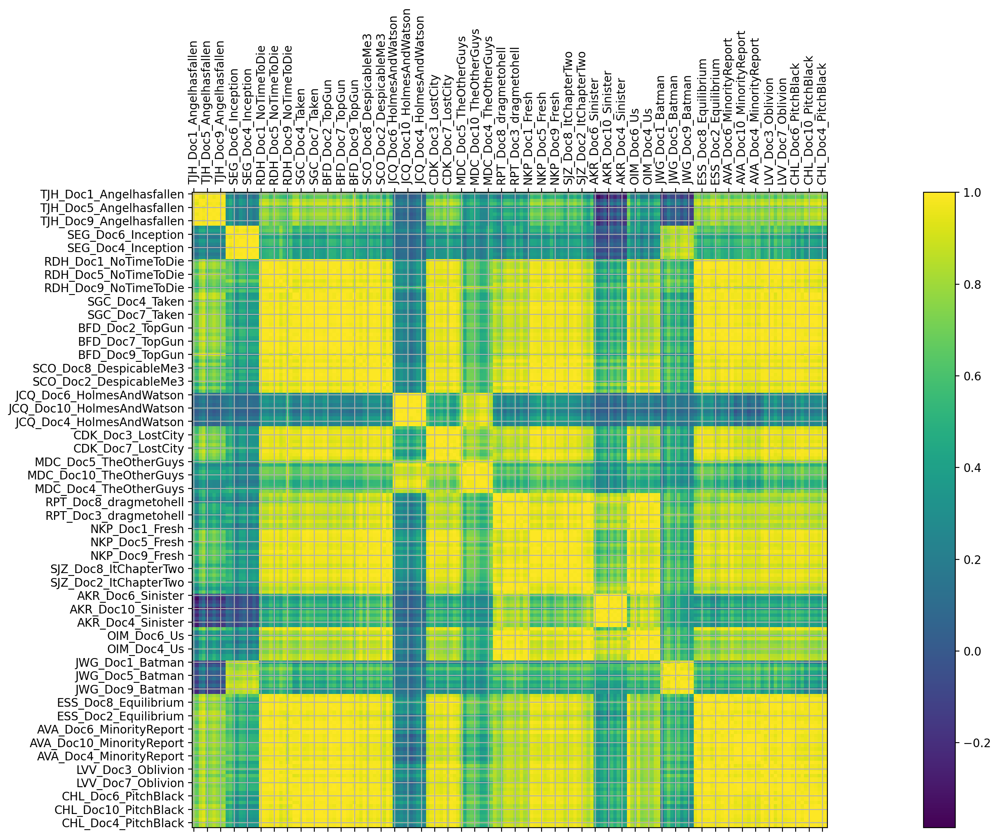

In [223]:
model_4concepts_20words_3=plot_lsa(processed_text_m3, 4, 20)

### 5.1.3 LSA Model Coherence

In [224]:
topics = [4, 8, 10, 14, 18, 20]
coherence_values = []
for t in topics:
    lsamodel,dictionary,index = create_gensim_lsa_model(processed_text_m3,t,10)


    coherence_model_lsa = CoherenceModel(model=lsamodel, dictionary=dictionary, texts=processed_text_m3, coherence='c_v')
    coherence_lsa = coherence_model_lsa.get_coherence()
    coherence_values.append(coherence_lsa)

    
coherence ={'4 concepts 4 words':coherence_values[0],
           '4 concepts 8 words': coherence_values[1],
           '4 concepts 10 words':coherence_values[2],
           '4 concepts 14 words':coherence_values[3],
           '4 concepts 18 words':coherence_values[4],
           '4 concepts 20 words':coherence_values[5],
            }   

print(coherence)

[(0, '0.205*"charact" + 0.163*"stori" + 0.147*"ferrel" + 0.140*"first" + 0.136*"holm" + 0.124*"watson" + 0.119*"make" + 0.117*"scene" + 0.116*"thing" + 0.112*"play"'), (1, '-0.450*"holm" + -0.407*"watson" + -0.394*"ferrel" + -0.255*"reilli" + -0.238*"comedi" + -0.152*"humor" + 0.094*"batman" + -0.091*"laugh" + -0.083*"joke" + 0.080*"first"'), (2, '0.439*"batman" + 0.377*"nolan" + 0.356*"dream" + 0.318*"incept" + -0.191*"ellison" + -0.126*"horror" + 0.116*"reef" + 0.114*"christoph" + -0.109*"sinist" + -0.103*"famili"'), (3, '0.373*"ellison" + 0.272*"batman" + -0.262*"presid" + -0.259*"fallen" + -0.219*"ban" + 0.200*"famili" + 0.193*"horror" + 0.191*"sinist" + -0.147*"angel" + 0.125*"hous"')]


[(0, '-0.205*"charact" + -0.163*"stori" + -0.147*"ferrel" + -0.140*"first" + -0.136*"holm" + -0.124*"watson" + -0.119*"make" + -0.117*"scene" + -0.116*"thing" + -0.112*"play"'), (1, '0.450*"holm" + 0.407*"watson" + 0.394*"ferrel" + 0.255*"reilli" + 0.238*"comedi" + 0.152*"humor" + -0.094*"batman" + 0.091*"laugh" + 0.083*"joke" + -0.080*"first"'), (2, '-0.439*"batman" + -0.377*"nolan" + -0.356*"dream" + -0.318*"incept" + 0.191*"ellison" + 0.126*"horror" + -0.116*"reef" + -0.114*"christoph" + 0.109*"sinist" + 0.103*"famili"'), (3, '-0.373*"ellison" + -0.272*"batman" + 0.262*"presid" + 0.259*"fallen" + 0.219*"ban" + -0.200*"famili" + -0.193*"horror" + -0.191*"sinist" + 0.147*"angel" + -0.125*"hous"'), (4, '0.295*"dream" + -0.227*"batman" + -0.222*"anderton" + 0.214*"incept" + 0.189*"ellison" + 0.188*"nolan" + 0.184*"presid" + 0.176*"fallen" + -0.150*"precrim" + -0.141*"precog"'), (5, '-0.507*"batman" + 0.260*"dream" + 0.216*"incept" + -0.194*"fallen" + -0.192*"presid" + -0.170*"reef" + 0.

[(0, '-0.205*"charact" + -0.163*"stori" + -0.147*"ferrel" + -0.140*"first" + -0.136*"holm" + -0.124*"watson" + -0.119*"make" + -0.117*"scene" + -0.116*"thing" + -0.112*"play"'), (1, '-0.450*"holm" + -0.407*"watson" + -0.394*"ferrel" + -0.255*"reilli" + -0.238*"comedi" + -0.152*"humor" + 0.094*"batman" + -0.091*"laugh" + -0.083*"joke" + 0.080*"first"'), (2, '-0.439*"batman" + -0.377*"nolan" + -0.356*"dream" + -0.318*"incept" + 0.191*"ellison" + 0.126*"horror" + -0.116*"reef" + -0.114*"christoph" + 0.109*"sinist" + 0.103*"famili"'), (3, '-0.373*"ellison" + -0.272*"batman" + 0.262*"presid" + 0.259*"fallen" + 0.219*"ban" + -0.200*"famili" + -0.193*"horror" + -0.191*"sinist" + 0.147*"angel" + -0.125*"hous"'), (4, '-0.295*"dream" + 0.227*"batman" + 0.222*"anderton" + -0.214*"incept" + -0.189*"ellison" + -0.188*"nolan" + -0.184*"presid" + -0.176*"fallen" + 0.150*"precrim" + 0.141*"precog"'), (5, '-0.507*"batman" + 0.260*"dream" + 0.216*"incept" + -0.194*"fallen" + -0.192*"presid" + -0.170*"re

[(0, '-0.205*"charact" + -0.163*"stori" + -0.147*"ferrel" + -0.140*"first" + -0.136*"holm" + -0.124*"watson" + -0.119*"make" + -0.117*"scene" + -0.116*"thing" + -0.112*"play"'), (1, '0.450*"holm" + 0.407*"watson" + 0.394*"ferrel" + 0.255*"reilli" + 0.238*"comedi" + 0.152*"humor" + -0.094*"batman" + 0.091*"laugh" + 0.083*"joke" + -0.080*"first"'), (2, '-0.439*"batman" + -0.377*"nolan" + -0.356*"dream" + -0.318*"incept" + 0.191*"ellison" + 0.126*"horror" + -0.116*"reef" + -0.114*"christoph" + 0.109*"sinist" + 0.103*"famili"'), (3, '-0.373*"ellison" + -0.272*"batman" + 0.262*"presid" + 0.259*"fallen" + 0.219*"ban" + -0.200*"famili" + -0.193*"horror" + -0.191*"sinist" + 0.147*"angel" + -0.125*"hous"'), (4, '0.295*"dream" + -0.227*"batman" + -0.222*"anderton" + 0.214*"incept" + 0.189*"ellison" + 0.188*"nolan" + 0.184*"presid" + 0.176*"fallen" + -0.150*"precrim" + -0.141*"precog"'), (5, '0.507*"batman" + -0.260*"dream" + -0.216*"incept" + 0.194*"fallen" + 0.192*"presid" + 0.170*"reef" + -0.1

[(0, '-0.205*"charact" + -0.163*"stori" + -0.147*"ferrel" + -0.140*"first" + -0.136*"holm" + -0.124*"watson" + -0.119*"make" + -0.117*"scene" + -0.116*"thing" + -0.112*"play"'), (1, '-0.450*"holm" + -0.407*"watson" + -0.394*"ferrel" + -0.255*"reilli" + -0.238*"comedi" + -0.152*"humor" + 0.094*"batman" + -0.091*"laugh" + -0.083*"joke" + 0.080*"first"'), (2, '-0.439*"batman" + -0.377*"nolan" + -0.356*"dream" + -0.318*"incept" + 0.191*"ellison" + 0.126*"horror" + -0.116*"reef" + -0.114*"christoph" + 0.109*"sinist" + 0.103*"famili"'), (3, '0.373*"ellison" + 0.272*"batman" + -0.262*"presid" + -0.259*"fallen" + -0.219*"ban" + 0.200*"famili" + 0.193*"horror" + 0.191*"sinist" + -0.147*"angel" + 0.125*"hous"'), (4, '0.295*"dream" + -0.227*"batman" + -0.222*"anderton" + 0.214*"incept" + 0.189*"ellison" + 0.188*"nolan" + 0.184*"presid" + 0.176*"fallen" + -0.150*"precrim" + -0.141*"precog"'), (5, '-0.507*"batman" + 0.260*"dream" + 0.216*"incept" + -0.194*"fallen" + -0.192*"presid" + -0.170*"reef" 

[(0, '-0.205*"charact" + -0.163*"stori" + -0.147*"ferrel" + -0.140*"first" + -0.136*"holm" + -0.124*"watson" + -0.119*"make" + -0.117*"scene" + -0.116*"thing" + -0.112*"play"'), (1, '-0.450*"holm" + -0.407*"watson" + -0.394*"ferrel" + -0.255*"reilli" + -0.238*"comedi" + -0.152*"humor" + 0.094*"batman" + -0.091*"laugh" + -0.083*"joke" + 0.080*"first"'), (2, '-0.439*"batman" + -0.377*"nolan" + -0.356*"dream" + -0.318*"incept" + 0.191*"ellison" + 0.126*"horror" + -0.116*"reef" + -0.114*"christoph" + 0.109*"sinist" + 0.103*"famili"'), (3, '-0.373*"ellison" + -0.272*"batman" + 0.262*"presid" + 0.259*"fallen" + 0.219*"ban" + -0.200*"famili" + -0.193*"horror" + -0.191*"sinist" + 0.147*"angel" + -0.125*"hous"'), (4, '-0.295*"dream" + 0.227*"batman" + 0.222*"anderton" + -0.214*"incept" + -0.189*"ellison" + -0.188*"nolan" + -0.184*"presid" + -0.176*"fallen" + 0.150*"precrim" + 0.141*"precog"'), (5, '0.507*"batman" + -0.260*"dream" + -0.216*"incept" + 0.194*"fallen" + 0.192*"presid" + 0.170*"reef

## 5.2 LDA

Comparing LDA vs LSA

### 5.2.1 Jumping Straight to Coherence

In [225]:
topics = [4, 8, 10, 14, 18, 20]
coherence_values = []
for t in topics:
    ldamodel,dictionary,index,doctermmatrix = create_gensim_lda_model(processed_text_m3,t,10)


    coherence_model_lda = CoherenceModel(model=ldamodel, dictionary=dictionary, texts=processed_text_m3, coherence='c_v')
    coherence_lda = coherence_model_lda.get_coherence()
    coherence_values.append(coherence_lda)

    
coherence ={'4 concepts 4 words':coherence_values[0],
           '4 concepts 8 words': coherence_values[1],
           '4 concepts 10 words':coherence_values[2],
           '4 concepts 14 words':coherence_values[3],
           '4 concepts 18 words':coherence_values[4],
           '4 concepts 20 words':coherence_values[5],
            }   

print(coherence)

[(0, '0.006*"batman" + 0.005*"charact" + 0.004*"first" + 0.004*"stori" + 0.003*"would" + 0.003*"thing" + 0.003*"emot" + 0.003*"woman" + 0.003*"feel" + 0.002*"maverick"'), (1, '0.010*"holm" + 0.009*"watson" + 0.008*"ferrel" + 0.005*"reilli" + 0.005*"comedi" + 0.004*"charact" + 0.003*"first" + 0.003*"humor" + 0.003*"horror" + 0.003*"make"'), (2, '0.005*"fallen" + 0.004*"presid" + 0.004*"ferrel" + 0.004*"ban" + 0.004*"bryan" + 0.004*"action" + 0.003*"charact" + 0.003*"taken" + 0.003*"angel" + 0.003*"dream"'), (3, '0.004*"stori" + 0.004*"loretta" + 0.004*"charact" + 0.003*"murder" + 0.003*"anderton" + 0.003*"ellison" + 0.003*"action" + 0.003*"thing" + 0.003*"make" + 0.003*"bullock"')]


[(0, '0.007*"batman" + 0.005*"charact" + 0.005*"woman" + 0.004*"feel" + 0.004*"first" + 0.004*"maverick" + 0.004*"thing" + 0.003*"stori" + 0.003*"fresh" + 0.003*"would"'), (1, '0.006*"loser" + 0.005*"equilibrium" + 0.005*"first" + 0.004*"pilot" + 0.004*"scene" + 0.004*"emot" + 0.003*"chapter" + 0.003*"pennywis" + 0.003*"preston" + 0.003*"origin"'), (2, '0.009*"fallen" + 0.008*"presid" + 0.007*"ban" + 0.006*"bryan" + 0.006*"angel" + 0.005*"riddick" + 0.004*"first" + 0.004*"agent" + 0.004*"taken" + 0.004*"action"'), (3, '0.006*"anderton" + 0.006*"stori" + 0.005*"loretta" + 0.004*"charact" + 0.004*"precrim" + 0.004*"action" + 0.004*"murder" + 0.004*"report" + 0.004*"precog" + 0.004*"minor"'), (4, '0.006*"batman" + 0.005*"charact" + 0.005*"first" + 0.005*"stori" + 0.004*"nolan" + 0.004*"human" + 0.004*"would" + 0.003*"realli" + 0.003*"black" + 0.003*"incept"'), (5, '0.012*"dream" + 0.007*"nolan" + 0.006*"peel" + 0.006*"incept" + 0.004*"famili" + 0.003*"that" + 0.003*"play" + 0.003*"stori" 

[(0, '0.008*"batman" + 0.006*"woman" + 0.005*"charact" + 0.004*"first" + 0.004*"feel" + 0.004*"fresh" + 0.004*"thing" + 0.004*"jame" + 0.004*"emot" + 0.003*"stori"'), (1, '0.008*"equilibrium" + 0.006*"loser" + 0.004*"emot" + 0.004*"preston" + 0.004*"wimmer" + 0.004*"horror" + 0.003*"touch" + 0.003*"bratt" + 0.003*"move" + 0.003*"chapter"'), (2, '0.010*"bryan" + 0.010*"fallen" + 0.008*"presid" + 0.008*"ban" + 0.006*"angel" + 0.006*"neeson" + 0.006*"taken" + 0.005*"daughter" + 0.004*"agent" + 0.004*"action"'), (3, '0.007*"stori" + 0.004*"oblivion" + 0.004*"charact" + 0.004*"loretta" + 0.004*"action" + 0.004*"equilibrium" + 0.003*"human" + 0.003*"world" + 0.003*"point" + 0.003*"start"'), (4, '0.005*"batman" + 0.004*"stori" + 0.004*"human" + 0.004*"charact" + 0.004*"would" + 0.004*"happen" + 0.004*"fresh" + 0.004*"emot" + 0.003*"steve" + 0.003*"cruis"'), (5, '0.010*"loretta" + 0.009*"tatum" + 0.009*"bullock" + 0.006*"adventur" + 0.005*"dream" + 0.004*"radcliff" + 0.003*"want" + 0.003*"sand

[(0, '0.007*"charact" + 0.006*"first" + 0.006*"woman" + 0.006*"feel" + 0.005*"emot" + 0.005*"thing" + 0.005*"fresh" + 0.004*"jame" + 0.004*"craig" + 0.004*"batman"'), (1, '0.006*"horror" + 0.004*"bratt" + 0.004*"loser" + 0.003*"voic" + 0.003*"pennywis" + 0.003*"muschietti" + 0.003*"chapter" + 0.003*"truli" + 0.003*"prove" + 0.003*"googl"'), (2, '0.014*"bryan" + 0.009*"neeson" + 0.007*"daughter" + 0.006*"taken" + 0.006*"pari" + 0.004*"everi" + 0.004*"besson" + 0.004*"mill" + 0.004*"fallen" + 0.004*"ban"'), (3, '0.006*"oblivion" + 0.005*"thing" + 0.004*"stori" + 0.004*"precrim" + 0.004*"report" + 0.004*"spielberg" + 0.004*"action" + 0.003*"human" + 0.003*"earth" + 0.003*"minor"'), (4, '0.007*"human" + 0.006*"fresh" + 0.006*"stori" + 0.005*"steve" + 0.004*"emot" + 0.004*"first" + 0.004*"play" + 0.004*"realli" + 0.004*"happen" + 0.004*"charact"'), (5, '0.006*"tatum" + 0.005*"bratt" + 0.004*"want" + 0.004*"bullock" + 0.004*"audienc" + 0.003*"stori" + 0.003*"realli" + 0.003*"comed" + 0.003*"

[(0, '0.007*"charact" + 0.006*"thing" + 0.006*"woman" + 0.006*"first" + 0.005*"feel" + 0.005*"emot" + 0.004*"fresh" + 0.004*"given" + 0.004*"think" + 0.003*"would"'), (1, '0.021*"loser" + 0.020*"pennywis" + 0.020*"chapter" + 0.011*"muschietti" + 0.011*"jame" + 0.011*"horror" + 0.010*"derri" + 0.009*"clown" + 0.007*"king" + 0.007*"hader"'), (2, '0.010*"bryan" + 0.005*"fallen" + 0.005*"ban" + 0.004*"pari" + 0.004*"presid" + 0.004*"first" + 0.004*"thing" + 0.004*"doesnt" + 0.004*"angel" + 0.004*"everi"'), (3, '0.021*"loretta" + 0.014*"bullock" + 0.013*"tatum" + 0.006*"adventur" + 0.006*"radcliff" + 0.005*"chan" + 0.005*"sandra" + 0.005*"romanc" + 0.005*"model" + 0.005*"daniel"'), (4, '0.011*"steve" + 0.008*"fresh" + 0.006*"emot" + 0.006*"first" + 0.006*"woman" + 0.006*"horror" + 0.005*"stori" + 0.005*"would" + 0.005*"edgarjon" + 0.005*"date"'), (5, '0.009*"bratt" + 0.006*"want" + 0.005*"famili" + 0.005*"minion" + 0.005*"brother" + 0.003*"hardli" + 0.003*"everyth" + 0.003*"call" + 0.003*"c

[(0, '0.011*"batman" + 0.007*"charact" + 0.006*"woman" + 0.006*"first" + 0.005*"given" + 0.005*"thing" + 0.005*"fresh" + 0.004*"steve" + 0.004*"sens" + 0.003*"doesnt"'), (1, '0.012*"horror" + 0.009*"ellison" + 0.006*"sinist" + 0.006*"hous" + 0.005*"christin" + 0.005*"doesnt" + 0.004*"becom" + 0.004*"famili" + 0.004*"raimi" + 0.004*"hawk"'), (2, '0.016*"bryan" + 0.008*"neeson" + 0.008*"ban" + 0.007*"fallen" + 0.006*"pari" + 0.006*"daughter" + 0.006*"presid" + 0.005*"taken" + 0.005*"angel" + 0.004*"mill"'), (3, '0.006*"oblivion" + 0.005*"human" + 0.004*"emot" + 0.004*"kosinski" + 0.004*"stori" + 0.004*"start" + 0.004*"charact" + 0.004*"drone" + 0.004*"cruis" + 0.004*"legaci"'), (4, '0.006*"charact" + 0.006*"stori" + 0.006*"happen" + 0.005*"first" + 0.005*"steve" + 0.005*"raimi" + 0.005*"place" + 0.004*"would" + 0.004*"comedi" + 0.004*"realli"'), (5, '0.008*"bratt" + 0.005*"play" + 0.005*"comedi" + 0.004*"famili" + 0.004*"want" + 0.004*"brother" + 0.004*"minion" + 0.004*"seem" + 0.004*"st

[(0, '0.007*"batman" + 0.005*"charact" + 0.005*"woman" + 0.004*"feel" + 0.004*"first" + 0.004*"maverick" + 0.004*"thing" + 0.003*"stori" + 0.003*"fresh" + 0.003*"would"'), (1, '0.006*"loser" + 0.005*"equilibrium" + 0.005*"first" + 0.004*"pilot" + 0.004*"scene" + 0.004*"emot" + 0.003*"chapter" + 0.003*"pennywis" + 0.003*"preston" + 0.003*"origin"'), (2, '0.009*"fallen" + 0.008*"presid" + 0.007*"ban" + 0.006*"bryan" + 0.006*"angel" + 0.005*"riddick" + 0.004*"first" + 0.004*"agent" + 0.004*"taken" + 0.004*"action"'), (3, '0.006*"anderton" + 0.006*"stori" + 0.005*"loretta" + 0.004*"charact" + 0.004*"precrim" + 0.004*"action" + 0.004*"murder" + 0.004*"report" + 0.004*"precog" + 0.004*"minor"'), (4, '0.006*"batman" + 0.005*"charact" + 0.005*"first" + 0.005*"stori" + 0.004*"nolan" + 0.004*"human" + 0.004*"would" + 0.003*"realli" + 0.003*"black" + 0.003*"incept"'), (5, '0.012*"dream" + 0.007*"nolan" + 0.006*"peel" + 0.006*"incept" + 0.004*"famili" + 0.003*"that" + 0.003*"play" + 0.003*"stori" 

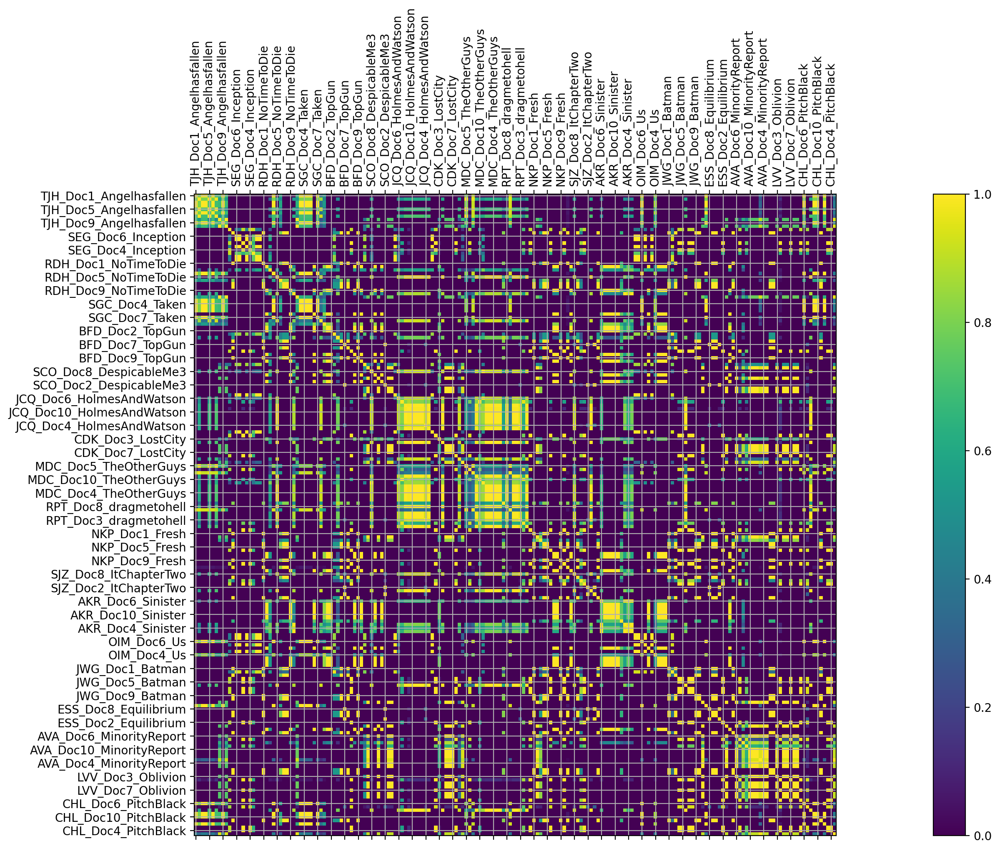

In [237]:
plot_lda(processed_text_m3,8,10)

[(0, '0.007*"charact" + 0.006*"thing" + 0.006*"woman" + 0.006*"first" + 0.005*"feel" + 0.005*"emot" + 0.004*"fresh" + 0.004*"given" + 0.004*"think" + 0.003*"would"'), (1, '0.021*"loser" + 0.020*"pennywis" + 0.020*"chapter" + 0.011*"muschietti" + 0.011*"jame" + 0.011*"horror" + 0.010*"derri" + 0.009*"clown" + 0.007*"king" + 0.007*"hader"'), (2, '0.010*"bryan" + 0.005*"fallen" + 0.005*"ban" + 0.004*"pari" + 0.004*"presid" + 0.004*"first" + 0.004*"thing" + 0.004*"doesnt" + 0.004*"angel" + 0.004*"everi"'), (3, '0.021*"loretta" + 0.014*"bullock" + 0.013*"tatum" + 0.006*"adventur" + 0.006*"radcliff" + 0.005*"chan" + 0.005*"sandra" + 0.005*"romanc" + 0.005*"model" + 0.005*"daniel"'), (4, '0.011*"steve" + 0.008*"fresh" + 0.006*"emot" + 0.006*"first" + 0.006*"woman" + 0.006*"horror" + 0.005*"stori" + 0.005*"would" + 0.005*"edgarjon" + 0.005*"date"'), (5, '0.009*"bratt" + 0.006*"want" + 0.005*"famili" + 0.005*"minion" + 0.005*"brother" + 0.003*"hardli" + 0.003*"everyth" + 0.003*"call" + 0.003*"c

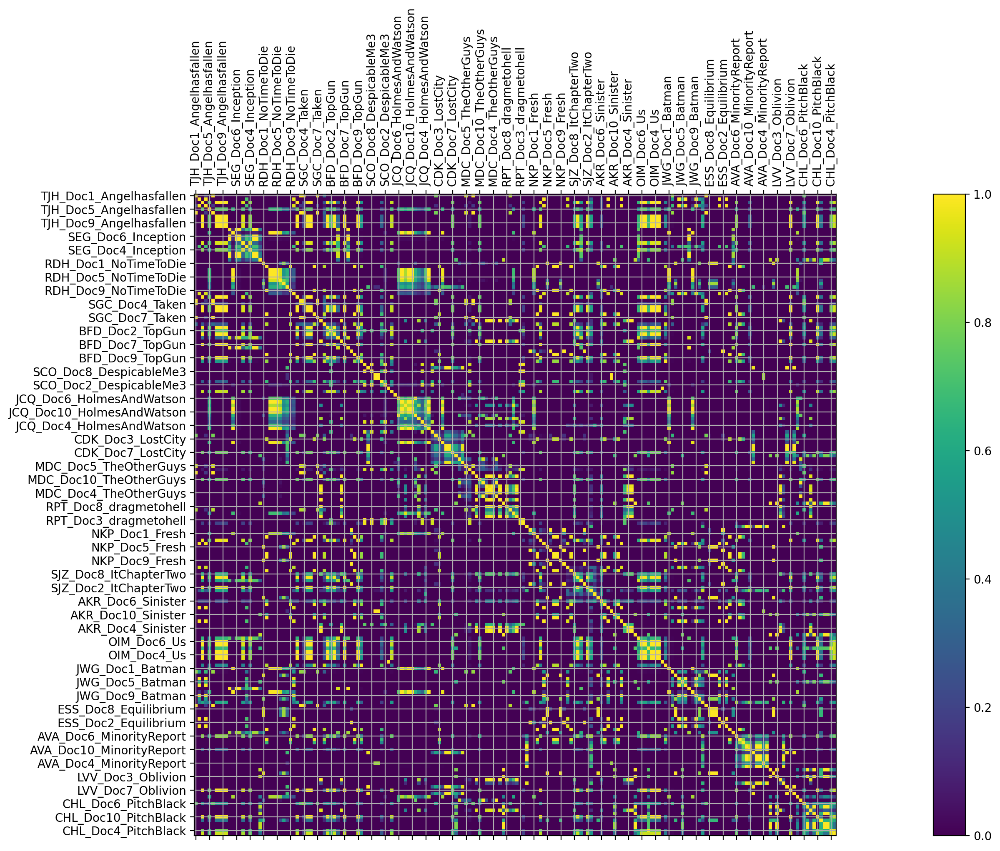

In [239]:
plot_lda(processed_text_m3,18,10)